<a href="https://colab.research.google.com/github/eric6450/2023-scEpieQTL-summer/blob/main/scEpi_eQTL_PBMC2_0_0.ipynb" target="_parent"><img src="https://colab.research.google.com/assets/colab-badge.svg" alt="Open In Colab"/></a>

In [ ]:
from google.colab import drive
drive.mount('/content/drive')

Mounted at /content/drive


In [ ]:
!pip install jedi

     ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 1.6/1.6 MB 7.7 MB/s eta 0:00:00


In [ ]:
!pip install  scvi-colab
from scvi_colab import install

install()

INFO     scvi-colab: Installing scvi-tools.                                                                        
INFO     scvi-colab: Install successful. Testing import.                                                           


/usr/local/lib/python3.10/dist-packages/scvi/_settings.py:63: UserWarning: Since v1.0.0, scvi-tools no longer uses a random seed by default. Run `scvi.settings.seed = 0` to reproduce results from previous versions.
  self.seed = seed
/usr/local/lib/python3.10/dist-packages/scvi/_settings.py:70: UserWarning: Setting `dl_pin_memory_gpu_training` is deprecated in v1.0 and will be removed in v1.1. Please pass in `pin_memory` to the data loaders instead.
  self.dl_pin_memory_gpu_training = (


In [ ]:
!pip install muon

#To use a pre-release version of muon, install it from from the GitHub repository:
#!pip install git+https://github.com/gtca/muon

     ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 292.7/292.7 kB 4.1 MB/s eta 0:00:00


In [ ]:
!pip install pysam

     ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 20.0/20.0 MB 20.2 MB/s eta 0:00:00


In [ ]:
import os
#import h5py
#import scipy
#import seaborn as sns
import anndata as ad
import numpy as np
import scanpy as sc
import pandas as pd
import muon as mu
from muon import MuData
# Import a module with ATAC-seq-related functions
from muon import atac as ac
#from sklearn.preprocessing import StandardScaler
#from sklearn.preprocessing import MinMaxScaler
import scvi; print(scvi.__version__)
import matplotlib.pyplot as plt
from matplotlib.pyplot import rc_context
sc.set_figure_params(dpi=100, figsize=(6, 6), frameon=False)
sc.settings.n_jobs=2
sc.settings.max_memory=5
sc.settings.autoshow=False
#sc.settings.ScanpyConfig(autoshow=False,max_memory=4)

1.0.2


In [ ]:
'''
#@title PBMC10k 1.0.0
!mkdir data
!wget https://cf.10xgenomics.com/samples/cell-arc/1.0.0/pbmc_granulocyte_sorted_10k/pbmc_granulocyte_sorted_10k_filtered_feature_bc_matrix.h5 -O data/pbmc10k_filtered_feature_bc_matrix.h5
!wget https://cf.10xgenomics.com/samples/cell-arc/1.0.0/pbmc_granulocyte_sorted_10k/pbmc_granulocyte_sorted_10k_atac_peaks.bed -O data/peaks.bed
!wget https://cf.10xgenomics.com/samples/cell-arc/1.0.0/pbmc_granulocyte_sorted_10k/pbmc_granulocyte_sorted_10k_atac_fragments.tsv.gz -O data/atac_fragments.tsv.gz
!wget https://cf.10xgenomics.com/samples/cell-arc/1.0.0/pbmc_granulocyte_sorted_10k/pbmc_granulocyte_sorted_10k_atac_peak_annotation.tsv -O data/atac_peak_annotation.tsv
!wget https://cf.10xgenomics.com/samples/cell-arc/1.0.0/pbmc_granulocyte_sorted_10k/pbmc_granulocyte_sorted_10k_atac_fragments.tsv.gz.tbi -O data/atac_fragments.tsv.gz.tbi
!mkdir write
'''

'\n#@title PBMC10k 1.0.0\n!mkdir data\n!wget https://cf.10xgenomics.com/samples/cell-arc/1.0.0/pbmc_granulocyte_sorted_10k/pbmc_granulocyte_sorted_10k_filtered_feature_bc_matrix.h5 -O data/pbmc10k_filtered_feature_bc_matrix.h5\n!wget https://cf.10xgenomics.com/samples/cell-arc/1.0.0/pbmc_granulocyte_sorted_10k/pbmc_granulocyte_sorted_10k_atac_peaks.bed -O data/peaks.bed\n!wget https://cf.10xgenomics.com/samples/cell-arc/1.0.0/pbmc_granulocyte_sorted_10k/pbmc_granulocyte_sorted_10k_atac_fragments.tsv.gz -O data/atac_fragments.tsv.gz\n!wget https://cf.10xgenomics.com/samples/cell-arc/1.0.0/pbmc_granulocyte_sorted_10k/pbmc_granulocyte_sorted_10k_atac_peak_annotation.tsv -O data/atac_peak_annotation.tsv\n!wget https://cf.10xgenomics.com/samples/cell-arc/1.0.0/pbmc_granulocyte_sorted_10k/pbmc_granulocyte_sorted_10k_atac_fragments.tsv.gz.tbi -O data/atac_fragments.tsv.gz.tbi\n!mkdir write\n'

In [ ]:
#@title PBMC10k 2.0.0
!mkdir data
!wget https://cf.10xgenomics.com/samples/cell-arc/2.0.0/pbmc_granulocyte_sorted_10k/pbmc_granulocyte_sorted_10k_filtered_feature_bc_matrix.h5 -O data/pbmc10k_filtered_feature_bc_matrix.h5
!wget https://cf.10xgenomics.com/samples/cell-arc/2.0.0/pbmc_granulocyte_sorted_10k/pbmc_granulocyte_sorted_10k_atac_peaks.bed -O data/peaks.bed
!wget https://cf.10xgenomics.com/samples/cell-arc/2.0.0/pbmc_granulocyte_sorted_10k/pbmc_granulocyte_sorted_10k_atac_fragments.tsv.gz -O data/atac_fragments.tsv.gz
!wget https://cf.10xgenomics.com/samples/cell-arc/2.0.0/pbmc_granulocyte_sorted_10k/pbmc_granulocyte_sorted_10k_atac_peak_annotation.tsv -O data/atac_peak_annotation.tsv
!wget https://cf.10xgenomics.com/samples/cell-arc/2.0.0/pbmc_granulocyte_sorted_10k/pbmc_granulocyte_sorted_10k_atac_fragments.tsv.gz.tbi -O data/atac_fragments.tsv.gz.tbi
!mkdir write

--2023-08-10 00:41:44--  https://cf.10xgenomics.com/samples/cell-arc/2.0.0/pbmc_granulocyte_sorted_10k/pbmc_granulocyte_sorted_10k_filtered_feature_bc_matrix.h5
Resolving cf.10xgenomics.com (cf.10xgenomics.com)... 104.18.1.173, 104.18.0.173, 2606:4700::6812:1ad, ...
Connecting to cf.10xgenomics.com (cf.10xgenomics.com)|104.18.1.173|:443... connected.
HTTP request sent, awaiting response... 200 OK
Length: 192125528 (183M) [binary/octet-stream]
Saving to: ‘data/pbmc10k_filtered_feature_bc_matrix.h5’

data/pbmc10k_filter 100%[===================>] 183.22M  14.4MB/s    in 14s     

2023-08-10 00:41:58 (13.6 MB/s) - ‘data/pbmc10k_filtered_feature_bc_matrix.h5’ saved [192125528/192125528]

--2023-08-10 00:41:58--  https://cf.10xgenomics.com/samples/cell-arc/2.0.0/pbmc_granulocyte_sorted_10k/pbmc_granulocyte_sorted_10k_atac_peaks.bed
Resolving cf.10xgenomics.com (cf.10xgenomics.com)... 104.18.1.173, 104.18.0.173, 2606:4700::6812:1ad, ...
Connecting to cf.10xgenomics.com (cf.10xgenomics.com)|1

In [ ]:
results_file = 'write/pbmc10k.h5ad'  # the file that will store the analysis results

In [ ]:
peak = pd.read_csv('data/peaks.bed', sep='\t', names=['chr','start','end'], comment="#")
peak

,chr,start,end
0,chr1,9790,10675
1,chr1,180599,181702
2,chr1,191168,192093
3,chr1,267565,268455
4,chr1,270876,271770
...,...,...,...
143882,KI270713.1,21434,22340
143883,KI270713.1,26201,26826
143884,KI270713.1,29624,30457
143885,KI270713.1,31340,32243


In [ ]:
mdata = mu.read_10x_h5('/content/data/pbmc10k_filtered_feature_bc_matrix.h5') #, gex_only=False)

/usr/local/lib/python3.10/dist-packages/anndata/_core/anndata.py:1840: UserWarning: Variable names are not unique. To make them unique, call `.var_names_make_unique`.
  utils.warn_names_duplicates("var")


Added `interval` annotation for features from /content/data/pbmc10k_filtered_feature_bc_matrix.h5


/usr/local/lib/python3.10/dist-packages/anndata/_core/anndata.py:1840: UserWarning: Variable names are not unique. To make them unique, call `.var_names_make_unique`.
  utils.warn_names_duplicates("var")
/usr/local/lib/python3.10/dist-packages/mudata/_core/mudata.py:479: UserWarning: var_names are not unique. To make them unique, call `.var_names_make_unique`.
  warnings.warn(


Added peak annotation from /content/data/atac_peak_annotation.tsv to .uns['atac']['peak_annotation']
Added gene names to peak annotation in .uns['atac']['peak_annotation']
Located fragments file: /content/data/atac_fragments.tsv.gz


In [ ]:
mdata

MuData object with n_obs × n_vars = 11898 × 180488
  var:	'gene_ids', 'feature_types', 'genome', 'interval'
  2 modalities
    rna:	11898 x 36601
      var:	'gene_ids', 'feature_types', 'genome', 'interval'
    atac:	11898 x 143887
      var:	'gene_ids', 'feature_types', 'genome', 'interval'
      uns:	'atac', 'files'

In [ ]:
mdata.mod['atac'].uns

OrderedDict([('atac',
              {'peak_annotation':                                peak  distance peak_type
               gene_name                                              
               MIR1302-2HG         chr1:9790-10675    -18879    distal
               AL627309.5       chr1:180599-181702     -6738    distal
               AL627309.5       chr1:191168-192093    -17307    distal
               AP006222.2       chr1:267565-268455       711    distal
               AP006222.2       chr1:270876-271770      4022    distal
               ...                             ...       ...       ...
               AC213203.2   KI270713.1:21434-22340     10188    distal
               AC213203.2   KI270713.1:26201-26826      5702    distal
               AC213203.2   KI270713.1:29624-30457      2071    distal
               AC213203.2   KI270713.1:31340-32243       285    distal
               AC213203.1   KI270713.1:36927-37836      1521    distal
               
               [1832

In [ ]:
mdata.var_names_make_unique()
mdata

MuData object with n_obs × n_vars = 11898 × 180488
  var:	'gene_ids', 'feature_types', 'genome', 'interval'
  2 modalities
    rna:	11898 x 36601
      var:	'gene_ids', 'feature_types', 'genome', 'interval'
    atac:	11898 x 143887
      var:	'gene_ids', 'feature_types', 'genome', 'interval'
      uns:	'atac', 'files'

In [ ]:
#ad = sc.read_10x_h5('/content/data/pbmc10k_filtered_feature_bc_matrix.h5', gex_only=False)
#ad

In [ ]:
ad_rna = mdata.mod['rna']
ad_atac = mdata.mod['atac']
#rna

In [ ]:
#ad_rna = ad[:, ad.var['feature_types']=='Gene Expression']
#ad_atac = ad[:, ad.var['feature_types']=='Peaks']

In [ ]:
ad_rna

AnnData object with n_obs × n_vars = 11898 × 36601
    var: 'gene_ids', 'feature_types', 'genome', 'interval'

In [ ]:
ad_atac

AnnData object with n_obs × n_vars = 11898 × 143887
    var: 'gene_ids', 'feature_types', 'genome', 'interval'
    uns: 'atac', 'files'

## 讀入Gene ID

In [ ]:
all762eqtl_ID=np.load('/content/drive/MyDrive/scEpieQTL/all762eqtl_ID.npy') #沒有附gene的eQTL

In [ ]:
all762eqtl_ID.shape

(786,)

In [ ]:
#all762eqtl_ID

In [ ]:
all762eqtl_geneID=np.load('/content/drive/MyDrive/scEpieQTL/786_peak_id_gene_name.npy') #有附gene的eQTL

In [ ]:
all762eqtl_geneID.shape

(786,)

In [ ]:
#all762eqtl_geneID #有附gene的eQTL

In [ ]:
eqtl368_geneID0719=np.load('/content/drive/MyDrive/scEpieQTL/all_368eqtlID_gane_name.npy') #0719找出的368個eQTL

In [ ]:
eqtl368_geneID0719.shape

(368,)

In [ ]:
#eqtl368_geneID0719

## 讀入預測的gene expression(差值:alt-ref)
找出標準差

做Normalize

存到obs中

In [ ]:
all368eqtl_gexdiff0721=np.load('/content/drive/MyDrive/scEpieQTL/基因表現差值的all_368eqtl_gexdiff0721.npy') #基因表現差值的368x11898 npy檔

In [ ]:
all368eqtl_gexdiff0721.shape

(368, 11898)

In [ ]:
all368eqtl_gexdiff0721

array([[ 0.        , -0.00205749, -0.00064313, ...,  0.03881747,
         0.        , -0.00147051],
       [ 0.00121405,  0.        ,  0.00375967, ...,  0.        ,
         0.        ,  0.0047045 ],
       [ 0.00263033, -0.00385789,  0.        , ...,  0.        ,
         0.0006361 , -0.00012213],
       ...,
       [ 0.        ,  0.        ,  0.00193259, ..., -0.00243324,
         0.        ,  0.        ],
       [ 0.        ,  0.        ,  0.        , ...,  0.        ,
         0.        ,  0.        ],
       [ 0.        ,  0.        ,  0.        , ...,  0.        ,
         0.        ,  0.        ]], dtype=float32)

In [ ]:
# 每一列除以该列的最大绝对值
max_abs_vals = np.max(np.abs(all368eqtl_gexdiff0721.T), axis=0) # 将行和列交换，使用numpy.transpose()方法或是.T
normalized_data = all368eqtl_gexdiff0721.T / max_abs_vals

In [ ]:
#max_abs_vals

In [ ]:
normalized_data.shape

(11898, 368)

In [ ]:
all368eqtl_gexdiff0721=normalized_data.T

In [ ]:
all368eqtl_gexdiff0721.shape

(368, 11898)

In [ ]:
all368eqtl_gexdiff0721

array([[ 0.        , -0.02671906, -0.00835188, ...,  0.50409234,
         0.        , -0.01909632],
       [ 0.0445115 ,  0.        ,  0.13784343, ...,  0.        ,
         0.        ,  0.17248408],
       [ 0.07103413, -0.10418528,  0.        , ...,  0.        ,
         0.01717845, -0.00329831],
       ...,
       [ 0.        ,  0.        ,  0.01716564, ..., -0.0216125 ,
         0.        ,  0.        ],
       [ 0.        ,  0.        ,  0.        , ...,  0.        ,
         0.        ,  0.        ],
       [ 0.        ,  0.        ,  0.        , ...,  0.        ,
         0.        ,  0.        ]], dtype=float32)

In [ ]:
for i in range(0,368):
  #ad_rna.obs[f"all368eqtl_gexdiff0721_{i:d}"] = pd.Categorical(all368eqtl_gexdiff0721[i,:])
  ad_rna.obs[f"all368eqtl_gexdiff0721_{i:d}"] = all368eqtl_gexdiff0721[i,:]
  ad_atac.obs[f"all368eqtl_gexdiff0721_{i:d}"] = all368eqtl_gexdiff0721[i,:]

<ipython-input-38-13bfcccbf5b3>:3: PerformanceWarning: DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at once using pd.concat(axis=1) instead. To get a de-fragmented frame, use `newframe = frame.copy()`
  ad_rna.obs[f"all368eqtl_gexdiff0721_{i:d}"] = all368eqtl_gexdiff0721[i,:]
<ipython-input-38-13bfcccbf5b3>:4: PerformanceWarning: DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at once using pd.concat(axis=1) instead. To get a de-fragmented frame, use `newframe = frame.copy()`
  ad_atac.obs[f"all368eqtl_gexdiff0721_{i:d}"] = all368eqtl_gexdiff0721[i,:]
<ipython-input-38-13bfcccbf5b3>:3: PerformanceWarning: DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at once usin

In [ ]:
all368eqtl_gexdiff = pd.DataFrame(np.load('/content/drive/MyDrive/scEpieQTL/基因表現差值的all_368eqtl_gexdiff0721.npy'))

In [ ]:
all368eqtl_gexdiff.T.describe()

,0,1,2,3,4,5,6,7,8,9,...,358,359,360,361,362,363,364,365,366,367
count,11898.000000,11898.000000,11898.000000,11898.000000,11898.000000,11898.000000,11898.000000,11898.000000,11898.000000,11898.000000,...,11898.000000,11898.000000,11898.000000,11898.000000,11898.000000,11898.000000,11898.000000,11898.000000,11898.000000,11898.000000
mean,0.000978,0.000370,-0.000469,-0.000341,0.000982,0.000014,0.001070,0.000075,0.000931,-0.000028,...,-0.000107,0.001024,-0.000373,-0.000164,-0.000110,0.000663,-0.000093,0.002518,-0.000036,-0.000131
std,0.005473,0.003307,0.003973,0.004112,0.006512,0.001868,0.005216,0.001434,0.004840,0.002153,...,0.006071,0.006633,0.002771,0.004677,0.004211,0.006166,0.008315,0.008780,0.002392,0.002696
min,-0.027217,-0.026448,-0.037029,-0.036441,-0.036482,-0.014943,-0.029633,-0.019692,-0.031178,-0.031728,...,-0.063854,-0.053771,-0.057910,-0.031095,-0.031166,-0.104724,-0.093591,-0.056986,-0.053373,-0.037256
25%,0.000000,0.000000,-0.001509,0.000000,-0.001204,0.000000,0.000000,0.000000,0.000000,0.000000,...,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000
50%,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,...,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000
75%,0.000000,0.000000,0.000425,0.000000,0.003492,0.000000,0.000000,0.000000,0.001940,0.000000,...,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.001999,0.000000,0.000000
max,0.077005,0.027275,0.025345,0.036453,0.049568,0.021453,0.061014,0.021531,0.050083,0.027508,...,0.050892,0.116849,0.038005,0.038584,0.025766,0.123096,0.077229,0.112585,0.041484,0.025450


In [ ]:
all368eqtl_gexdiff_std = all368eqtl_gexdiff.T.describe().loc['std']

In [ ]:
all368eqtl_gexdiff_std

0      0.005473
1      0.003307
2      0.003973
3      0.004112
4      0.006512
         ...   
363    0.006166
364    0.008315
365    0.008780
366    0.002392
367    0.002696
Name: std, Length: 368, dtype: float64

## 載入eQTL檔案  ##

In [ ]:
# 文策提供的125 eqtl 分群 cluster0-5 2023/08/3
# 讀取CSV文件並儲存為DataFrame
data_frame = pd.read_csv('/content/drive/MyDrive/scEpieQTL/125_eqtl_cell_gmm_cluster_labels_0803.csv')

# 文策提供的125 eqtl 分群 cluster0-5 2023/08/1
# 讀取CSV文件並儲存為DataFrame
#data_frame = pd.read_csv('/content/drive/MyDrive/scEpieQTL/125_eqtl_cell_gmm_cluster_labels_0801.csv')

# 文策提供的125 eqtl 分群 cluster0-3 2023/07/27
# 讀取CSV文件並儲存為DataFrame
#data_frame = pd.read_csv('/content/drive/MyDrive/scEpieQTL/125_eqtl_cell_gmm_cluster_labels.csv')

# 去掉索引列，使用reset_index()方法，并指定drop=True
#data_frame = data_frame.reset_index(drop=True)

#指定要读取的列，去掉第一欄
data_frame.drop('Unnamed: 0', axis=1, inplace=True)

# 将行和列交换，使用transpose()方法
data_frame_transposed = data_frame.transpose()

# 将DataFrame转换为NumPy数组
data_array = data_frame_transposed.to_numpy()

# 在google drive儲存NumPy array為.npy檔
#np.save('/content/drive/MyDrive/scEpieQTL/125_eqtl_cell_gmm_cluster_labels.npy', data_array)

In [ ]:
#top125_eqtl=np.load('/content/drive/MyDrive/scEpieQTL/125_eqtl_cell_gmm_cluster_labels.npy',allow_pickle=True)
top125_eqtl=data_array

In [ ]:
top125_eqtl.shape

(125, 11898)

In [ ]:
top125_eqtl

array([[1, 1, 1, ..., 2, 1, 1],
       [0, 0, 0, ..., 0, 0, 0],
       [2, 2, 2, ..., 2, 2, 2],
       ...,
       [0, 0, 0, ..., 0, 0, 0],
       [0, 0, 0, ..., 1, 0, 0],
       [1, 0, 1, ..., 0, 0, 0]])

In [ ]:
for i in range(0,125):
  ad_rna.obs[f"top125_eqtl_{i:d}"] = pd.Categorical(top125_eqtl[i,:])
  ad_atac.obs[f"top125_eqtl_{i:d}"] = pd.Categorical(top125_eqtl[i,:])

<ipython-input-47-35ee84f5a783>:2: PerformanceWarning: DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at once using pd.concat(axis=1) instead. To get a de-fragmented frame, use `newframe = frame.copy()`
  ad_rna.obs[f"top125_eqtl_{i:d}"] = pd.Categorical(top125_eqtl[i,:])
<ipython-input-47-35ee84f5a783>:3: PerformanceWarning: DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at once using pd.concat(axis=1) instead. To get a de-fragmented frame, use `newframe = frame.copy()`
  ad_atac.obs[f"top125_eqtl_{i:d}"] = pd.Categorical(top125_eqtl[i,:])
<ipython-input-47-35ee84f5a783>:2: PerformanceWarning: DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at once using pd.concat(

In [ ]:
top125_eqtl_ID=data_frame_transposed.index.to_numpy()

In [ ]:
#top125_eqtl_ID

## 附上ID的 scBasset predicition 存成 pandas df
 讀取
df =  pd.read_pickle('whole_blood_eqtl_.scbasset.seqs_762.pandas.pickle')

 讀取完的 dataframe index 為 對應序列 ID

 因為有 REF 和 ALT 所以會每兩行 index 一樣

 順序是先 REF 再 ALT


 可以轉成 numpy array

arr = from_df.to_numpy()

In [ ]:
dfsb=pd.read_pickle('/content/drive/MyDrive/scEpieQTL/whole_blood_eqtl_.scbasset.seqs_762.pandas.pickle')

In [ ]:
dfsb

,0,1,2,3,4,5,6,7,8,9,...,11888,11889,11890,11891,11892,11893,11894,11895,11896,11897
positive_chr10_49194771_A_C_b38,0.172912,0.197856,0.232105,0.297045,0.279552,0.194485,0.202001,0.186701,0.282899,0.198879,...,0.271926,0.250197,0.199982,0.270324,0.199474,0.271534,0.409513,0.252569,0.147395,0.246540
positive_chr10_49194771_A_C_b38,0.169974,0.201587,0.230373,0.298025,0.279494,0.193604,0.200228,0.192902,0.285156,0.197406,...,0.277203,0.253082,0.198678,0.278298,0.197274,0.267660,0.400285,0.251530,0.148925,0.247344
positive_chr10_80535642_G_A_b38,0.576667,0.497589,0.562074,0.523961,0.534639,0.557973,0.537687,0.511643,0.641692,0.535048,...,0.647022,0.633509,0.466917,0.534129,0.555312,0.548958,0.514299,0.491518,0.519260,0.512547
positive_chr10_80535642_G_A_b38,0.563081,0.505385,0.553302,0.519856,0.529190,0.551739,0.533581,0.517790,0.638814,0.525255,...,0.644119,0.631680,0.478043,0.540383,0.543578,0.540765,0.522099,0.501799,0.522430,0.520043
positive_chr19_57500079_C_T_b38,0.825650,0.786328,0.754491,0.707921,0.770877,0.771113,0.811480,0.762646,0.474100,0.783935,...,0.440752,0.456326,0.703580,0.640198,0.791125,0.773886,0.735899,0.710037,0.774297,0.797132
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
positive_chr19_51407725_T_C_b38,0.013965,0.043403,0.035122,0.042001,0.026185,0.024381,0.019952,0.058763,0.610518,0.019513,...,0.594601,0.546926,0.113269,0.394423,0.018484,0.022178,0.113938,0.069658,0.064605,0.033236
positive_chr10_45727041_C_G_b38,0.344268,0.414457,0.388823,0.414235,0.406630,0.388167,0.376414,0.396966,0.409904,0.384150,...,0.427242,0.442949,0.434827,0.446974,0.378005,0.385106,0.424859,0.434627,0.418065,0.393000
positive_chr10_45727041_C_G_b38,0.346767,0.400810,0.390758,0.417772,0.406492,0.389125,0.372213,0.383206,0.436361,0.386262,...,0.439970,0.452507,0.442725,0.450105,0.379933,0.386237,0.427521,0.416954,0.406324,0.377742
positive_chr10_75381106_A_G_b38,0.036931,0.042067,0.065649,0.114583,0.055058,0.048625,0.038018,0.054197,0.520422,0.054060,...,0.526230,0.492383,0.099613,0.405161,0.044551,0.056037,0.061328,0.064630,0.057360,0.029443


In [ ]:
sb1572_index=dfsb.index.to_numpy()

In [ ]:
sb786_index = np.empty(len(sb1572_index)//2, dtype=sb1572_index.dtype)
for i in range(0,1572):
  k=i//2
  sb786_index[k]=sb1572_index[i]
  i+=1

In [ ]:
Peak762_index = np.array([item.split('_', 1)[1] for item in sb786_index])

In [ ]:
Peak762_index.shape

(786,)

In [ ]:

sb1572 = dfsb.to_numpy()
#sb786 = np.round(sb786/(sb786.max()/22))
#sb786 = sb786.astype(np.int8)
#附上ID的 scBasset predicition


In [ ]:
sb1572.shape

(1572, 11898)

In [ ]:
sb786 = np.empty(len(sb1572_index)//2, dtype=sb1572.dtype)
sb786 = sb1572[1::2] - sb1572[::2]

In [ ]:
sb786.shape

(786, 11898)

In [ ]:
for i in range(0,786):
  #ad_rna.obs[f"Peak762_{i:d}"] = pd.Categorical(sb786[i,:])
  #ad_atac.obs[f"Peak762_{i:d}"] = pd.Categorical(sb786[i,:])
  ad_rna.obs[f"Peak762_{i:d}"] = sb786[i,:]
  ad_atac.obs[f"Peak762_{i:d}"] = sb786[i,:]

<ipython-input-60-2bfbf0238e63>:4: PerformanceWarning: DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at once using pd.concat(axis=1) instead. To get a de-fragmented frame, use `newframe = frame.copy()`
  ad_rna.obs[f"Peak762_{i:d}"] = sb786[i,:]
<ipython-input-60-2bfbf0238e63>:5: PerformanceWarning: DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at once using pd.concat(axis=1) instead. To get a de-fragmented frame, use `newframe = frame.copy()`
  ad_atac.obs[f"Peak762_{i:d}"] = sb786[i,:]
<ipython-input-60-2bfbf0238e63>:4: PerformanceWarning: DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at once using pd.concat(axis=1) instead. To get a de-fragmented frame, use `

## Preprocess AnnData
ad = 11898 cells × 180488 genes＋atacs

ad_rna = 11898 cells × 36601 genes

ad_atac = 11898 cells × 143887 atacs

In [ ]:
#ad
# AnnData object with n_obs × n_vars = 11898 × 180488
# var: 'gene_ids', 'feature_types', 'genome'

In [ ]:
#ad_rna
# AnnData object with n_obs × n_vars = 11898 × 36601
'''
obs: 'all_368eqtl_gexdiff0801_367', 'top125_eqtl_124',
var: 'gene_ids', 'feature_types', 'genome'
'''

"\nobs: 'all_368eqtl_gexdiff0801_367', 'top125_eqtl_124',\nvar: 'gene_ids', 'feature_types', 'genome'\n"

In [ ]:
#ad_atac
# AnnData object with n_obs × n_vars = 11898 × 143887
# var: 'gene_ids', 'feature_types', 'genome'

In [ ]:
mdata

MuData object with n_obs × n_vars = 11898 × 180488
  var:	'gene_ids', 'feature_types', 'genome', 'interval'
  2 modalities
    rna:	11898 x 36601
      obs:	'all368eqtl_gexdiff0721_0', 'all368eqtl_gexdiff0721_1', 'all368eqtl_gexdiff0721_2', 'all368eqtl_gexdiff0721_3', 'all368eqtl_gexdiff0721_4', 'all368eqtl_gexdiff0721_5', 'all368eqtl_gexdiff0721_6', 'all368eqtl_gexdiff0721_7', 'all368eqtl_gexdiff0721_8', 'all368eqtl_gexdiff0721_9', 'all368eqtl_gexdiff0721_10', 'all368eqtl_gexdiff0721_11', 'all368eqtl_gexdiff0721_12', 'all368eqtl_gexdiff0721_13', 'all368eqtl_gexdiff0721_14', 'all368eqtl_gexdiff0721_15', 'all368eqtl_gexdiff0721_16', 'all368eqtl_gexdiff0721_17', 'all368eqtl_gexdiff0721_18', 'all368eqtl_gexdiff0721_19', 'all368eqtl_gexdiff0721_20', 'all368eqtl_gexdiff0721_21', 'all368eqtl_gexdiff0721_22', 'all368eqtl_gexdiff0721_23', 'all368eqtl_gexdiff0721_24', 'all368eqtl_gexdiff0721_25', 'all368eqtl_gexdiff0721_26', 'all368eqtl_gexdiff0721_27', 'all368eqtl_gexdiff0721_28', 'all368eqtl_gexdiff0721_29', 'all368eqtl_gexdiff0721_30', 'all368eqtl_gexdiff0721_31', 'all368eqtl_gexdiff0721_32', 'all368eqtl_gexdiff0721_33', 'all368eqtl_gexdiff0721_34', 'all368eqtl_gexdiff0721_35', 'all368eqtl_gexdiff0721_36', 'all368eqtl_gexdiff0721_37', 'all368eqtl_gexdiff0721_38', 'all368eqtl_gexdiff0721_39', 'all368eqtl_gexdiff0721_40', 'all368eqtl_gexdiff0721_41', 'all368eqtl_gexdiff0721_42', 'all368eqtl_gexdiff0721_43', 'all368eqtl_gexdiff0721_44', 'all368eqtl_gexdiff0721_45', 'all368eqtl_gexdiff0721_46', 'all368eqtl_gexdiff0721_47', 'all368eqtl_gexdiff0721_48', 'all368eqtl_gexdiff0721_49', 'all368eqtl_gexdiff0721_50', 'all368eqtl_gexdiff0721_51', 'all368eqtl_gexdiff0721_52', 'all368eqtl_gexdiff0721_53', 'all368eqtl_gexdiff0721_54', 'all368eqtl_gexdiff0721_55', 'all368eqtl_gexdiff0721_56', 'all368eqtl_gexdiff0721_57', 'all368eqtl_gexdiff0721_58', 'all368eqtl_gexdiff0721_59', 'all368eqtl_gexdiff0721_60', 'all368eqtl_gexdiff0721_61', 'all368eqtl_gexdiff0721_62', 'all368eqtl_gexdiff0721_63', 'all368eqtl_gexdiff0721_64', 'all368eqtl_gexdiff0721_65', 'all368eqtl_gexdiff0721_66', 'all368eqtl_gexdiff0721_67', 'all368eqtl_gexdiff0721_68', 'all368eqtl_gexdiff0721_69', 'all368eqtl_gexdiff0721_70', 'all368eqtl_gexdiff0721_71', 'all368eqtl_gexdiff0721_72', 'all368eqtl_gexdiff0721_73', 'all368eqtl_gexdiff0721_74', 'all368eqtl_gexdiff0721_75', 'all368eqtl_gexdiff0721_76', 'all368eqtl_gexdiff0721_77', 'all368eqtl_gexdiff0721_78', 'all368eqtl_gexdiff0721_79', 'all368eqtl_gexdiff0721_80', 'all368eqtl_gexdiff0721_81', 'all368eqtl_gexdiff0721_82', 'all368eqtl_gexdiff0721_83', 'all368eqtl_gexdiff0721_84', 'all368eqtl_gexdiff0721_85', 'all368eqtl_gexdiff0721_86', 'all368eqtl_gexdiff0721_87', 'all368eqtl_gexdiff0721_88', 'all368eqtl_gexdiff0721_89', 'all368eqtl_gexdiff0721_90', 'all368eqtl_gexdiff0721_91', 'all368eqtl_gexdiff0721_92', 'all368eqtl_gexdiff0721_93', 'all368eqtl_gexdiff0721_94', 'all368eqtl_gexdiff0721_95', 'all368eqtl_gexdiff0721_96', 'all368eqtl_gexdiff0721_97', 'all368eqtl_gexdiff0721_98', 'all368eqtl_gexdiff0721_99', 'all368eqtl_gexdiff0721_100', 'all368eqtl_gexdiff0721_101', 'all368eqtl_gexdiff0721_102', 'all368eqtl_gexdiff0721_103', 'all368eqtl_gexdiff0721_104', 'all368eqtl_gexdiff0721_105', 'all368eqtl_gexdiff0721_106', 'all368eqtl_gexdiff0721_107', 'all368eqtl_gexdiff0721_108', 'all368eqtl_gexdiff0721_109', 'all368eqtl_gexdiff0721_110', 'all368eqtl_gexdiff0721_111', 'all368eqtl_gexdiff0721_112', 'all368eqtl_gexdiff0721_113', 'all368eqtl_gexdiff0721_114', 'all368eqtl_gexdiff0721_115', 'all368eqtl_gexdiff0721_116', 'all368eqtl_gexdiff0721_117', 'all368eqtl_gexdiff0721_118', 'all368eqtl_gexdiff0721_119', 'all368eqtl_gexdiff0721_120', 'all368eqtl_gexdiff0721_121', 'all368eqtl_gexdiff0721_122', 'all368eqtl_gexdiff0721_123', 'all368eqtl_gexdiff0721_124', 'all368eqtl_gexdiff0721_125', 'all368eqtl_gexdiff0721_126', 'all368eqtl_gexdiff0721_127', 'all368eqtl_gexdiff0721_128', 'all368eqtl_gexdiff0721_129', 'all368eqtl_gexdiff0721_130', 'all368eqtl_gexdiff0721

In [ ]:
#ad_rna = ad[:, ad.var['feature_types']=='Gene Expression']
#ad_atac = ad[:, ad.var['feature_types']=='Peaks']

ad_atac.var['chr'] = peak['chr'].values
ad_atac.var['start'] = peak['start'].values
ad_atac.var['end'] = peak['end'].values

# basic stats
sc.pp.filter_cells(ad_rna, min_genes=0)
sc.pp.filter_genes(ad_rna, min_cells=0)
sc.pp.filter_cells(ad_atac, min_genes=0)
sc.pp.filter_genes(ad_atac, min_cells=0)

# a gene need to be expressed in 5% cells
# a peak need to be accessible in 5% cells
#thres = int(ad.shape[0]*0.05)
thres = int(mdata.shape[0]*0.05)
ad_rna = ad_rna[:, ad_rna.var['n_cells']>thres]  ## AnnData object with n_obs × n_vars = 11898 × 8738  <- 36601
ad_atac = ad_atac[:, ad_atac.var['n_cells']>thres] # AnnData object with n_obs × n_vars = 11898 × 36026 <- 143887

/usr/local/lib/python3.10/dist-packages/scanpy/preprocessing/_simple.py:140: PerformanceWarning: DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at once using pd.concat(axis=1) instead. To get a de-fragmented frame, use `newframe = frame.copy()`
  adata.obs['n_genes'] = number
/usr/local/lib/python3.10/dist-packages/scanpy/preprocessing/_simple.py:140: PerformanceWarning: DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at once using pd.concat(axis=1) instead. To get a de-fragmented frame, use `newframe = frame.copy()`
  adata.obs['n_genes'] = number


In [ ]:
#ad_rna
# AnnData object with n_obs × n_vars = 11898 × 8738
'''
obs: 'all_368eqtl_gexdiff0801_367','top125_eqtl_124', 'n_genes'
var: 'gene_ids', 'feature_types', 'genome', 'n_cells'
'''

"\nobs: 'all_368eqtl_gexdiff0801_367','top125_eqtl_124', 'n_genes'\nvar: 'gene_ids', 'feature_types', 'genome', 'n_cells'\n"

In [ ]:
#ad_atac
# AnnData object with n_obs × n_vars = 11898 × 36026
#    obs: 'n_genes'
#    var: 'gene_ids', 'feature_types', 'genome', 'chr', 'start', 'end', 'n_cells'

In [ ]:
chrs = ['chr'+str(i) for i in range(1,23)] + ['chrX', 'chrY']
ad_atac = ad_atac[:, ad_atac.var['chr'].isin(chrs)]
# ad_atac.write('/content/gdrive/MyDrive/Data_Colab/single_cell/atac_ad.h5ad')
ad_atac.write('./write/atac_ad.h5ad')
# ad_atac AnnData object with n_obs × n_vars = 11898 × 36018

/usr/local/lib/python3.10/dist-packages/anndata/_core/anndata.py:1230: ImplicitModificationWarning: Trying to modify attribute `.var` of view, initializing view as actual.
  df[key] = c
/usr/local/lib/python3.10/dist-packages/anndata/_core/anndata.py:1230: ImplicitModificationWarning: Trying to modify attribute `.var` of view, initializing view as actual.
  df[key] = c
/usr/local/lib/python3.10/dist-packages/anndata/_core/anndata.py:1230: ImplicitModificationWarning: Trying to modify attribute `.var` of view, initializing view as actual.
  df[key] = c


In [ ]:
#ad_atac
# AnnData object with n_obs × n_vars = 11898 × 36018 "n_vars 少了8個"代表有8個不在chr1-22和X、Y裡面
#    obs: 'n_genes'
#    var: 'gene_ids', 'feature_types', 'genome', 'chr', 'start', 'end', 'n_cells'

In [ ]:
#adata = ad_rna # AnnData object with n_obs × n_vars = 11898 × 8738

In [ ]:
#adata.var_names_make_unique() # this is unnecessary if using `var_names='gene_ids'` in `sc.read_10x_mtx`
#ad_rna.var_names_make_unique()

In [ ]:
#adata # AnnData object with n_obs × n_vars = 11898 × 8738
'''
obs: 'all_368eqtl_gexdiff0801_367','top125_eqtl_124', 'n_genes'
var: 'gene_ids', 'feature_types', 'genome', 'n_cells'
'''

"\nobs: 'all_368eqtl_gexdiff0801_367','top125_eqtl_124', 'n_genes'\nvar: 'gene_ids', 'feature_types', 'genome', 'n_cells'\n"

/usr/local/lib/python3.10/dist-packages/scanpy/preprocessing/_normalization.py:170: UserWarning: Received a view of an AnnData. Making a copy.
  view_to_actual(adata)


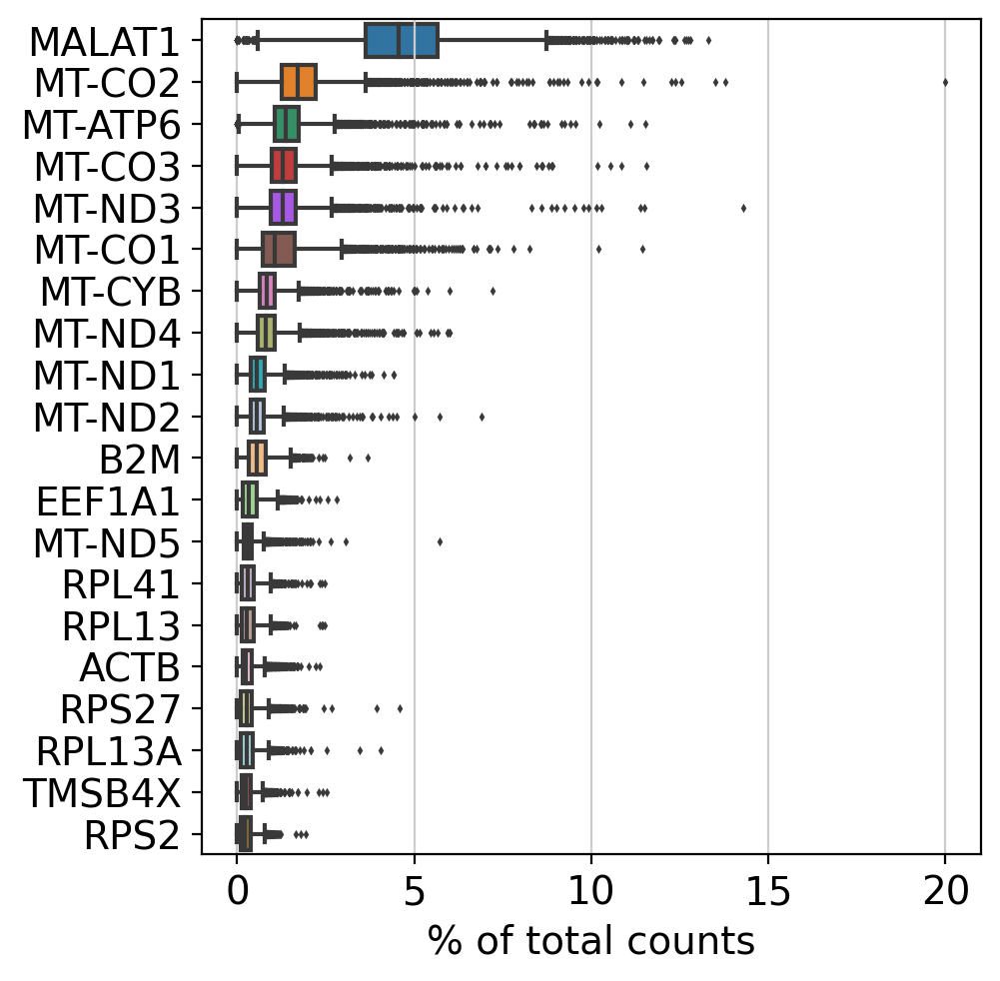

In [ ]:
sc.pl.highest_expr_genes(ad_rna, n_top=20, )

In [ ]:
def pp(adata):
    sc.pp.filter_cells(adata, min_genes=200) #get rid of cells with fewer than 200 genes
    sc.pp.filter_genes(adata, min_cells=3) #get rid of genes that are found in fewer than 3 cells

    adata.var['mt'] = adata.var_names.str.startswith('MT-')  # annotate the group of mitochondrial genes as 'mt'
    adata.var['rb'] = adata.var_names.str.startswith(('RPS','RPL'))  # annotate the group of ribosomal proteins as 'rb'
    sc.pp.calculate_qc_metrics(adata, qc_vars=['mt'], percent_top=None, log1p=False, inplace=True)
    sc.pp.calculate_qc_metrics(adata, qc_vars=['rb'], percent_top=None, log1p=False, inplace=True)
    sc.pl.violin(adata, ['n_genes_by_counts', 'total_counts', 'pct_counts_mt', 'pct_counts_rb'], jitter=0.4, multi_panel=True)

    sc.pl.scatter(adata, x='total_counts', y='pct_counts_mt')
    sc.pl.scatter(adata, x='total_counts', y='n_genes_by_counts')
    #upper_lim = np.quantile(adata.obs.n_genes_by_counts.values, .98)
    #lower_lim = np.quantile(adata.obs.n_genes_by_counts.values, .02)
    #adata = adata[(adata.obs.n_genes_by_counts < upper_lim) & (adata.obs.n_genes_by_counts > lower_lim)]
    adata = adata[adata.obs.n_genes_by_counts < 4000]
    adata = adata[adata.obs.pct_counts_mt < 20]
    sc.pp.normalize_total(adata, target_sum=1e4) #normalize every cell to 10,000 UMI
    sc.pp.log1p(adata) #change to log counts
    sc.pp.highly_variable_genes(adata, min_mean=0.0125, max_mean=3, min_disp=0.5) #these are default values
    sc.pl.highly_variable_genes(adata)
    adata.raw = adata #save raw data before processing values and further filtering
    adata = adata[:, adata.var.highly_variable] #filter highly variable
    sc.pp.regress_out(adata, ['total_counts', 'pct_counts_mt']) #Regress out effects of total counts per cell and the percentage of mitochondrial genes expressed
    sc.pp.scale(adata, max_value=10) #scale each gene to unit variance
    sc.tl.pca(adata, svd_solver='arpack') # Principal component analysis
    sc.pl.pca(adata, color='CST3')
    sc.pl.pca_variance_ratio(adata, log=True)
    adata.write(results_file)
    #adata
    sc.pp.neighbors(adata, n_neighbors=10, n_pcs=20) # Computing the neighborhood graph

    sc.tl.umap(adata) # Embedding the neighborhood graph
    return adata


/usr/local/lib/python3.10/dist-packages/scanpy/preprocessing/_normalization.py:170: UserWarning: Received a view of an AnnData. Making a copy.
  view_to_actual(adata)


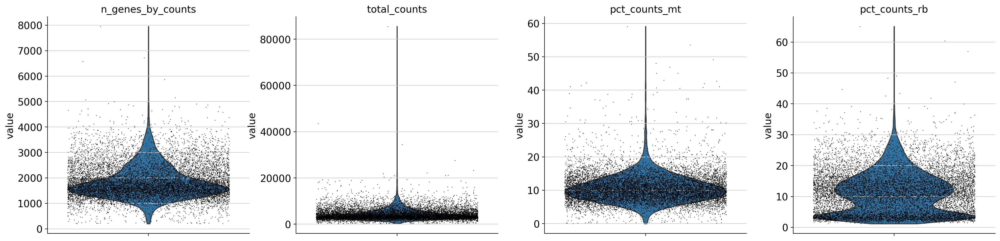

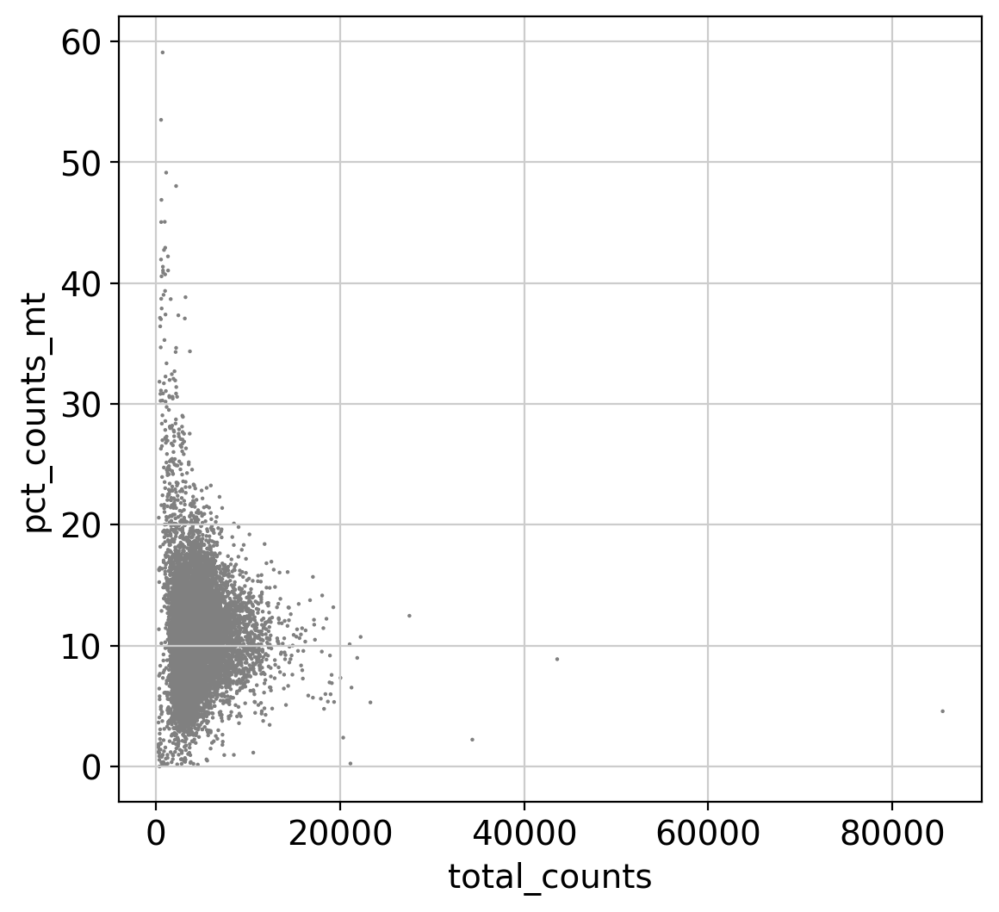

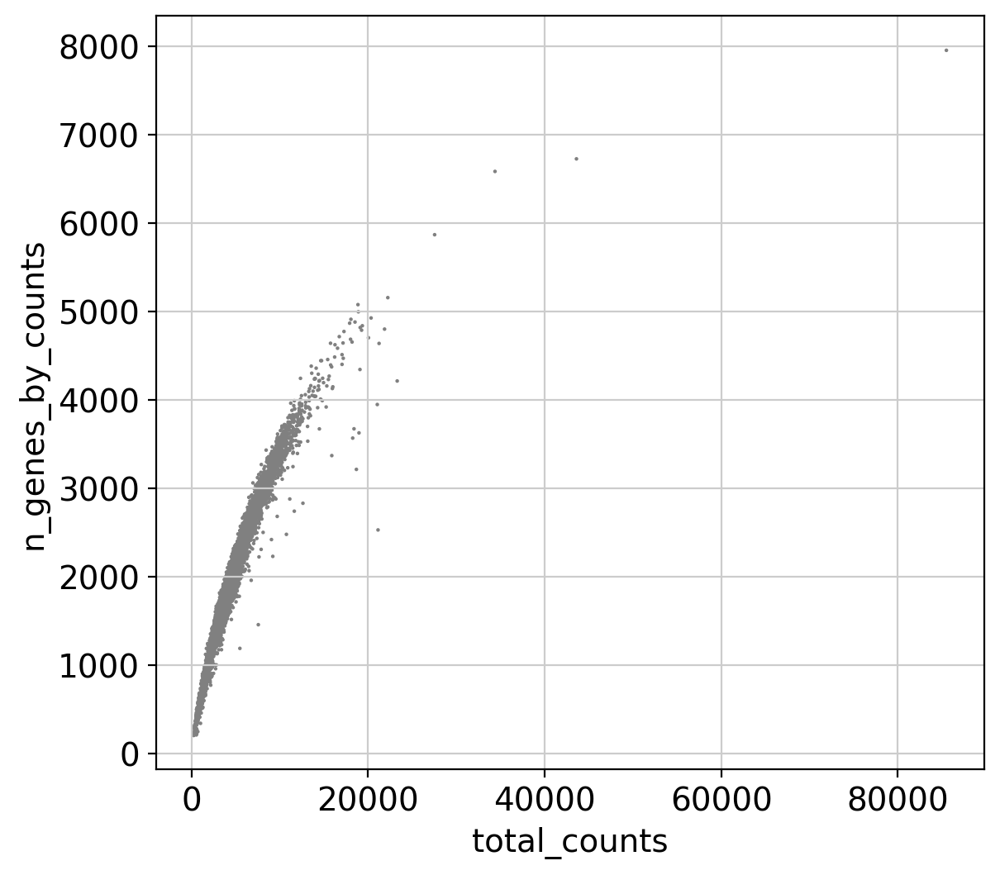

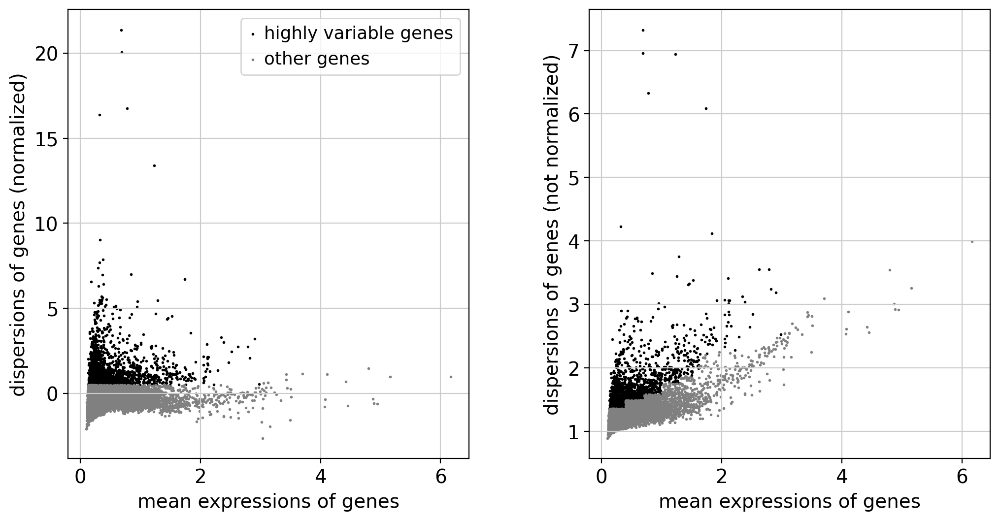

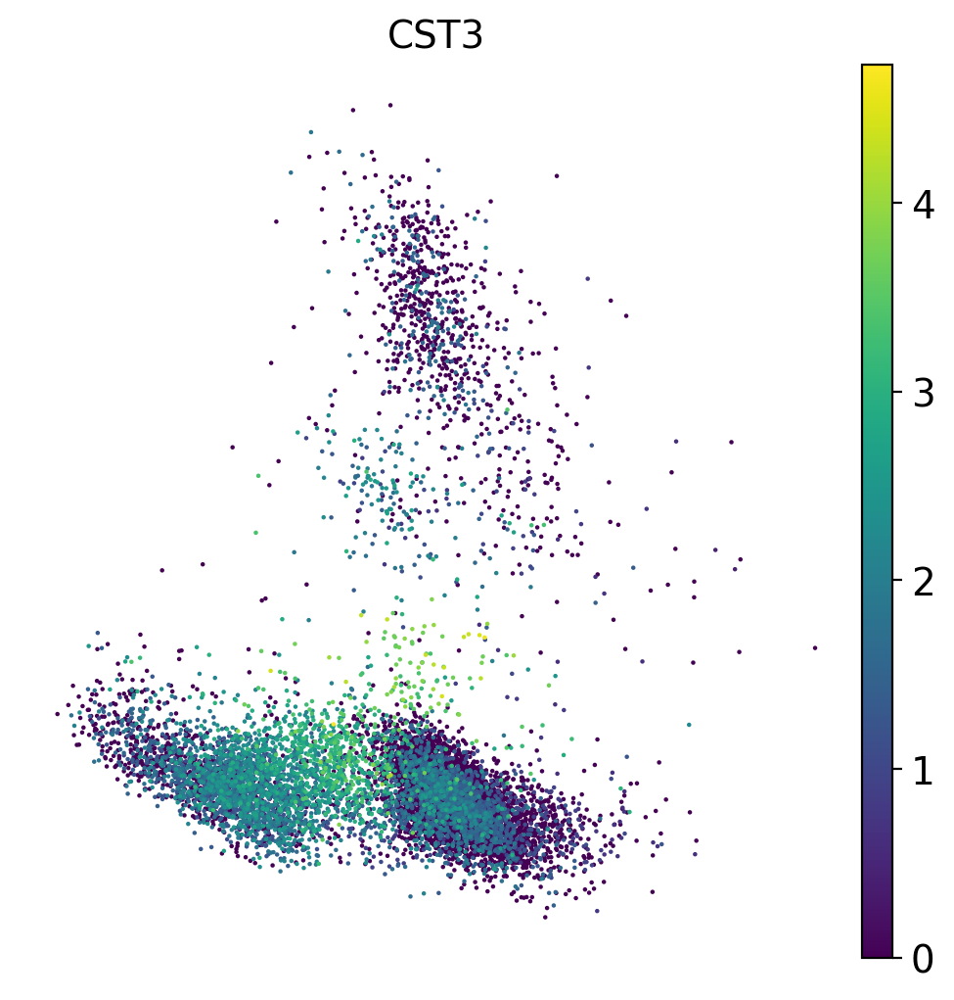

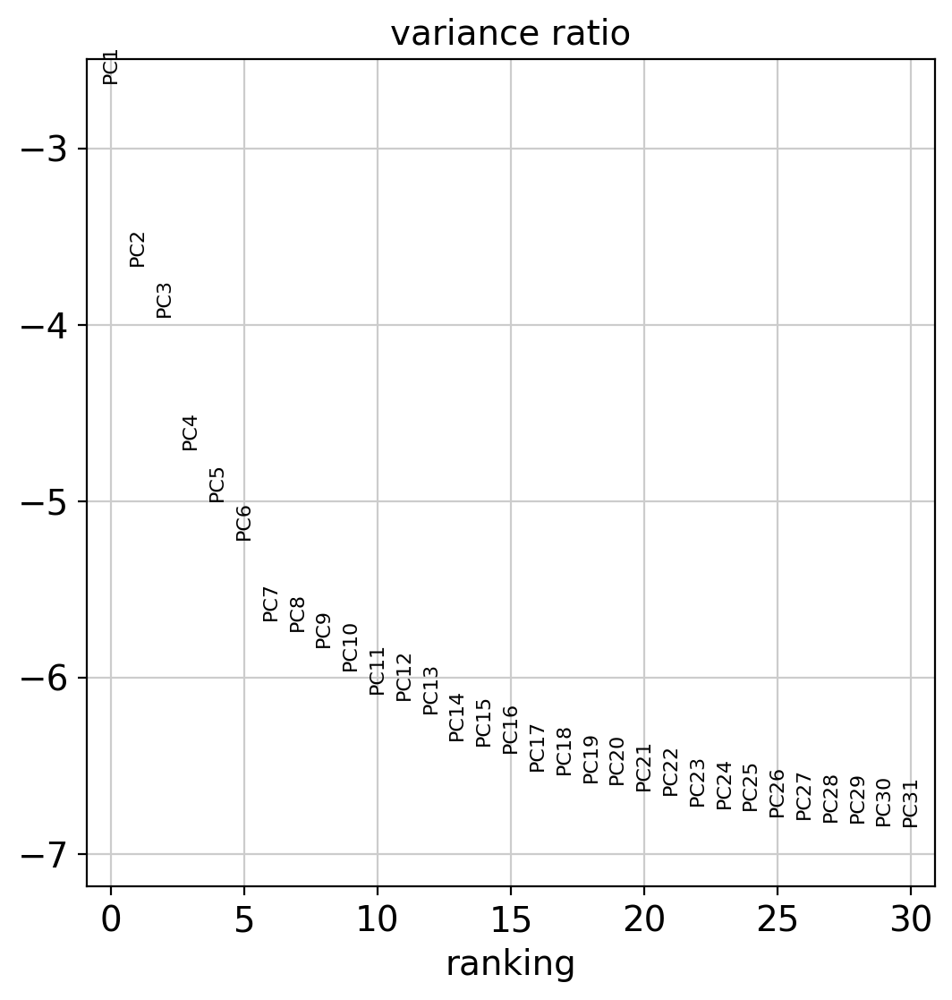

In [ ]:
ad_rna = pp(ad_rna) # pp處理後n_vars從8738降到1654 在11505個細胞上觀察這1654個基因

In [ ]:
#adata # AnnData object with n_obs × n_vars = 11505 × 1654
'''
    obs: 'all_368eqtl_gexdiff0801_367', 'top125_eqtl_124', 'n_genes', 'n_genes_by_counts', 'total_counts', 'total_counts_mt', 'pct_counts_mt'
    var: 'gene_ids', 'feature_types', 'genome', 'n_cells', 'mt', 'n_cells_by_counts', 'mean_counts', 'pct_dropout_by_counts', 'total_counts',
    'highly_variable', 'means', 'dispersions', 'dispersions_norm', 'mean', 'std'
    uns: 'log1p', 'hvg', 'pca', 'neighbors', 'umap'
    obsm: 'X_pca', 'X_umap'
    varm: 'PCs'
    obsp: 'distances', 'connectivities'
'''

"\n    obs: 'all_368eqtl_gexdiff0801_367', 'top125_eqtl_124', 'n_genes', 'n_genes_by_counts', 'total_counts', 'total_counts_mt', 'pct_counts_mt'\n    var: 'gene_ids', 'feature_types', 'genome', 'n_cells', 'mt', 'n_cells_by_counts', 'mean_counts', 'pct_dropout_by_counts', 'total_counts',\n    'highly_variable', 'means', 'dispersions', 'dispersions_norm', 'mean', 'std'\n    uns: 'log1p', 'hvg', 'pca', 'neighbors', 'umap'\n    obsm: 'X_pca', 'X_umap'\n    varm: 'PCs'\n    obsp: 'distances', 'connectivities'\n"

In [ ]:
#Define colors from red to blue
n_clusters = 6
n_colors = plt.cm.jet(np.linspace(0.9,0.1,n_clusters))
#for i in range(n_clusters):
#  subdata = data(labels==i)
#  subdata.plot.hist(bins=bins, alpha=0.5, color=colors[i],label='cluster {}'.format(i))
n_colors

array([[0.9456328 , 0.02977487, 0.        , 1.        ],
       [1.        , 0.62527233, 0.        , 1.        ],
       [0.74320051, 1.        , 0.22454143, 1.        ],
       [0.22454143, 1.        , 0.74320051, 1.        ],
       [0.        , 0.53529412, 1.        , 1.        ],
       [0.        , 0.        , 0.9456328 , 1.        ]])

In [ ]:
import matplotlib.colors as mcolors
#mcolors.is_color_like(n_colors[4])
n_colors_str = [mcolors.to_hex(color) for color in n_colors]

In [ ]:
n_colors_str

['#f10800', '#ff9f00', '#beff39', '#39ffbe', '#0088ff', '#0000f1']

/usr/local/lib/python3.10/dist-packages/scanpy/plotting/_tools/scatterplots.py:392: UserWarning: No data for colormapping provided via 'c'. Parameters 'cmap' will be ignored
  cax = scatter(


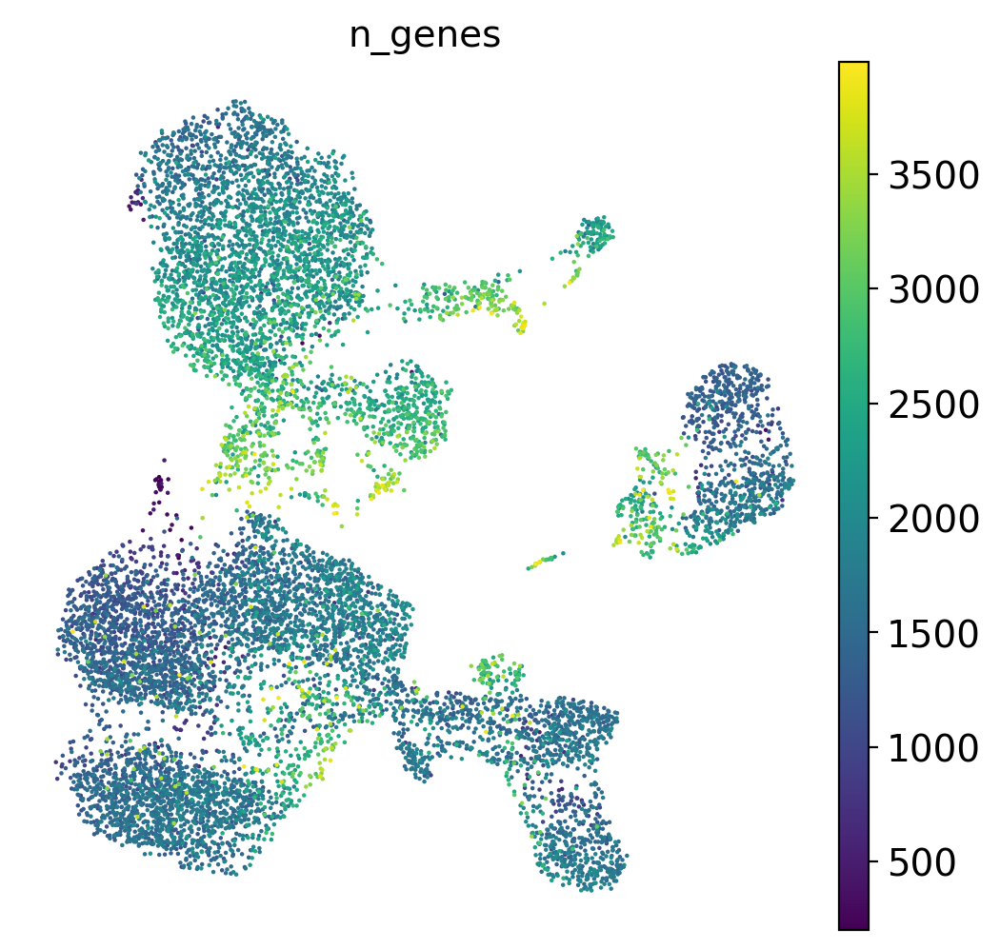

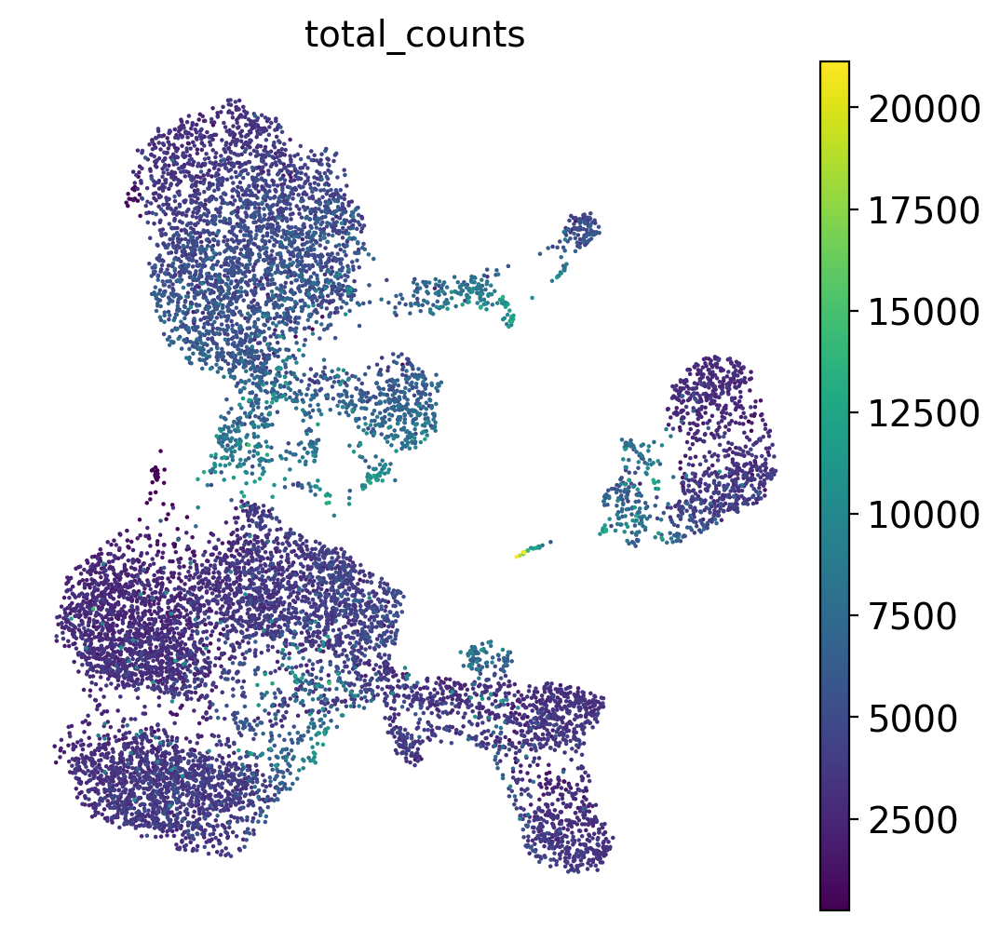

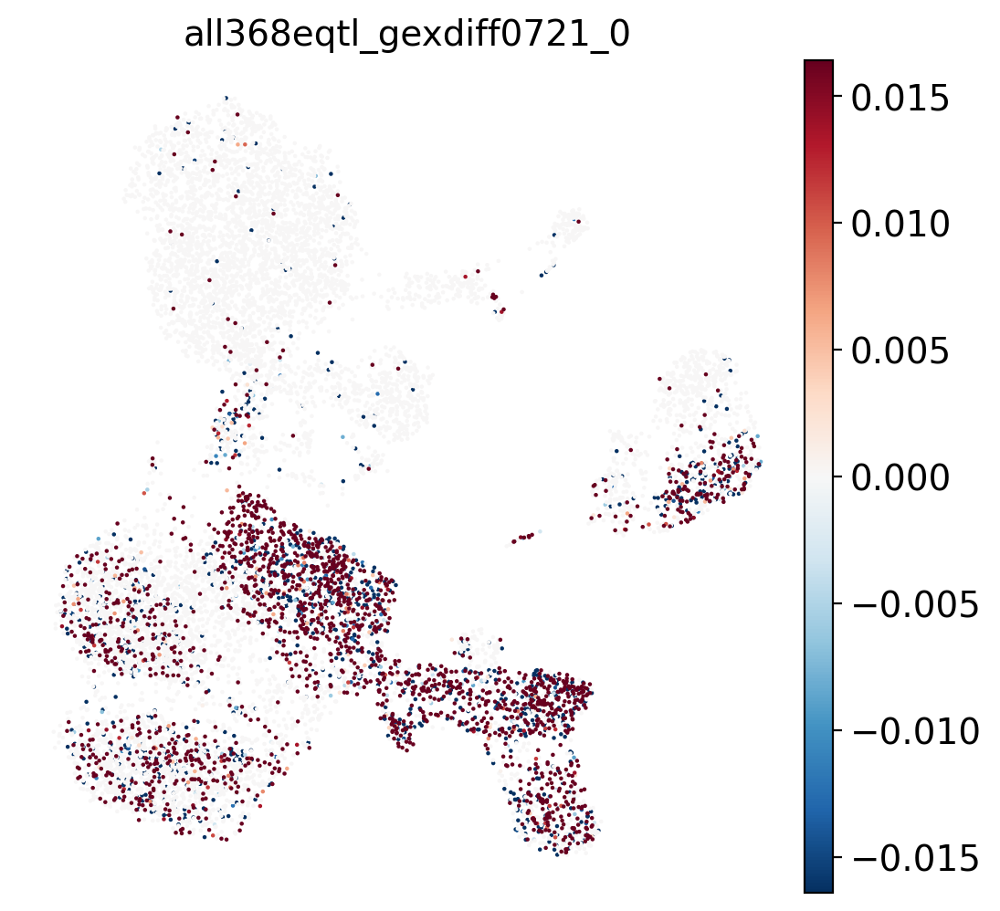

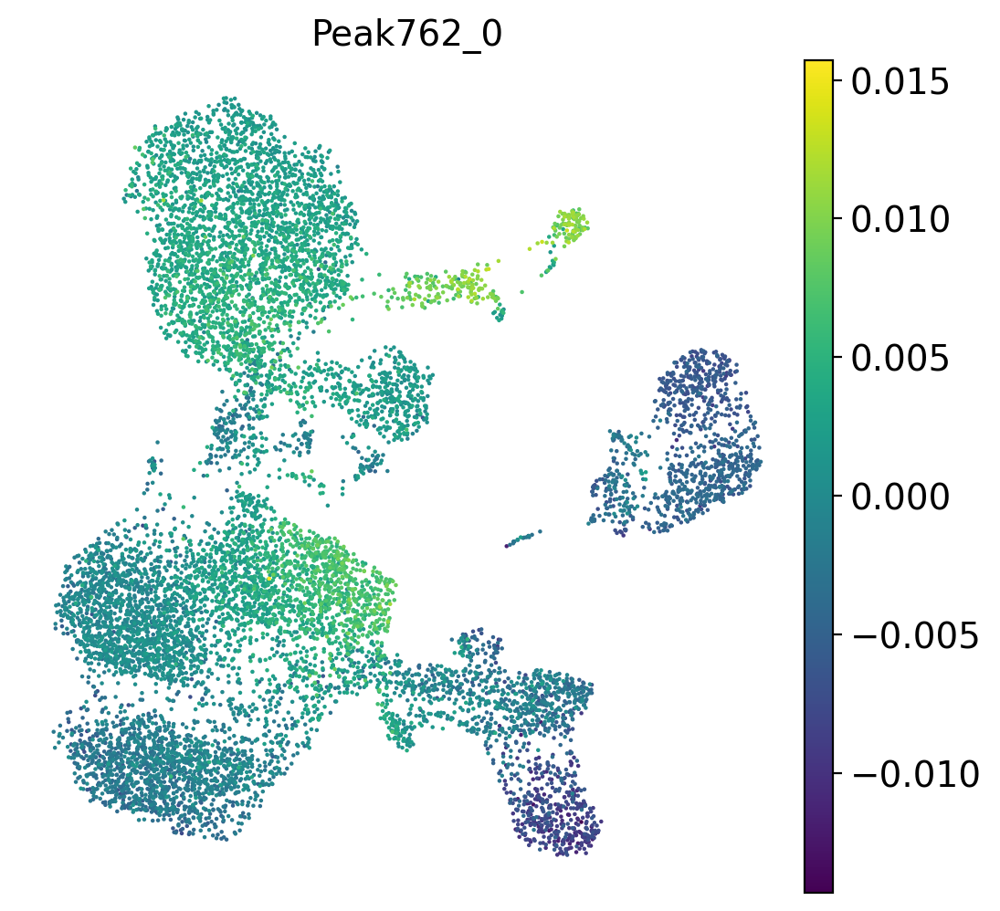

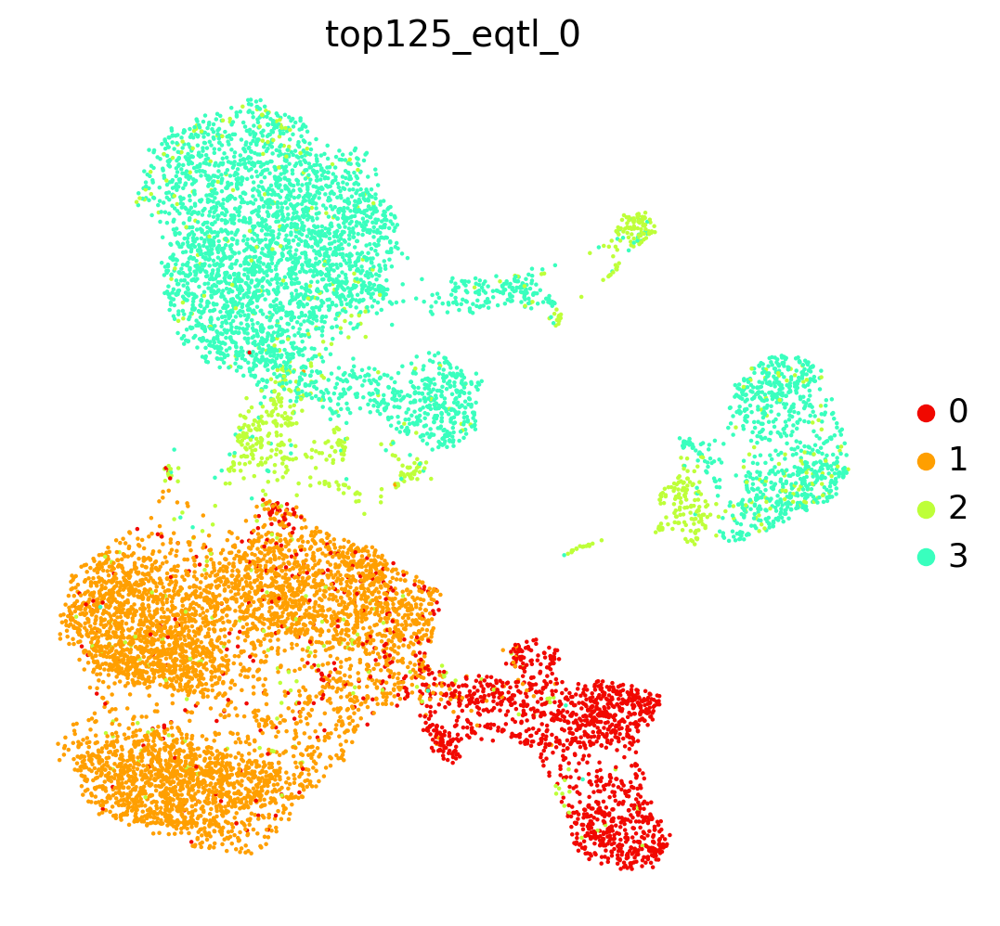

In [ ]:

sc.pl.umap(ad_rna, color = 'n_genes')
sc.pl.umap(ad_rna, color = 'total_counts')
sc.pl.umap(ad_rna, color = 'all368eqtl_gexdiff0721_0',
           colorbar_loc = 'right',
           cmap = 'RdBu_r', #cmap='jet',
           vmin = -3*all368eqtl_gexdiff_std[0],
           vmax = 3*all368eqtl_gexdiff_std[0],
           vcenter = 0,)
sc.pl.umap(ad_rna, color = 'Peak762_0')
sc.pl.umap(ad_rna, color = 'top125_eqtl_0',palette = n_colors_str) #palette = 'jet'
#sc.pl.umap(adata, color='leiden', legend_loc='on data', title='', size=110, frameon=False, save='.pdf')


/usr/local/lib/python3.10/dist-packages/scanpy/plotting/_tools/scatterplots.py:392: UserWarning: No data for colormapping provided via 'c'. Parameters 'cmap' will be ignored
  cax = scatter(


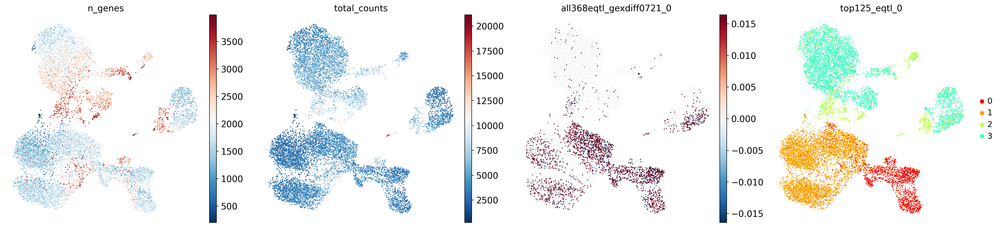

In [ ]:

sc.pl.umap(ad_rna, color = ['n_genes','total_counts','all368eqtl_gexdiff0721_0','top125_eqtl_0'],
           colorbar_loc = 'right',
           cmap = 'RdBu_r', #cmap='jet',
           vmin = [None,None,-3*all368eqtl_gexdiff_std[0]],
           vmax = [None,None,3*all368eqtl_gexdiff_std[0]],
           vcenter = [None,None,0],
           palette={
               0: n_colors_str[0],
               1: n_colors_str[1],
               2: n_colors_str[2],
               3: n_colors_str[3],
               4: n_colors_str[4],
               5: n_colors_str[5],
              }

           #palette = n_colors_str #{ 'top125_eqtl_0': n_colors_str , 'top125_eqtl_124': 'jet', }, #palette = 'jet'
           )
#sc.pl.umap(adata, color='leiden', legend_loc='on data', title='', size=110, frameon=False, save='.pdf')


In [ ]:
#adata
# AnnData object with n_obs × n_vars = 11505 × 1654
'''
    obs: 'all_368eqtl_gexdiff0801_367', 'top125_eqtl_124', 'n_genes', 'n_genes_by_counts', 'total_counts', 'total_counts_mt', 'pct_counts_mt'
    var: 'gene_ids', 'feature_types', 'genome', 'n_cells', 'mt', 'n_cells_by_counts', 'mean_counts', 'pct_dropout_by_counts', 'total_counts',
    'highly_variable', 'means', 'dispersions', 'dispersions_norm', 'mean', 'std'
    uns: 'log1p', 'hvg', 'pca', 'neighbors', 'umap', 'top125_eqtl_0_colors', 'top125_eqtl_124_colors'
    obsm: 'X_pca', 'X_umap'
    varm: 'PCs'
    obsp: 'distances', 'connectivities'
'''

"\n    obs: 'all_368eqtl_gexdiff0801_367', 'top125_eqtl_124', 'n_genes', 'n_genes_by_counts', 'total_counts', 'total_counts_mt', 'pct_counts_mt'\n    var: 'gene_ids', 'feature_types', 'genome', 'n_cells', 'mt', 'n_cells_by_counts', 'mean_counts', 'pct_dropout_by_counts', 'total_counts',\n    'highly_variable', 'means', 'dispersions', 'dispersions_norm', 'mean', 'std'\n    uns: 'log1p', 'hvg', 'pca', 'neighbors', 'umap', 'top125_eqtl_0_colors', 'top125_eqtl_124_colors'\n    obsm: 'X_pca', 'X_umap'\n    varm: 'PCs'\n    obsp: 'distances', 'connectivities'\n"

/usr/local/lib/python3.10/dist-packages/scanpy/plotting/_tools/scatterplots.py:392: UserWarning: No data for colormapping provided via 'c'. Parameters 'cmap' will be ignored
  cax = scatter(


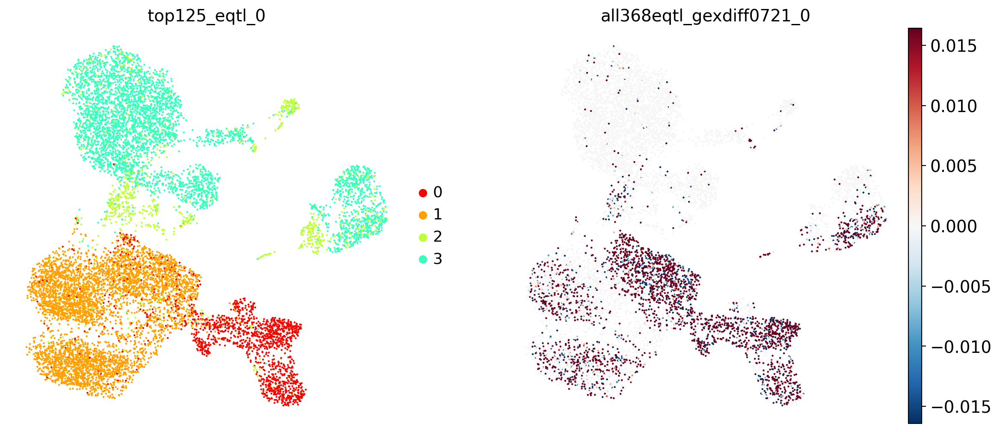

In [ ]:

sc.pl.umap(ad_rna, color = ['top125_eqtl_0','all368eqtl_gexdiff0721_0'],colorbar_loc = 'right',cmap='RdBu_r',
           vmin = -3*all368eqtl_gexdiff_std[0],vmax = 3*all368eqtl_gexdiff_std[0],
           vcenter = 0,palette = n_colors_str) #,legend_loc = 'None'


In [ ]:
#adata
# AnnData object with n_obs × n_vars = 11505 × 1654
'''
    var: 'gene_ids', 'feature_types', 'genome', 'n_cells', 'mt', 'n_cells_by_counts', 'mean_counts', 'pct_dropout_by_counts', 'total_counts',
    'highly_variable', 'means', 'dispersions', 'dispersions_norm', 'mean', 'std'
    uns: 'log1p', 'hvg', 'pca', 'neighbors', 'umap', 'top125_eqtl_0_colors'
    obsm: 'X_pca', 'X_umap'
    varm: 'PCs'
    obsp: 'distances', 'connectivities'
'''

"\n    var: 'gene_ids', 'feature_types', 'genome', 'n_cells', 'mt', 'n_cells_by_counts', 'mean_counts', 'pct_dropout_by_counts', 'total_counts',\n    'highly_variable', 'means', 'dispersions', 'dispersions_norm', 'mean', 'std'\n    uns: 'log1p', 'hvg', 'pca', 'neighbors', 'umap', 'top125_eqtl_0_colors'\n    obsm: 'X_pca', 'X_umap'\n    varm: 'PCs'\n    obsp: 'distances', 'connectivities'\n"

## Clustering leiden

In [ ]:
def cluster(adata):
  sc.tl.leiden(adata) # Clustering the neighborhood graph 用leiden做cluster

In [ ]:
cluster(ad_rna) # uns中多了leiden

In [ ]:
#ad_rna # AnnData object with n_obs × n_vars = 11505 × 1654
'''
obs: 'all_368eqtl_gexdiff0801_367', 'top125_eqtl_124', 'n_genes', 'n_genes_by_counts', 'total_counts', 'total_counts_mt', 'pct_counts_mt', 'leiden'
    var: 'gene_ids', 'feature_types', 'genome', 'n_cells', 'mt', 'n_cells_by_counts', 'mean_counts', 'pct_dropout_by_counts', 'total_counts', 'highly_variable', 'means', 'dispersions', 'dispersions_norm', 'mean', 'std'
    uns: 'log1p', 'hvg', 'pca', 'neighbors', 'umap', 'top125_eqtl_0_colors', 'top125_eqtl_124_colors', 'leiden'
    obsm: 'X_pca', 'X_umap'
    varm: 'PCs'
'''

"\nobs: 'all_368eqtl_gexdiff0801_367', 'top125_eqtl_124', 'n_genes', 'n_genes_by_counts', 'total_counts', 'total_counts_mt', 'pct_counts_mt', 'leiden'\n    var: 'gene_ids', 'feature_types', 'genome', 'n_cells', 'mt', 'n_cells_by_counts', 'mean_counts', 'pct_dropout_by_counts', 'total_counts', 'highly_variable', 'means', 'dispersions', 'dispersions_norm', 'mean', 'std'\n    uns: 'log1p', 'hvg', 'pca', 'neighbors', 'umap', 'top125_eqtl_0_colors', 'top125_eqtl_124_colors', 'leiden'\n    obsm: 'X_pca', 'X_umap'\n    varm: 'PCs'\n"

/usr/local/lib/python3.10/dist-packages/scanpy/plotting/_tools/scatterplots.py:392: UserWarning: No data for colormapping provided via 'c'. Parameters 'cmap' will be ignored
  cax = scatter(
/usr/local/lib/python3.10/dist-packages/scanpy/plotting/_tools/scatterplots.py:392: UserWarning: No data for colormapping provided via 'c'. Parameters 'cmap' will be ignored
  cax = scatter(


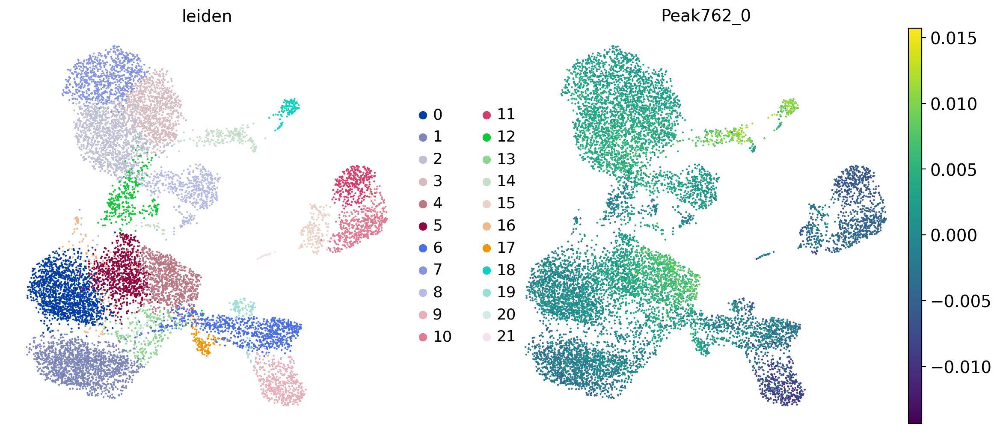

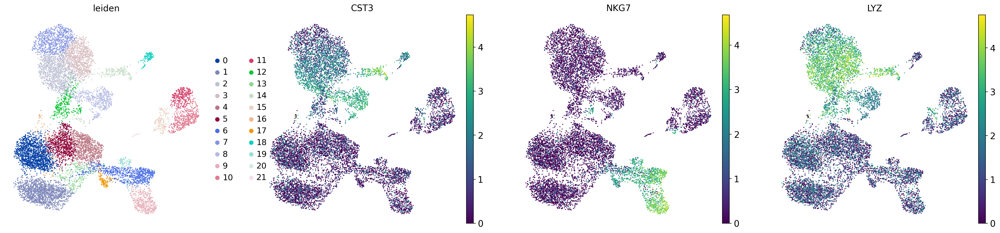

In [ ]:
sc.pl.umap(ad_rna, color=['leiden','Peak762_0'])
sc.pl.umap(ad_rna, color=['leiden','CST3', 'NKG7', 'LYZ']) # 'MS4A1',

In [ ]:
ad_rna.obs['leiden'].value_counts()

0     1529
1     1496
2     1148
3      852
4      833
5      832
6      817
7      763
8      557
9      451
10     438
11     325
12     315
13     243
14     215
15     183
16     127
17     118
18     112
19     105
20      27
21      19
Name: leiden, dtype: int64

In [ ]:
ad_rna.write(results_file)

In [ ]:
#adata # AnnData object with n_obs × n_vars = 11505 × 1654 uns多了leiden_colors
'''
    var: 'gene_ids', 'feature_types', 'genome', 'n_cells', 'mt', 'n_cells_by_counts', 'mean_counts', 'pct_dropout_by_counts', 'total_counts',
    'highly_variable', 'means', 'dispersions', 'dispersions_norm', 'mean', 'std'
    uns: 'log1p', 'hvg', 'pca', 'neighbors', 'umap', 'top125_eqtl_0_colors', 'leiden', 'leiden_colors'
    obsm: 'X_pca', 'X_umap'
    varm: 'PCs'
    obsp: 'distances', 'connectivities'
'''

"\n    var: 'gene_ids', 'feature_types', 'genome', 'n_cells', 'mt', 'n_cells_by_counts', 'mean_counts', 'pct_dropout_by_counts', 'total_counts',\n    'highly_variable', 'means', 'dispersions', 'dispersions_norm', 'mean', 'std'\n    uns: 'log1p', 'hvg', 'pca', 'neighbors', 'umap', 'top125_eqtl_0_colors', 'leiden', 'leiden_colors'\n    obsm: 'X_pca', 'X_umap'\n    varm: 'PCs'\n    obsp: 'distances', 'connectivities'\n"

## 使用不同的統計檢驗方法 t-test/wilcoxon/logreg 在不同的'leiden'分群之間進行差異基因分析，再將具有顯著差異表達的前25個基因，繪製差異基因分析的結果,sharey=False則是指在繪製差異基因的條形圖時不共享y軸刻度。

In [ ]:
def marker(adata): # Finding marker genes
  sc.tl.rank_genes_groups(adata, 'leiden', method='t-test')
  #sc.pl.rank_genes_groups(adata, n_genes=25, sharey=False)
  sc.settings.verbosity = 2  # reduce the verbosity
  sc.tl.rank_genes_groups(adata, 'leiden', method='wilcoxon') # 使用Wilcoxon統計檢驗在不同的'leiden'分群之間進行差異基因分析
  #sc.pl.rank_genes_groups(adata, n_genes=25, sharey=False) # 將具有顯著差異表達的前25個基因，繪製差異基因分析的結果,sharey=False則是指在繪製差異基因的條形圖時不共享y軸刻度。
  adata.write(results_file) # 保存到檔案中
  sc.tl.rank_genes_groups(adata, 'leiden', method='logreg')
  #sc.pl.rank_genes_groups(adata, n_genes=25, sharey=False)


In [ ]:
marker(ad_rna)

ranking genes


/usr/local/lib/python3.10/dist-packages/scanpy/tools/_rank_genes_groups.py:394: PerformanceWarning: DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at once using pd.concat(axis=1) instead. To get a de-fragmented frame, use `newframe = frame.copy()`
  self.stats[group_name, 'names'] = self.var_names[global_indices]
/usr/local/lib/python3.10/dist-packages/scanpy/tools/_rank_genes_groups.py:396: PerformanceWarning: DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at once using pd.concat(axis=1) instead. To get a de-fragmented frame, use `newframe = frame.copy()`
  self.stats[group_name, 'scores'] = scores[global_indices]
/usr/local/lib/python3.10/dist-packages/scanpy/tools/_rank_genes_groups.py:399: PerformanceWarning: DataFrame is highly fragmented.  This is usually the result

    finished (0:00:31)


/usr/local/lib/python3.10/dist-packages/scanpy/tools/_rank_genes_groups.py:394: PerformanceWarning: DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at once using pd.concat(axis=1) instead. To get a de-fragmented frame, use `newframe = frame.copy()`
  self.stats[group_name, 'names'] = self.var_names[global_indices]
/usr/local/lib/python3.10/dist-packages/scanpy/tools/_rank_genes_groups.py:396: PerformanceWarning: DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at once using pd.concat(axis=1) instead. To get a de-fragmented frame, use `newframe = frame.copy()`
  self.stats[group_name, 'scores'] = scores[global_indices]
/usr/local/lib/python3.10/dist-packages/scanpy/tools/_rank_genes_groups.py:399: PerformanceWarning: DataFrame is highly fragmented.  This is usually the result

ranking genes
    finished (0:02:35)


/usr/local/lib/python3.10/dist-packages/sklearn/linear_model/_logistic.py:458: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(


## 根據前面基因表達的差異結果,手動挑出marker genes (dotplot和stacked_violin會用到)

In [ ]:
marker_genes = ['LCK','CD3D','KLRD1','SPI1','MS4A1','CD36','IL7R', 'CD79A',
                'MS4A1', 'CD8A', 'CD8B', 'LYZ', 'CD14',
                'LGALS3', 'S100A8', 'GNLY', 'NKG7', 'KLRB1',
                'FCGR3A', 'MS4A7', 'CST3', "CD3E","CD3G","CD3D","CD2","KLRD1","NKG7","FCGR3A","LYZ","CD14","MAFB",]
# ['CD3D-', 'CD3E-', 'CD4-', 'CD8A-', 'FCER1A', 'LCK-', 'MSR1', 'NCAM1', 'NCR1']'  07/31多加了CST3後面的marker genes，剩下的是在adata 1654裡找不到的gene

In [ ]:
#marker_genes = ['LCK','CD3D','KLRD1','SPI1','MS4A1','CD36','IL7R', 'CD79A',
#                'MS4A1', 'CD8A', 'CD8B', 'LYZ', 'CD14',
#                'LGALS3', 'S100A8', 'GNLY', 'NKG7', 'KLRB1',
#                'FCGR3A', 'MS4A7', 'CST3']
#'FCER1A',"CD3E","CD3G","CD3D","CD2","KLRD1","NCAM1","NKG7","NCR1","FCGR3A","CD3D-","CD3E-","CD8A-",
#"CD4-","LCK-","LYZ","CD14","MAFB","MSR1"]

In [ ]:
#adata # AnnData object with n_obs × n_vars = 11505 × 1654
'''
    var: 'gene_ids', 'feature_types', 'genome', 'n_cells', 'mt', 'n_cells_by_counts', 'mean_counts', 'pct_dropout_by_counts', 'total_counts',
    'highly_variable', 'means', 'dispersions', 'dispersions_norm', 'mean', 'std'
    uns: 'log1p', 'hvg', 'pca', 'neighbors', 'umap', 'top125_eqtl_0_colors', 'leiden', 'leiden_colors', 'rank_genes_groups'
    obsm: 'X_pca', 'X_umap'
    varm: 'PCs'
    obsp: 'distances', 'connectivities'
'''

"\n    var: 'gene_ids', 'feature_types', 'genome', 'n_cells', 'mt', 'n_cells_by_counts', 'mean_counts', 'pct_dropout_by_counts', 'total_counts',\n    'highly_variable', 'means', 'dispersions', 'dispersions_norm', 'mean', 'std'\n    uns: 'log1p', 'hvg', 'pca', 'neighbors', 'umap', 'top125_eqtl_0_colors', 'leiden', 'leiden_colors', 'rank_genes_groups'\n    obsm: 'X_pca', 'X_umap'\n    varm: 'PCs'\n    obsp: 'distances', 'connectivities'\n"

In [ ]:
ad_rna = sc.read(results_file)
ad_rna.uns['log1p']["base"] = None #add this workaround to solve pbmc10k data issue which cause error
                   #Fix checking of log1p transformation base value when that value is None

In [ ]:
#adata # AnnData object with n_obs × n_vars = 11505 × 1654
'''
    var: 'gene_ids', 'feature_types', 'genome', 'n_cells', 'mt', 'n_cells_by_counts', 'mean_counts', 'pct_dropout_by_counts', 'total_counts', 'highly_variable', 'means', 'dispersions', 'dispersions_norm', 'mean', 'std'
    uns: 'hvg', 'leiden', 'leiden_colors', 'log1p', 'neighbors', 'pca', 'rank_genes_groups', 'top125_eqtl_0_colors', 'umap'
    obsm: 'X_pca', 'X_umap'
    varm: 'PCs'
    obsp: 'connectivities', 'distances'
'''

"\n    var: 'gene_ids', 'feature_types', 'genome', 'n_cells', 'mt', 'n_cells_by_counts', 'mean_counts', 'pct_dropout_by_counts', 'total_counts', 'highly_variable', 'means', 'dispersions', 'dispersions_norm', 'mean', 'std'\n    uns: 'hvg', 'leiden', 'leiden_colors', 'log1p', 'neighbors', 'pca', 'rank_genes_groups', 'top125_eqtl_0_colors', 'umap'\n    obsm: 'X_pca', 'X_umap'\n    varm: 'PCs'\n    obsp: 'connectivities', 'distances'\n"

In [ ]:
pd.DataFrame(ad_rna.uns['rank_genes_groups']['names']).head(5)

,0,1,2,3,4,5,6,7,8,9,...,12,13,14,15,16,17,18,19,20,21
0,LEF1,LEF1,TYMP,VCAN,ITGB1,INPP4B,CCL5,DPYD,PSAP,GNLY,...,VCAN,INPP4B,HLA-DPB1,BANK1,RPS29,PHACTR2,TCF4,GNLY,DOCK10,PPIB
1,FHIT,PDE3B,SLC8A1,DPYD,LTB,ANK3,NKG7,NEAT1,TCF7L2,PRF1,...,CSF3R,IL7R,CST3,MS4A1,RPS12,KLRB1,ZFAT,NKG7,NELL2,SSR4
2,MALAT1,NELL2,AOAH,LRMDA,IL32,CDC14A,IL32,PLXDC2,IFITM3,NKG7,...,PLXDC2,CAMK4,HLA-DRB1,PAX5,RPL13,NKG7,IRF8,PRF1,ARHGAP15,TXNDC5
3,BCL11B,THEMIS,LYZ,PLXDC2,INPP4B,LTB,GZMA,ARHGAP26,AIF1,CD247,...,DPYD,BCL11B,HLA-DPA1,AFF3,RPS27,ZBTB16,FCHSD2,KLRD1,PTPN4,JCHAIN
4,CAMK4,BACH2,JAK2,S100A8,IL7R,TTC39C,A2M,NAMPT,LST1,KLRD1,...,LRMDA,LEF1,CD74,FCRL1,RPS14,A2M,UGCG,CCL5,PITPNC1,HSP90B1


In [ ]:
#adata # AnnData object with n_obs × n_vars = 11505 × 1654
'''
    var: 'gene_ids', 'feature_types', 'genome', 'n_cells', 'mt', 'n_cells_by_counts', 'mean_counts', 'pct_dropout_by_counts', 'total_counts', 'highly_variable', 'means', 'dispersions', 'dispersions_norm', 'mean', 'std'
    uns: 'hvg', 'leiden', 'leiden_colors', 'log1p', 'neighbors', 'pca', 'rank_genes_groups', 'top125_eqtl_0_colors', 'umap'
    obsm: 'X_pca', 'X_umap'
    varm: 'PCs'
    obsp: 'connectivities', 'distances'
'''

"\n    var: 'gene_ids', 'feature_types', 'genome', 'n_cells', 'mt', 'n_cells_by_counts', 'mean_counts', 'pct_dropout_by_counts', 'total_counts', 'highly_variable', 'means', 'dispersions', 'dispersions_norm', 'mean', 'std'\n    uns: 'hvg', 'leiden', 'leiden_colors', 'log1p', 'neighbors', 'pca', 'rank_genes_groups', 'top125_eqtl_0_colors', 'umap'\n    obsm: 'X_pca', 'X_umap'\n    varm: 'PCs'\n    obsp: 'connectivities', 'distances'\n"

## 解析adata中的基因排名結果，並將結果轉換成一個Pandas DataFrame，以便進行後續分析和可視化。

In [ ]:
rna_result = ad_rna.uns['rank_genes_groups']
rna_groups = rna_result['names'].dtype.names
pd.DataFrame(
    {group + '_' + key[:1]: rna_result[key][group]
    for group in rna_groups for key in ['names', 'pvals']}).head(5)

,0_n,0_p,1_n,1_p,2_n,2_p,3_n,3_p,4_n,4_p,...,17_n,17_p,18_n,18_p,19_n,19_p,20_n,20_p,21_n,21_p
0,LEF1,0.000000e+00,LEF1,0.0,TYMP,0.0,VCAN,0.0,ITGB1,2.270712e-224,...,PHACTR2,9.176370e-50,TCF4,2.705025e-74,GNLY,2.958881e-51,DOCK10,9.746459e-13,PPIB,4.957953e-13
1,FHIT,0.000000e+00,PDE3B,0.0,SLC8A1,0.0,DPYD,0.0,LTB,8.242613e-220,...,KLRB1,4.112695e-46,ZFAT,5.929713e-73,NKG7,8.377385e-49,NELL2,4.160785e-12,SSR4,6.070100e-13
2,MALAT1,0.000000e+00,NELL2,0.0,AOAH,0.0,LRMDA,0.0,IL32,1.685700e-212,...,NKG7,2.677112e-44,IRF8,3.194435e-72,PRF1,2.732247e-40,ARHGAP15,3.826062e-11,TXNDC5,1.051320e-12
3,BCL11B,0.000000e+00,THEMIS,0.0,LYZ,0.0,PLXDC2,0.0,INPP4B,2.232772e-208,...,ZBTB16,1.007537e-39,FCHSD2,1.019688e-71,KLRD1,1.459950e-39,PTPN4,7.102271e-11,JCHAIN,1.405029e-12
4,CAMK4,3.834693e-307,BACH2,0.0,JAK2,0.0,S100A8,0.0,IL7R,1.345231e-200,...,A2M,3.662133e-39,UGCG,1.250858e-71,CCL5,3.061196e-34,PITPNC1,7.721829e-11,HSP90B1,1.710155e-12


In [ ]:
#adata # AnnData object with n_obs × n_vars = 11505 × 1654
'''
    var: 'gene_ids', 'feature_types', 'genome', 'n_cells', 'mt', 'n_cells_by_counts', 'mean_counts', 'pct_dropout_by_counts', 'total_counts', 'highly_variable', 'means', 'dispersions', 'dispersions_norm', 'mean', 'std'
    uns: 'hvg', 'leiden', 'leiden_colors', 'log1p', 'neighbors', 'pca', 'rank_genes_groups', 'top125_eqtl_0_colors', 'umap'
    obsm: 'X_pca', 'X_umap'
    varm: 'PCs'
    obsp: 'connectivities', 'distances'
'''

"\n    var: 'gene_ids', 'feature_types', 'genome', 'n_cells', 'mt', 'n_cells_by_counts', 'mean_counts', 'pct_dropout_by_counts', 'total_counts', 'highly_variable', 'means', 'dispersions', 'dispersions_norm', 'mean', 'std'\n    uns: 'hvg', 'leiden', 'leiden_colors', 'log1p', 'neighbors', 'pca', 'rank_genes_groups', 'top125_eqtl_0_colors', 'umap'\n    obsm: 'X_pca', 'X_umap'\n    varm: 'PCs'\n    obsp: 'connectivities', 'distances'\n"

ranking genes
    finished (0:00:04)


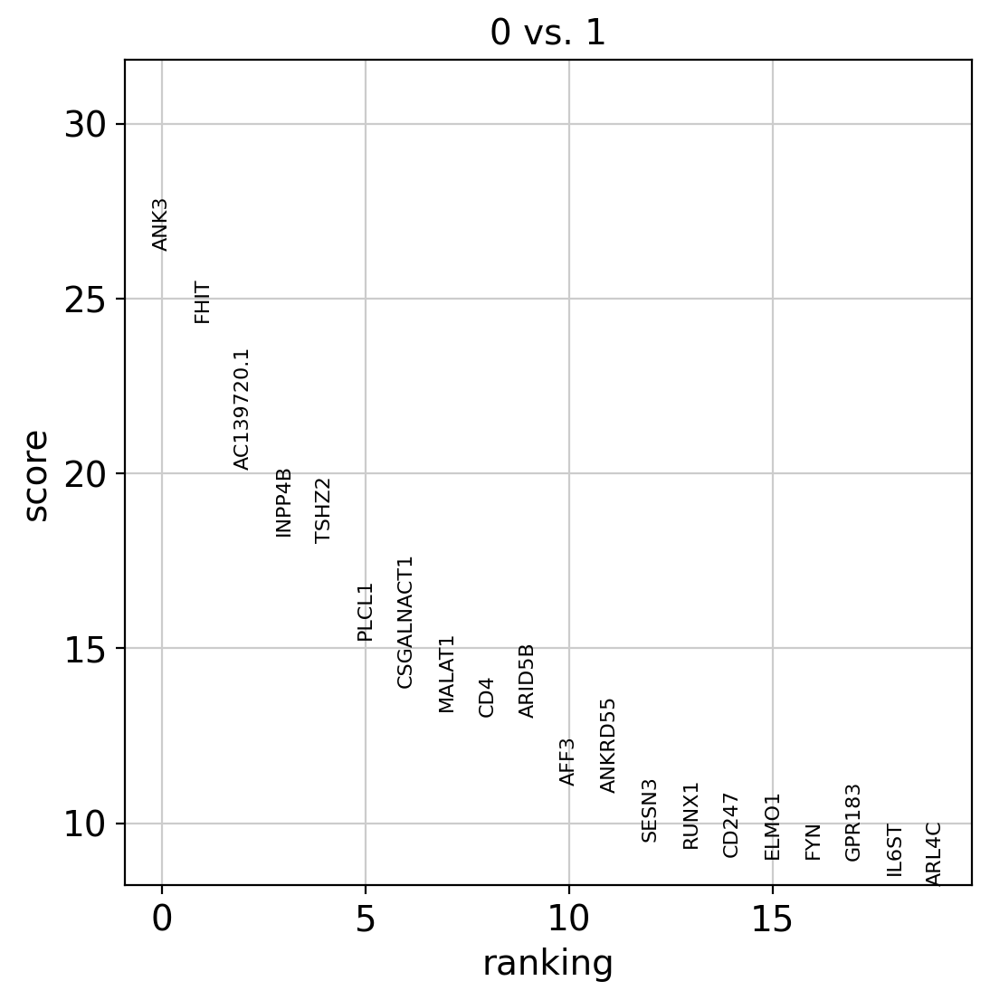

In [ ]:
sc.tl.rank_genes_groups(ad_rna, 'leiden', groups=['0'], reference='1', method='wilcoxon')
sc.pl.rank_genes_groups(ad_rna, groups=['0'], n_genes=20)

/usr/local/lib/python3.10/dist-packages/seaborn/categorical.py:166: FutureWarning: Setting a gradient palette using color= is deprecated and will be removed in version 0.13. Set `palette='dark:black'` for same effect.
  warnings.warn(msg, FutureWarning)


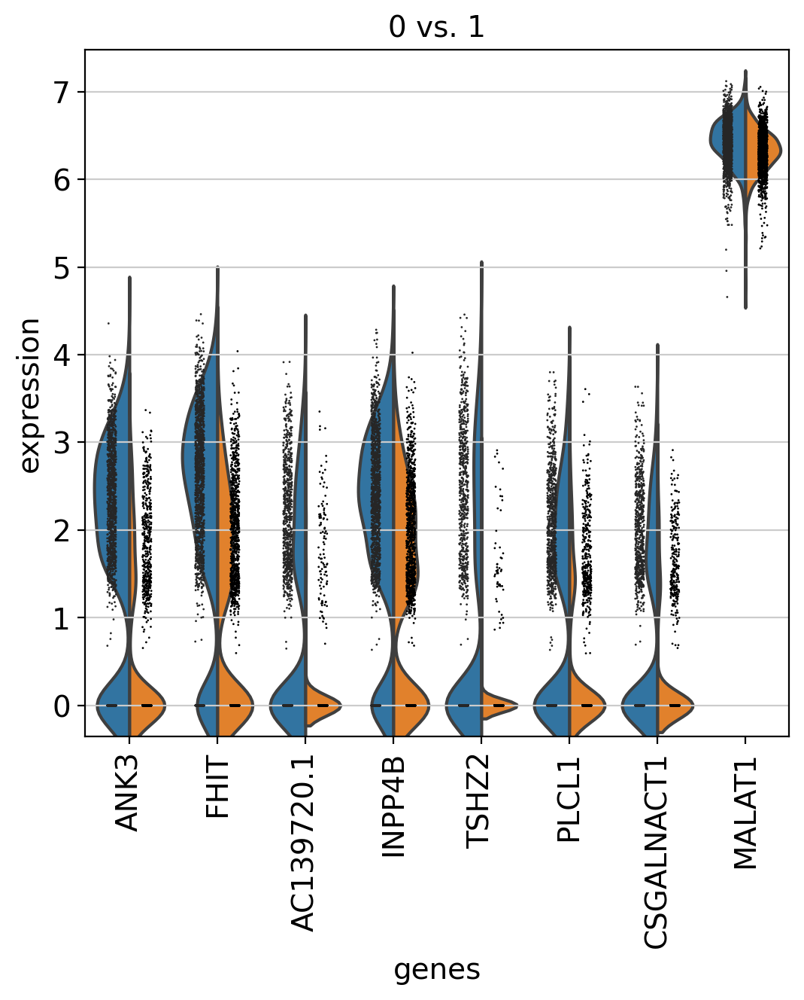

In [ ]:
sc.pl.rank_genes_groups_violin(ad_rna, groups='0', n_genes=8)

In [ ]:
#adata.uns['rank_genes_groups']

In [ ]:
ad_rna = sc.read(results_file)
#adata.uns['log1p']["base"] = None #add this workaround to solve pbmc10k data issue which cause error
                   #Fix checking of log1p transformation base value when that value is None

In [ ]:
ad_rna.uns['rank_genes_groups']

{'logfoldchanges': array([( 3.0152636 ,  3.2193754,  3.2857926,  4.8885045,  2.8168287,  2.900599  ,  5.7902255,  2.8916094,  3.46756  ,  6.915102 ,  6.979989 ,  7.4215283,  3.1655562 ,  2.2672887,  3.8197105,  5.153724  ,  1.5248973,  3.2822018,  7.512587 ,  5.1000447,  2.0597596,  4.4368753),
        ( 3.0315561 ,  2.8163207,  4.0622125,  2.8044295,  2.5076673,  2.5063055 ,  4.500117 ,  3.064689 ,  4.8098884,  5.9390364,  5.8592954,  5.891585 ,  2.5332823 ,  2.227654 ,  3.9313314,  4.7346396 ,  1.5743107,  4.8560963,  6.619215 ,  4.292771 ,  3.908926 ,  4.0271716),
        ( 0.53524286,  3.9501204,  2.9742935,  4.031399 ,  2.467087 ,  1.835168  ,  2.4548328,  4.1781425,  4.5888023,  5.677354 ,  6.6221905,  6.441042 ,  3.1626337 ,  2.1297393,  3.61031  ,  4.5032287 ,  1.4306526,  3.7458375,  5.3222475,  3.8091052,  1.7149056,  8.387401 ),
        ...,
        (-0.7129294 , -5.253939 , -1.6318828, -1.9632967, -4.9754   , -0.50314224, -4.5180974, -2.7464411, -3.8870313, -4.316707 , -3.7

/usr/local/lib/python3.10/dist-packages/seaborn/categorical.py:166: FutureWarning: Setting a gradient palette using color= is deprecated and will be removed in version 0.13. Set `palette='dark:black'` for same effect.
  warnings.warn(msg, FutureWarning)


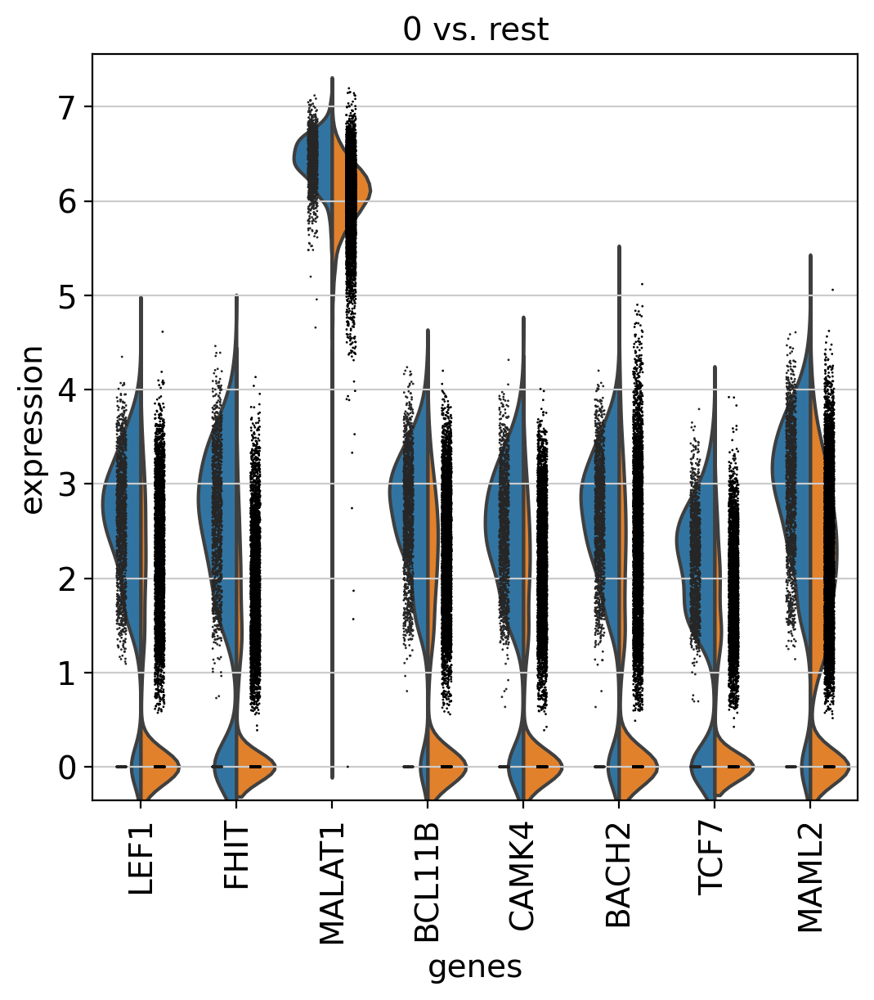

In [ ]:
sc.pl.rank_genes_groups_violin(ad_rna, groups='0', n_genes=8)

[<Axes: xlabel='leiden', ylabel='CST3'>,
 <Axes: xlabel='leiden', ylabel='NKG7'>,
 <Axes: xlabel='leiden', ylabel='MS4A1'>,
 <Axes: xlabel='leiden', ylabel='LYZ'>]

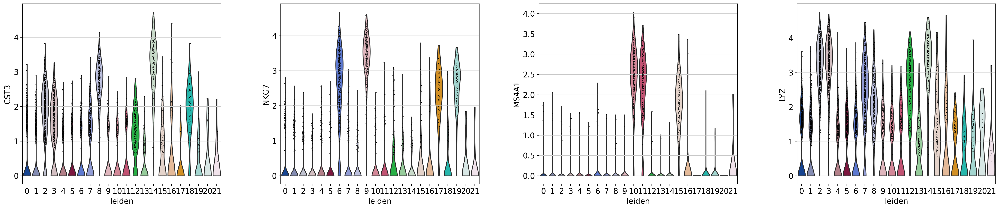

In [ ]:
sc.pl.violin(ad_rna, ['CST3', 'NKG7', 'MS4A1', 'LYZ'], groupby='leiden')

## 根據以上rank_genes_groups的結果，手動標註annotation細胞類別Cell Type

In [ ]:
new_cluster_names = [
"CD4 Naive", "CD4 TCM", "CD4 CTL", "CD4 TEM", "CD4 Proliferating",
"CD8 Naive", "dnT", "CD8 TEM", "CD8 TCM", "CD8 Proliferating",
"MAIT", "NK", "NK_CD56bright", "NK Proliferating", "gdT",
"Treg", "B naive", "B intermediate", "B memory", "Plasmablast"
,"CD14 Mono",'CD16 Mono'                 ]

ad_rna.obs['celltype'] = ad_rna.obs['leiden']
#ad_rna.obs['celltype'] = ad_rna.obs.leiden.astype("str").values
#ad_rna.obs.celltype = ad_rna.obs.celltype.astype("category").cat.rename_categories(new_cluster_names)
ad_rna.rename_categories('celltype', new_cluster_names)
#ad_rna.rename_categories('leiden', new_cluster_names)

In [ ]:
'''
new_cluster_names = [
"CD4 Naive", "CD4 TCM", "CD4 CTL", "CD4 TEM", "CD4 Proliferating",
"CD8 Naive", "dnT", "CD8 TEM", "CD8 TCM", "CD8 Proliferating",
"MAIT", "NK", "NK_CD56bright", "NK Proliferating", "gdT",
"Treg", "B naive", "B intermediate", "B memory", "Plasmablast"
,"CD14 Mono",'CD16 Mono'                 ]
ad_rna.rename_categories('leiden', new_cluster_names)
'''

'\nnew_cluster_names = [\n"CD4 Naive", "CD4 TCM", "CD4 CTL", "CD4 TEM", "CD4 Proliferating",\n"CD8 Naive", "dnT", "CD8 TEM", "CD8 TCM", "CD8 Proliferating",\n"MAIT", "NK", "NK_CD56bright", "NK Proliferating", "gdT",\n"Treg", "B naive", "B intermediate", "B memory", "Plasmablast"\n,"CD14 Mono",\'CD16 Mono\'                 ]\nad_rna.rename_categories(\'leiden\', new_cluster_names)\n'

In [ ]:
ad_rna.obs['celltype'].value_counts()

CD4 Naive            1529
CD4 TCM              1496
CD4 CTL              1148
CD4 TEM               852
CD4 Proliferating     833
CD8 Naive             832
dnT                   817
CD8 TEM               763
CD8 TCM               557
CD8 Proliferating     451
MAIT                  438
NK                    325
NK_CD56bright         315
NK Proliferating      243
gdT                   215
Treg                  183
B naive               127
B intermediate        118
B memory              112
Plasmablast           105
CD14 Mono              27
CD16 Mono              19
Name: celltype, dtype: int64

In [ ]:
#adata

In [ ]:
#adata.uns['celltype_colors']

/usr/local/lib/python3.10/dist-packages/scanpy/plotting/_tools/scatterplots.py:392: UserWarning: No data for colormapping provided via 'c'. Parameters 'cmap' will be ignored
  cax = scatter(
/usr/local/lib/python3.10/dist-packages/scanpy/plotting/_tools/scatterplots.py:392: UserWarning: No data for colormapping provided via 'c'. Parameters 'cmap' will be ignored
  cax = scatter(


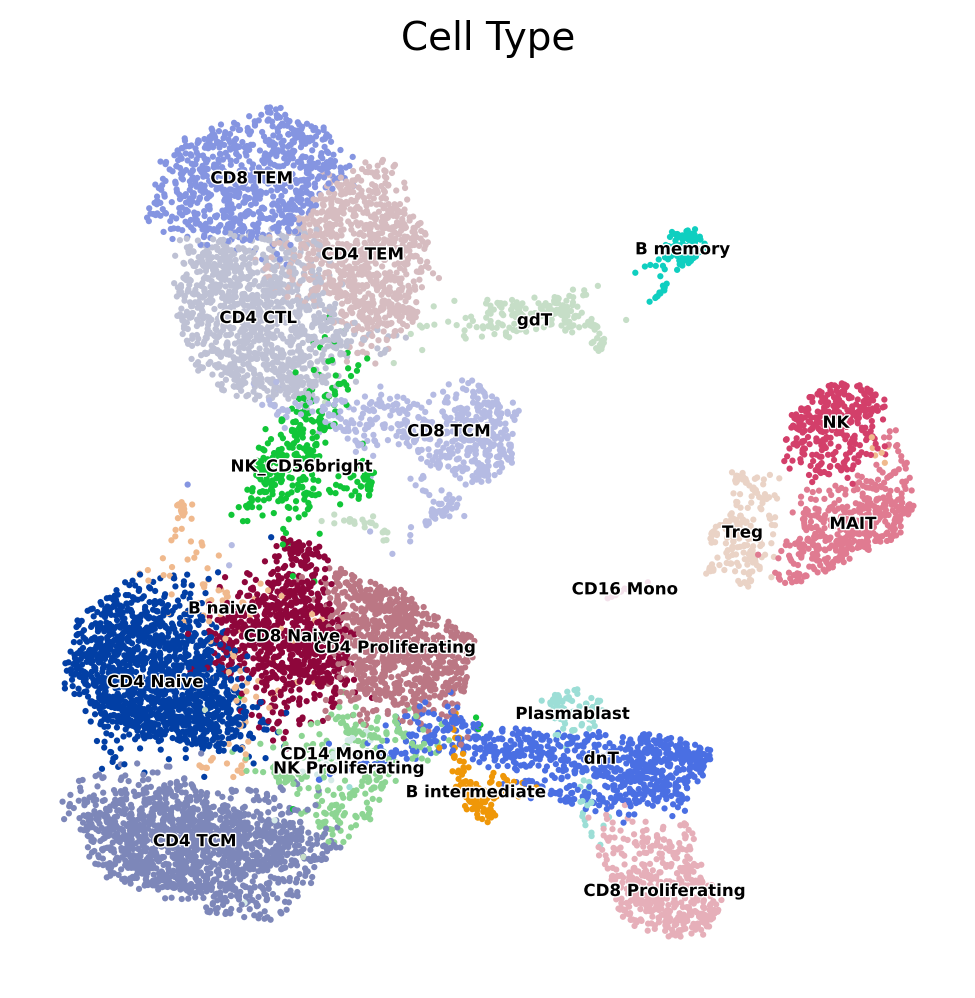

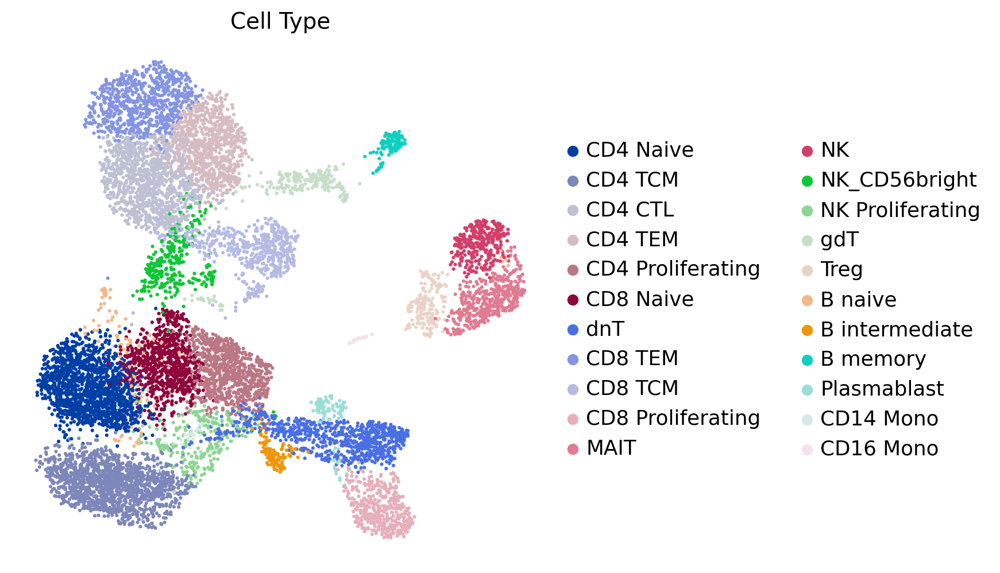

In [ ]:
sc.pl.umap(ad_rna, color='celltype', legend_loc='on data', legend_fontsize=6, legend_fontoutline=1, title='Cell Type', size=20, frameon=False,) # save='CellType.pdf') # legend_fontsize="xx-small"
sc.pl.umap(ad_rna, color='celltype', title='Cell Type', size=20, frameon=False,) # save='Cell_Type.pdf')

/usr/local/lib/python3.10/dist-packages/scanpy/plotting/_tools/scatterplots.py:392: UserWarning: No data for colormapping provided via 'c'. Parameters 'cmap' will be ignored
  cax = scatter(
/usr/local/lib/python3.10/dist-packages/scanpy/plotting/_tools/scatterplots.py:392: UserWarning: No data for colormapping provided via 'c'. Parameters 'cmap' will be ignored
  cax = scatter(


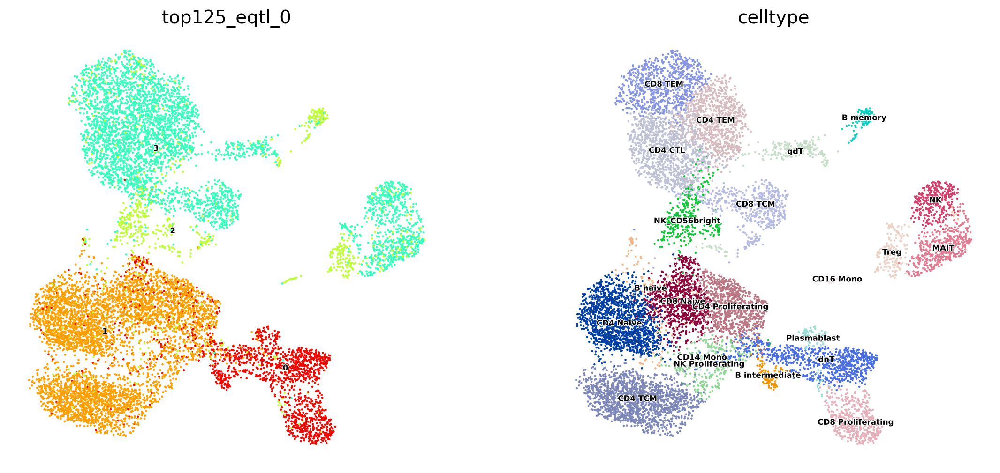

In [ ]:

sc.pl.umap(ad_rna, color = ['top125_eqtl_0','celltype',],
           legend_loc='on data', legend_fontsize=6, legend_fontoutline=1,
           #palette='jet',)

       palette={
           0: n_colors_str[0],
           1: n_colors_str[1],
           2: n_colors_str[2],
           3: n_colors_str[3],
           4: n_colors_str[4],
           'CD4 Naive' : '#023fa5',
           'CD4 TCM' : '#7d87b9',
           'CD4 CTL' : '#bec1d4',
           'CD4 TEM' : '#d6bcc0',
           'CD4 Proliferating' : '#bb7784',
           'CD8 Naive' : '#8e063b',
           'dnT' : '#4a6fe3',
           'CD8 TEM' : '#8595e1',
           'CD8 TCM' : '#b5bbe3',
           'CD8 Proliferating' : '#e6afb9',
           'MAIT' : '#e07b91',
           'NK' : '#d33f6a',
           'NK_CD56bright' : '#11c638',
           'NK Proliferating' : '#8dd593',
           'gdT' : '#c6dec7',
           'Treg' : '#ead3c6',
           'B naive' : '#f0b98d',
           'B intermediate' : '#ef9708',
           'B memory' : '#0fcfc0',
           'Plasmablast' : '#9cded6',
           'CD14 Mono' : '#d5eae7',
           'CD16 Mono' : '#f3e1eb'

          }

           ) #'all_762eqtl_0','Peak762_0',palette = 'jet',


/usr/local/lib/python3.10/dist-packages/scanpy/plotting/_dotplot.py:749: UserWarning: No data for colormapping provided via 'c'. Parameters 'cmap', 'norm' will be ignored
  dot_ax.scatter(x, y, **kwds)


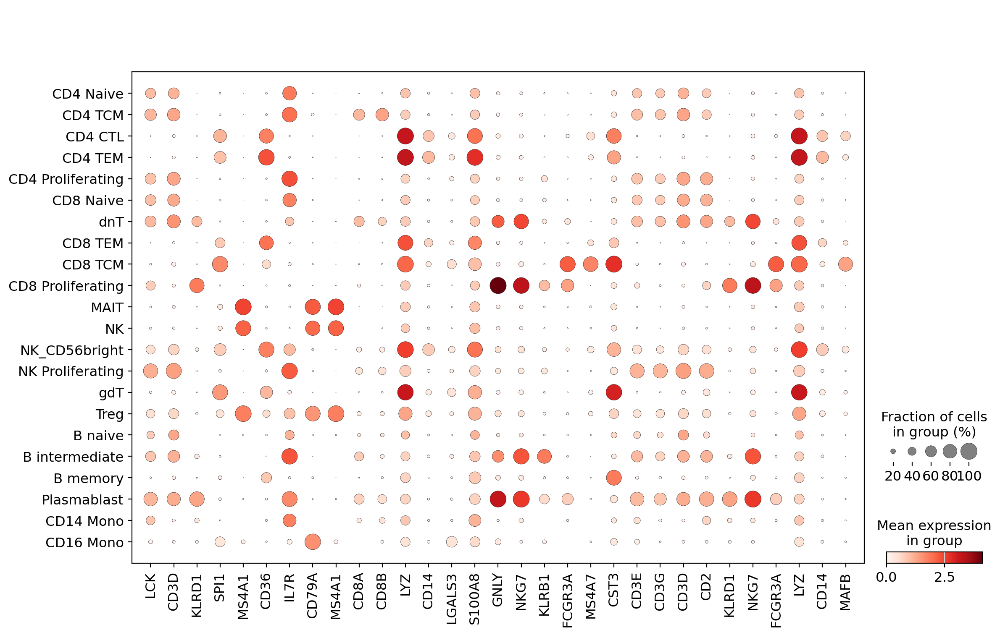

In [ ]:
sc.pl.dotplot(ad_rna, marker_genes, groupby='celltype');

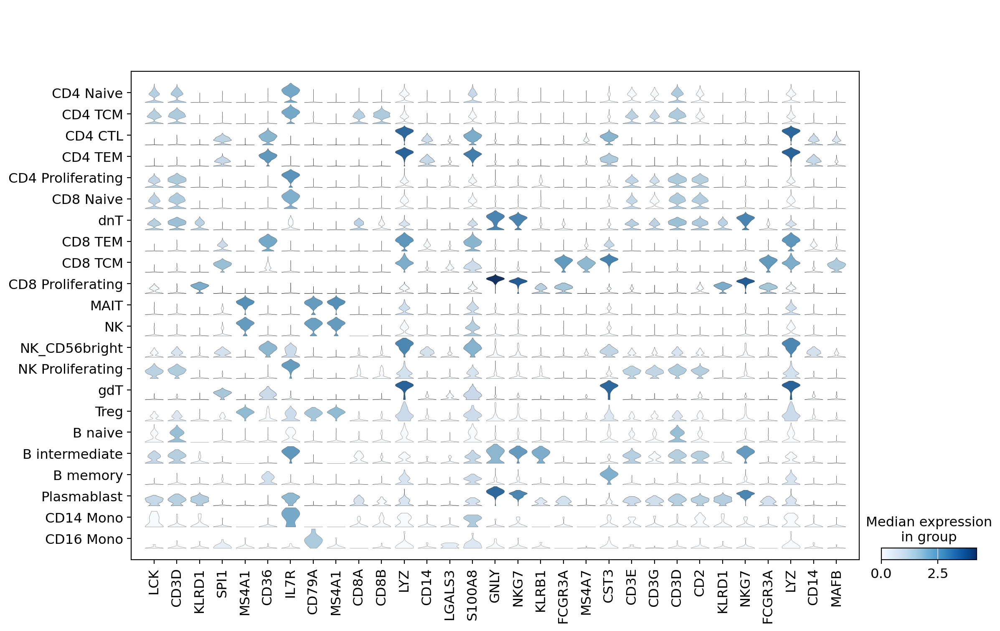

In [ ]:
sc.pl.stacked_violin(ad_rna, marker_genes, groupby='celltype', rotation=90);

In [ ]:
#adata # AnnData object with n_obs × n_vars = 11505 × 1654
'''
    var: 'gene_ids', 'feature_types', 'genome', 'n_cells', 'mt', 'n_cells_by_counts', 'mean_counts', 'pct_dropout_by_counts', 'total_counts',
    'highly_variable', 'means', 'dispersions', 'dispersions_norm', 'mean', 'std'
    uns: 'hvg', 'leiden', 'leiden_colors', 'log1p', 'neighbors', 'pca', 'rank_genes_groups', 'top125_eqtl_0_colors', 'umap', 'all_762eqtl_0_colors'
    obsm: 'X_pca', 'X_umap'
    varm: 'PCs'
    obsp: 'connectivities', 'distances'
'''

"\n    var: 'gene_ids', 'feature_types', 'genome', 'n_cells', 'mt', 'n_cells_by_counts', 'mean_counts', 'pct_dropout_by_counts', 'total_counts',\n    'highly_variable', 'means', 'dispersions', 'dispersions_norm', 'mean', 'std'\n    uns: 'hvg', 'leiden', 'leiden_colors', 'log1p', 'neighbors', 'pca', 'rank_genes_groups', 'top125_eqtl_0_colors', 'umap', 'all_762eqtl_0_colors'\n    obsm: 'X_pca', 'X_umap'\n    varm: 'PCs'\n    obsp: 'connectivities', 'distances'\n"

In [ ]:
ad_rna.write(results_file, compression='gzip')  # `compression='gzip'` saves disk space, but slows down writing and subsequent reading

In [ ]:
ad_rna.raw.to_adata().write('./write/pbmc10k_withoutX.h5ad')

In [ ]:
# Export single fields of the annotation of observations
ad_rna.obs[['n_genes', 'celltype']].to_csv('./write/pbmc10k_corrected_leiden.csv')

# Export single columns of the multidimensional annotation
ad_rna.obsm.to_df()[['X_pca1', 'X_pca2']].to_csv('./write/pbmc10k_corrected_X_pca.csv')

# Or export everything except the data using `.write_csvs`.
# Set `skip_data=False` if you also want to export the data.
ad_rna.write_csvs(results_file[:-5], )

In [ ]:
ad_rna.obs.to_csv('./write/pbmc10k_adata_obs.csv')

In [ ]:
#adata # AnnData object with n_obs × n_vars = 11505 × 1654
'''
    obs: 'all_368eqtl_gexdiff0801_0', 'top125_eqtl_0', 'n_genes', 'n_genes_by_counts', 'total_counts', 'total_counts_mt', 'pct_counts_mt', 'leiden'
    var: 'gene_ids', 'feature_types', 'genome', 'n_cells', 'mt', 'n_cells_by_counts', 'mean_counts', 'pct_dropout_by_counts', 'total_counts',
    'highly_variable', 'means', 'dispersions', 'dispersions_norm', 'mean', 'std'
    uns: 'hvg', 'leiden', 'leiden_colors', 'log1p', 'neighbors', 'pca', 'rank_genes_groups', 'top125_eqtl_0_colors', 'umap', 'all_762eqtl_0_colors'
    obsm: 'X_pca', 'X_umap'
    varm: 'PCs'
    obsp: 'connectivities', 'distances'
'''

"\n    obs: 'all_368eqtl_gexdiff0801_0', 'top125_eqtl_0', 'n_genes', 'n_genes_by_counts', 'total_counts', 'total_counts_mt', 'pct_counts_mt', 'leiden'\n    var: 'gene_ids', 'feature_types', 'genome', 'n_cells', 'mt', 'n_cells_by_counts', 'mean_counts', 'pct_dropout_by_counts', 'total_counts',\n    'highly_variable', 'means', 'dispersions', 'dispersions_norm', 'mean', 'std'\n    uns: 'hvg', 'leiden', 'leiden_colors', 'log1p', 'neighbors', 'pca', 'rank_genes_groups', 'top125_eqtl_0_colors', 'umap', 'all_762eqtl_0_colors'\n    obsm: 'X_pca', 'X_umap'\n    varm: 'PCs'\n    obsp: 'connectivities', 'distances'\n"

In [ ]:
mdata.mod['rna'] = ad_rna

In [ ]:
mdata.write('./write/pbmc10k.h5mu')

# 接下來使用moun做ATAC-seq Procsssing

muon is a Python framework for multimodal omics analysis. While there are many features that muon brings to the table, there are three key areas that its functionality is focused on.

https://muon.readthedocs.io/en/latest/

## Processing chromatin accessibility

In [ ]:
#ad_atac
'''
AnnData object with n_obs × n_vars = 11898 × 36018
    obs: 'all368eqtl_gexdiff0721_367', 'top125_eqtl_124', 'Peak762_785', 'n_genes'
    var: 'gene_ids', 'feature_types', 'genome', 'interval', 'chr', 'start', 'end', 'n_cells'
    uns: 'atac', 'files'
'''

"\nAnnData object with n_obs × n_vars = 11898 × 36018\n    obs: 'all368eqtl_gexdiff0721_367', 'top125_eqtl_124', 'Peak762_785', 'n_genes'\n    var: 'gene_ids', 'feature_types', 'genome', 'interval', 'chr', 'start', 'end', 'n_cells'\n    uns: 'atac', 'files'\n"

In [ ]:
adata_rna = ad_rna
adata_atac = ad_atac

In [ ]:
mdata = MuData({'rna': adata_rna, 'atac': adata_atac})

In [ ]:
mdata.mod['atac'].var_names_make_unique()

In [ ]:
#mdata.mod['atac']
'''
AnnData object with n_obs × n_vars = 11898 × 36018
    obs: 'all368eqtl_gexdiff0721_367', 'top125_eqtl_124','Peak762_785', 'n_genes'
    var: 'gene_ids', 'feature_types', 'genome', 'interval', 'chr', 'start', 'end', 'n_cells'
    uns: 'atac', 'files'
'''

"\nAnnData object with n_obs × n_vars = 11898 × 36018\n    obs: 'all368eqtl_gexdiff0721_367', 'top125_eqtl_124','Peak762_785', 'n_genes'\n    var: 'gene_ids', 'feature_types', 'genome', 'interval', 'chr', 'start', 'end', 'n_cells'\n    uns: 'atac', 'files'\n"

In [ ]:
#ad_rna

In [ ]:
#mdata.mod['rna'] #as adata
# AnnData object with n_obs × n_vars = 11505 × 1654
'''
    obs: 'all_368eqtl_gexdiff0801_0', 'top125_eqtl_0', 'n_genes', 'n_genes_by_counts', 'total_counts', 'total_counts_mt', 'pct_counts_mt', 'leiden'
    var: 'gene_ids', 'feature_types', 'genome', 'n_cells', 'mt', 'n_cells_by_counts', 'mean_counts', 'pct_dropout_by_counts', 'total_counts',
    'highly_variable', 'means', 'dispersions', 'dispersions_norm', 'mean', 'std'
    uns: 'hvg', 'leiden', 'leiden_colors', 'log1p', 'neighbors', 'pca', 'rank_genes_groups', 'top125_eqtl_0_colors', 'umap', 'all_762eqtl_0_colors'
    obsm: 'X_pca', 'X_umap'
    varm: 'PCs'
    obsp: 'connectivities', 'distances'
'''

"\n    obs: 'all_368eqtl_gexdiff0801_0', 'top125_eqtl_0', 'n_genes', 'n_genes_by_counts', 'total_counts', 'total_counts_mt', 'pct_counts_mt', 'leiden'\n    var: 'gene_ids', 'feature_types', 'genome', 'n_cells', 'mt', 'n_cells_by_counts', 'mean_counts', 'pct_dropout_by_counts', 'total_counts',\n    'highly_variable', 'means', 'dispersions', 'dispersions_norm', 'mean', 'std'\n    uns: 'hvg', 'leiden', 'leiden_colors', 'log1p', 'neighbors', 'pca', 'rank_genes_groups', 'top125_eqtl_0_colors', 'umap', 'all_762eqtl_0_colors'\n    obsm: 'X_pca', 'X_umap'\n    varm: 'PCs'\n    obsp: 'connectivities', 'distances'\n"

In [ ]:
#mdata.mod['atac']
'''
AnnData object with n_obs × n_vars = 11898 × 36018
    obs: 'n_genes'
    var: 'gene_ids', 'feature_types', 'genome', 'chr', 'start', 'end', 'n_cells'
'''

"\nAnnData object with n_obs × n_vars = 11898 × 36018\n    obs: 'n_genes'\n    var: 'gene_ids', 'feature_types', 'genome', 'chr', 'start', 'end', 'n_cells'\n"

## we will only work with the Peaks modality and will use the ATAC module of muon.

In [ ]:
atac = mdata.mod['atac']
#atac  # an AnnData object
'''
AnnData object with n_obs × n_vars = 11898 × 36018
    obs: 'all368eqtl_gexdiff0721_367','top125_eqtl_124', 'Peak762_785', 'n_genes'
    var: 'gene_ids', 'feature_types', 'genome', 'interval', 'chr', 'start', 'end', 'n_cells'
    uns: 'atac', 'files'
'''

"\nAnnData object with n_obs × n_vars = 11898 × 36018\n    obs: 'all368eqtl_gexdiff0721_367','top125_eqtl_124', 'Peak762_785', 'n_genes'\n    var: 'gene_ids', 'feature_types', 'genome', 'interval', 'chr', 'start', 'end', 'n_cells'\n    uns: 'atac', 'files'\n"

## Preprocessing
To filter and to normalise the data, we are going to use the same scanpy functionality as we use when working with gene expression. The only thing to bear in mind here that a gene would mean a peak in the context of the AnnData object with ATAC-seq data.

## QC
Perform some quality control filtering out cells with too few peaks and peaks detected in too few cells. For now, we will filter out cells that do not pass QC.

In [ ]:
sc.pp.calculate_qc_metrics(atac, percent_top=None, log1p=False, inplace=True)

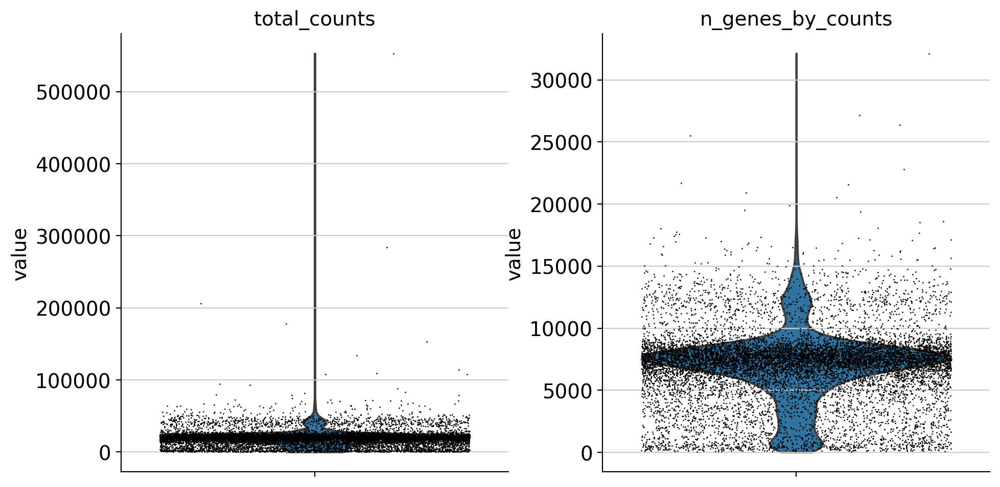

In [ ]:
sc.pl.violin(atac, ['total_counts', 'n_genes_by_counts'], jitter=0.4, multi_panel=True)

## Filter peaks which expression is not detected:

In [ ]:
mu.pp.filter_var(atac, 'n_cells_by_counts', lambda x: x >= 10)
# This is analogous to
#   sc.pp.filter_genes(rna, min_cells=10)
# but does in-place filtering and avoids copying the object

## Filter cells:

In [ ]:
mu.pp.filter_obs(atac, 'n_genes_by_counts', lambda x: (x >= 2000) & (x <= 15000))
# This is analogous to
#   sc.pp.filter_cells(atac, max_genes=15000)
#   sc.pp.filter_cells(atac, min_genes=2000)
# but does in-place filtering avoiding copying the object

mu.pp.filter_obs(atac, 'total_counts', lambda x: (x >= 4000) & (x <= 40000))

## Let’s see how the data looks after filtering:

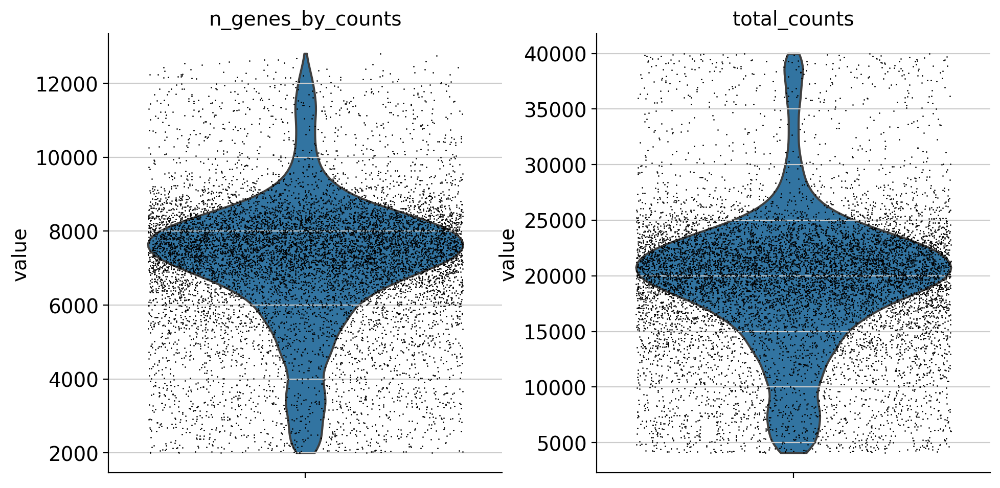

In [ ]:
sc.pl.violin(atac, ['n_genes_by_counts', 'total_counts'], jitter=0.4, multi_panel=True)

## Or on histograms:

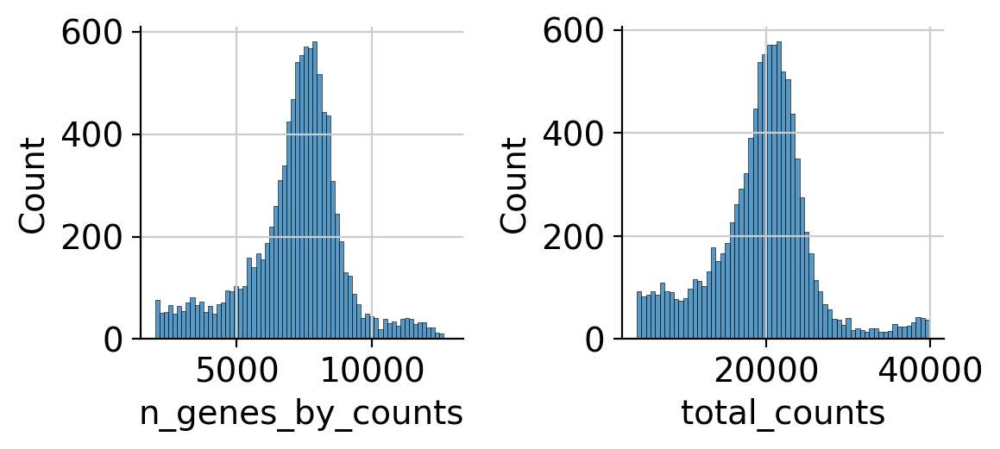

In [ ]:
mu.pl.histogram(atac, ['n_genes_by_counts', 'total_counts'])

## ATAC-specific QC
There are a few expectations about how ATAC-seq data looks like as noted in the hitchhiker’s guide to ATAC-seq data analysis for instance.

### Nucleosome signal
Fragment size distribution typically reflects nucleosome binding pattern showing enrichment around values corresponding to fragments bound to a single nucleosome (between 147 bp and 294 bp) as well as nucleosome-free fragments (shorter than 147 bp).

In [ ]:
atac.obs['NS']=1

In [ ]:
mdata

MuData object with n_obs × n_vars = 11898 × 37672
  var:	'gene_ids', 'feature_types', 'genome', 'interval', 'n_cells'
  2 modalities
    rna:	11505 x 1654
      obs:	'all368eqtl_gexdiff0721_0', 'all368eqtl_gexdiff0721_1', 'all368eqtl_gexdiff0721_2', 'all368eqtl_gexdiff0721_3', 'all368eqtl_gexdiff0721_4', 'all368eqtl_gexdiff0721_5', 'all368eqtl_gexdiff0721_6', 'all368eqtl_gexdiff0721_7', 'all368eqtl_gexdiff0721_8', 'all368eqtl_gexdiff0721_9', 'all368eqtl_gexdiff0721_10', 'all368eqtl_gexdiff0721_11', 'all368eqtl_gexdiff0721_12', 'all368eqtl_gexdiff0721_13', 'all368eqtl_gexdiff0721_14', 'all368eqtl_gexdiff0721_15', 'all368eqtl_gexdiff0721_16', 'all368eqtl_gexdiff0721_17', 'all368eqtl_gexdiff0721_18', 'all368eqtl_gexdiff0721_19', 'all368eqtl_gexdiff0721_20', 'all368eqtl_gexdiff0721_21', 'all368eqtl_gexdiff0721_22', 'all368eqtl_gexdiff0721_23', 'all368eqtl_gexdiff0721_24', 'all368eqtl_gexdiff0721_25', 'all368eqtl_gexdiff0721_26', 'all368eqtl_gexdiff0721_27', 'all368eqtl_gexdiff0721_28', 'all368eqtl_gexdiff0721_29', 'all368eqtl_gexdiff0721_30', 'all368eqtl_gexdiff0721_31', 'all368eqtl_gexdiff0721_32', 'all368eqtl_gexdiff0721_33', 'all368eqtl_gexdiff0721_34', 'all368eqtl_gexdiff0721_35', 'all368eqtl_gexdiff0721_36', 'all368eqtl_gexdiff0721_37', 'all368eqtl_gexdiff0721_38', 'all368eqtl_gexdiff0721_39', 'all368eqtl_gexdiff0721_40', 'all368eqtl_gexdiff0721_41', 'all368eqtl_gexdiff0721_42', 'all368eqtl_gexdiff0721_43', 'all368eqtl_gexdiff0721_44', 'all368eqtl_gexdiff0721_45', 'all368eqtl_gexdiff0721_46', 'all368eqtl_gexdiff0721_47', 'all368eqtl_gexdiff0721_48', 'all368eqtl_gexdiff0721_49', 'all368eqtl_gexdiff0721_50', 'all368eqtl_gexdiff0721_51', 'all368eqtl_gexdiff0721_52', 'all368eqtl_gexdiff0721_53', 'all368eqtl_gexdiff0721_54', 'all368eqtl_gexdiff0721_55', 'all368eqtl_gexdiff0721_56', 'all368eqtl_gexdiff0721_57', 'all368eqtl_gexdiff0721_58', 'all368eqtl_gexdiff0721_59', 'all368eqtl_gexdiff0721_60', 'all368eqtl_gexdiff0721_61', 'all368eqtl_gexdiff0721_62', 'all368eqtl_gexdiff0721_63', 'all368eqtl_gexdiff0721_64', 'all368eqtl_gexdiff0721_65', 'all368eqtl_gexdiff0721_66', 'all368eqtl_gexdiff0721_67', 'all368eqtl_gexdiff0721_68', 'all368eqtl_gexdiff0721_69', 'all368eqtl_gexdiff0721_70', 'all368eqtl_gexdiff0721_71', 'all368eqtl_gexdiff0721_72', 'all368eqtl_gexdiff0721_73', 'all368eqtl_gexdiff0721_74', 'all368eqtl_gexdiff0721_75', 'all368eqtl_gexdiff0721_76', 'all368eqtl_gexdiff0721_77', 'all368eqtl_gexdiff0721_78', 'all368eqtl_gexdiff0721_79', 'all368eqtl_gexdiff0721_80', 'all368eqtl_gexdiff0721_81', 'all368eqtl_gexdiff0721_82', 'all368eqtl_gexdiff0721_83', 'all368eqtl_gexdiff0721_84', 'all368eqtl_gexdiff0721_85', 'all368eqtl_gexdiff0721_86', 'all368eqtl_gexdiff0721_87', 'all368eqtl_gexdiff0721_88', 'all368eqtl_gexdiff0721_89', 'all368eqtl_gexdiff0721_90', 'all368eqtl_gexdiff0721_91', 'all368eqtl_gexdiff0721_92', 'all368eqtl_gexdiff0721_93', 'all368eqtl_gexdiff0721_94', 'all368eqtl_gexdiff0721_95', 'all368eqtl_gexdiff0721_96', 'all368eqtl_gexdiff0721_97', 'all368eqtl_gexdiff0721_98', 'all368eqtl_gexdiff0721_99', 'all368eqtl_gexdiff0721_100', 'all368eqtl_gexdiff0721_101', 'all368eqtl_gexdiff0721_102', 'all368eqtl_gexdiff0721_103', 'all368eqtl_gexdiff0721_104', 'all368eqtl_gexdiff0721_105', 'all368eqtl_gexdiff0721_106', 'all368eqtl_gexdiff0721_107', 'all368eqtl_gexdiff0721_108', 'all368eqtl_gexdiff0721_109', 'all368eqtl_gexdiff0721_110', 'all368eqtl_gexdiff0721_111', 'all368eqtl_gexdiff0721_112', 'all368eqtl_gexdiff0721_113', 'all368eqtl_gexdiff0721_114', 'all368eqtl_gexdiff0721_115', 'all368eqtl_gexdiff0721_116', 'all368eqtl_gexdiff0721_117', 'all368eqtl_gexdiff0721_118', 'all368eqtl_gexdiff0721_119', 'all368eqtl_gexdiff0721_120', 'all368eqtl_gexdiff0721_121', 'all368eqtl_gexdiff0721_122', 'all368eqtl_gexdiff0721_123', 'all368eqtl_gexdiff0721_124', 'all368eqtl_gexdiff0721_125', 'all368eqtl_gexdiff0721_126', 'all368eqtl_gexdiff0721_127', 'all368eqtl_gexdiff0721_128', 'all368eqtl_gexdiff0721_129', 'all368eqtl_gexdiff0721_130', 'all368eqtl_ge

Fetching Regions...: 100%|██████████| 1/1 [00:03<00:00,  3.77s/it]


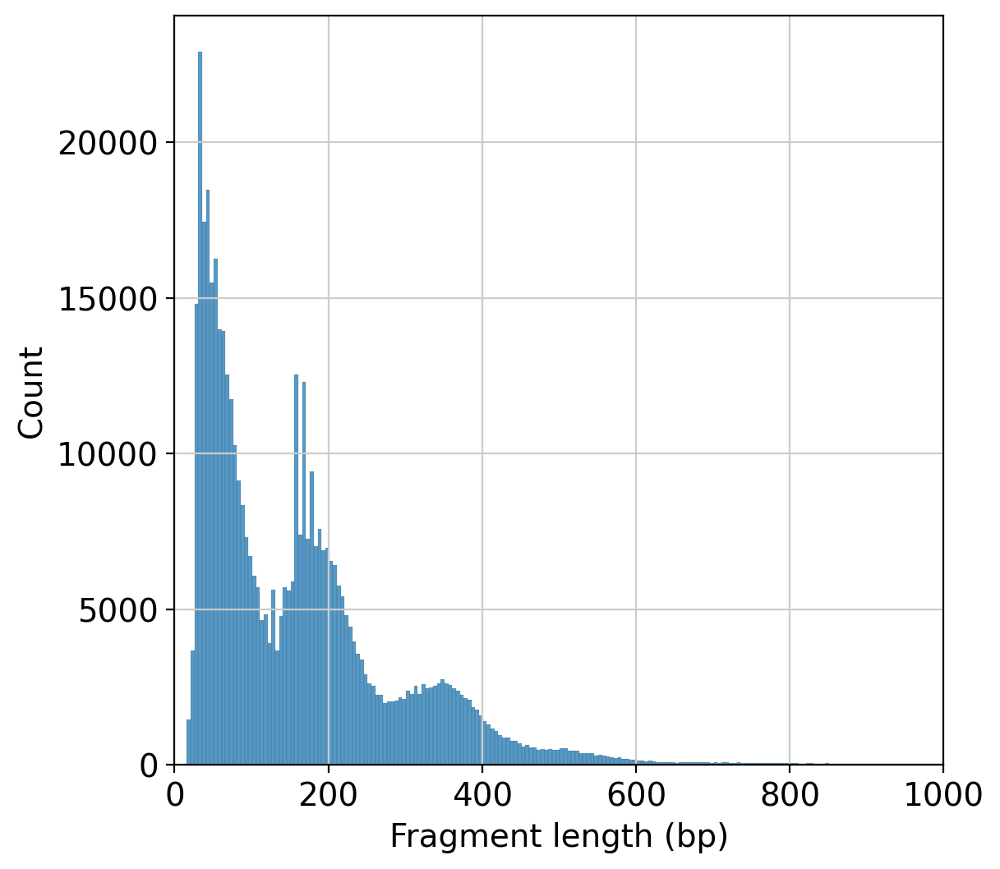

In [ ]:
ac.pl.fragment_histogram(atac, region='chr1:1-2000000')

## The ratio of mono-nucleosome cut fragments to nucleosome-free fragments can be called nucleosome signal, and it can be estimated using a subset of fragments.

In [ ]:
ac.tl.nucleosome_signal(atac, n=1e6)

Reading Fragments: 100%|██████████| 1000000/1000000 [00:06<00:00, 143179.20it/s]

Added a "nucleosome_signal" column to the .obs slot of the AnnData object


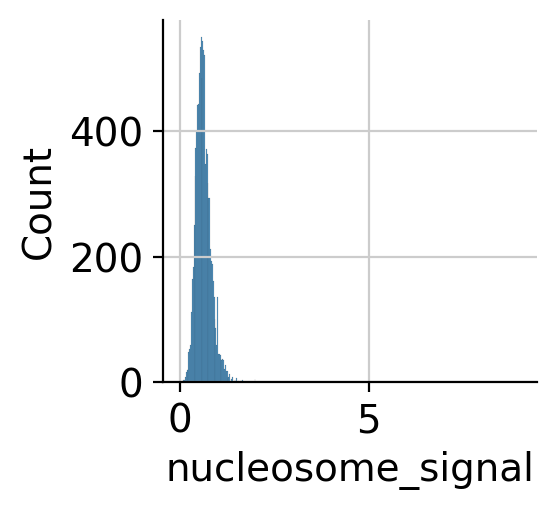

In [ ]:
mu.pl.histogram(atac, "nucleosome_signal", kde=False)

##TSS enrichment
We can expect chromatin accessibility enriched around transcription start sites (TSS) compared to accessibility of flanking regions. Thus this measure averaged across multiple genes can serve as one more quality control metric.

The positions of transcription start sites can be obtained from the interval field of the gene annotation in the rna modality:

In [ ]:
ac.tl.get_gene_annotation_from_rna(mdata['rna']).head(3)  # accepts MuData with 'rna' modality or mdata['rna'] AnnData directly

,Chromosome,Start,End,gene_id,gene_name
C1orf159,chr1,1092173,1116098,ENSG00000131591,C1orf159
SLC35E2A,chr1,1745998,1745999,ENSG00000215790,SLC35E2A
DNAJC11,chr1,6701815,6701924,ENSG00000007923,DNAJC11


TSS enrichment function will return an AnnData object with cells x bases dimensions where bases correspond to positions around TSS and are defined by extend_upstream and extend_downstream parameters, each of them being 1000 bp by default. It will also record tss_score in the original object.

In [ ]:
tss = ac.tl.tss_enrichment(mdata, n_tss=1000)  # by default, features=ac.tl.get_gene_annotation_from_rna(mdata)

Fetching Regions...: 100%|██████████| 1000/1000 [00:59<00:00, 16.67it/s]


Added a "tss_score" column to the .obs slot of tof the 'atac' modality


In [ ]:
#tss
'''
AnnData object with n_obs × n_vars = 10311 × 2001
    obs: 'all368eqtl_gexdiff0721_367','top125_eqtl_124', 'Peak762_785', 'n_genes', 'n_genes_by_counts', 'total_counts', 'NS', 'nucleosome_signal', 'tss_score'
    var: 'TSS_position'
'''

"\nAnnData object with n_obs × n_vars = 10311 × 2001\n    obs: 'all368eqtl_gexdiff0721_367','top125_eqtl_124', 'Peak762_785', 'n_genes', 'n_genes_by_counts', 'total_counts', 'NS', 'nucleosome_signal', 'tss_score'\n    var: 'TSS_position'\n"

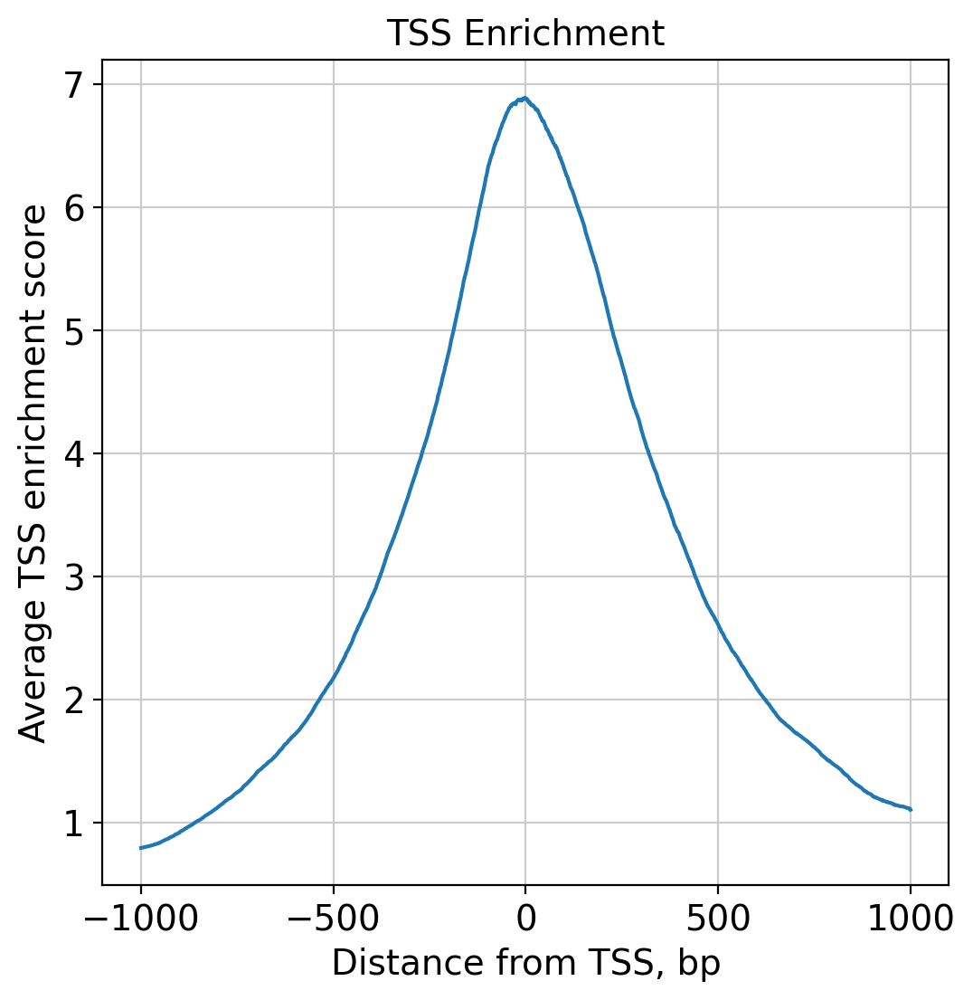

In [ ]:
ac.pl.tss_enrichment(tss)

## Normalisation

In [ ]:
# Save original counts
atac.layers["counts"] = atac.X

There can be multiple options for ATAC-seq data normalisation.

One is latent semantic indexing that is frequently used for processing ATAC-seq datasets. First, it constructs term-document matrix from the original count matrix. Then the singular value decomposition (SVD) — the same technique that convential principal component analysis uses — is used to generate LSI components. Note that there are different flavours of computing TF-IDF, e.g. see this blog post about that.

TF-IDF normalisation is implemented in the muon’s ATAC module:

In [ ]:
ac.pp.tfidf(atac, scale_factor=1e4)

Here we will use the same log-normalisation and PCA that we are used to from scRNA-seq analysis. We notice on this data it yields PC & UMAP spaces similar to the one generated on scRNA-seq counts.

In [ ]:
sc.pp.normalize_per_cell(atac, counts_per_cell_after=1e4)
sc.pp.log1p(atac)

normalizing by total count per cell
    finished (0:00:02): normalized adata.X and added    'n_counts', counts per cell before normalization (adata.obs)


Feature selection

We will label highly variable peaks that we’ll use for downstream analysis.

In [ ]:
sc.pp.highly_variable_genes(atac, min_mean=0.05, max_mean=1.5, min_disp=.5)

extracting highly variable genes
    finished (0:00:09)


In [ ]:
#sc.pl.highly_variable_genes(atac)

In [ ]:
np.sum(atac.var.highly_variable)

11269

## Scaling
For uniformity, and for consequent visualisation, we’ll save log-transformed counts in a .raw slot:

In [ ]:
atac.raw = atac

##Analysis
After filtering out low-quality cells, normalising the counts matrix, and selecting highly varianbe peaks, we can already use this data for multimodal integration.

However, as in the case of gene expression, we will study this data individually first and will run PCA on the scaled matrix, compute cell neighbourhood graph, and perform clustering to define cell types. This might be useful later to compare cell type definition between modalities.

##LSI
When working on TF-IDF counts, sc.tl.pca or ac.tl.lsi can be used to get latent components, e.g.:

In [ ]:
ac.tl.lsi(atac)

Performing SVD


We find the first component is typically associated with number of peaks or counts per cell so it is reasonable to remove it:

In [ ]:
atac.obsm['X_lsi'] = atac.obsm['X_lsi'][:,1:]
atac.varm["LSI"] = atac.varm["LSI"][:,1:]
atac.uns["lsi"]["stdev"] = atac.uns["lsi"]["stdev"][1:]

The respective neighbourhood graph can be generated with sc.tl.neighbors:

In [ ]:
sc.pp.neighbors(atac, use_rep="X_lsi", n_neighbors=10, n_pcs=30)

computing neighbors
    finished (0:00:01)


##PCA
For this notebook, we are using PCA on the log-normalised counts in atac.X as described above.

In [ ]:
sc.pp.scale(atac)
sc.tl.pca(atac)

... as `zero_center=True`, sparse input is densified and may lead to large memory consumption
computing PCA
    on highly variable genes
    with n_comps=50
    finished (0:01:03)


We can only colour our plots by cut counts in individual peaks with scanpy:

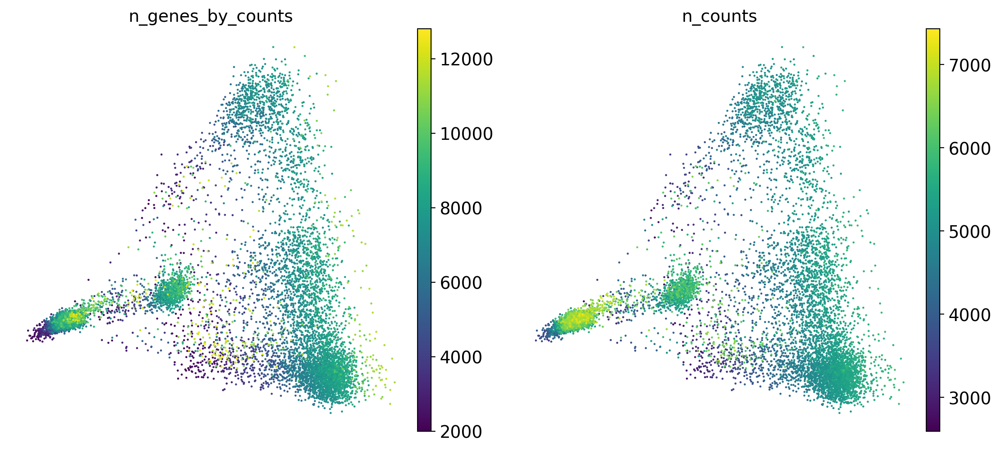

In [ ]:
sc.pl.pca(atac, color=["n_genes_by_counts", "n_counts"])

With muon’s ATAC module, we can plot average values for cut counts in peaks of different types (promoter/distal) that are assigned to respective genes — just by providing gene names.

For that to work, we need the peak annotation table with gene -> peak correspondence. The peak_annotation.tsv file was detected and loaded automatically when we loaded the original data. Here is how the processed peak annotation table looks like:

In [ ]:
atac.uns['atac']['peak_annotation'].tail()

# Alternatively add peak annotation from a TSV file
# ac.tl.add_peak_annotation(atac, annotation="data/pbmc10k/atac_peak_annotation.tsv")

,peak,distance,peak_type
gene_name,,,
AC213203.2,KI270713.1:21434-22340,10188,distal
AC213203.2,KI270713.1:26201-26826,5702,distal
AC213203.2,KI270713.1:29624-30457,2071,distal
AC213203.2,KI270713.1:31340-32243,285,distal
AC213203.1,KI270713.1:36927-37836,1521,distal


Now we can plot average cut values in peaks corresponding to genes just by providing a gene name. By default, values in atac.raw are used for plotting.

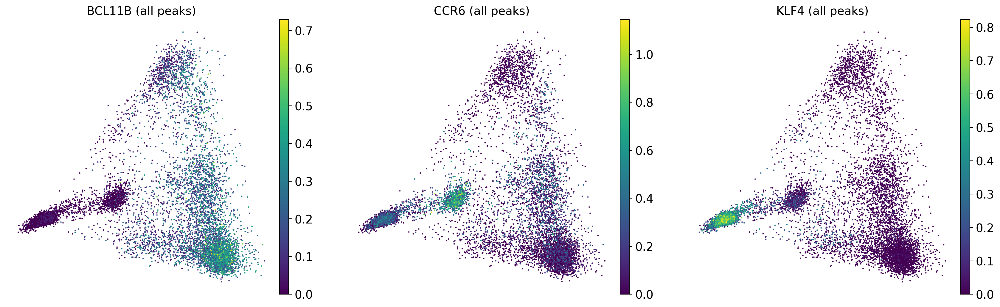

In [ ]:
ac.pl.pca(atac, color=["BCL11B", "CCR6", "KLF4"], average="total")

We can also average peaks of each type separately:

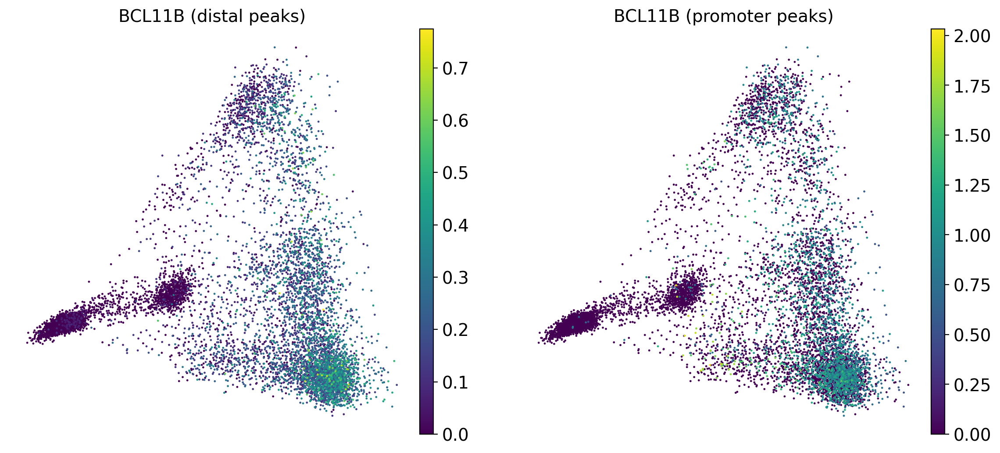

In [ ]:
ac.pl.pca(atac, color="BCL11B", average="peak_type")

We see how this component space here resembles the one based on gene expression from the previous notebook. Looking at top loadings of first two components, we see how peaks linked to BCL11B (ENSG00000127152) and KLF4 (ENSG00000136826) demarcate lympohoid / myeloid axis while peaks linked to CCR6 (ENSG00000112486) define B cell axis.

Now we will compute a neighbourhood graph for cells that we’ll use for clustering later on.

In [ ]:
sc.pp.neighbors(atac, n_neighbors=10, n_pcs=30)

computing neighbors
    using 'X_pca' with n_pcs = 30
    finished (0:00:01)


Non-linear dimensionality reduction and clustering
To stay comparable to the gene expression notebook, we will use leiden to cluster cells.

In [ ]:
sc.tl.leiden(atac, resolution=0.5) #0.5

running Leiden clustering
    finished (0:00:03)


We’ll use UMAP latent space for visualisation below.

In [ ]:
sc.tl.umap(atac, spread=1.5, min_dist=.5, random_state=20)

computing UMAP
    finished (0:00:09)


/usr/local/lib/python3.10/dist-packages/scanpy/plotting/_tools/scatterplots.py:392: UserWarning: No data for colormapping provided via 'c'. Parameters 'cmap' will be ignored
  cax = scatter(


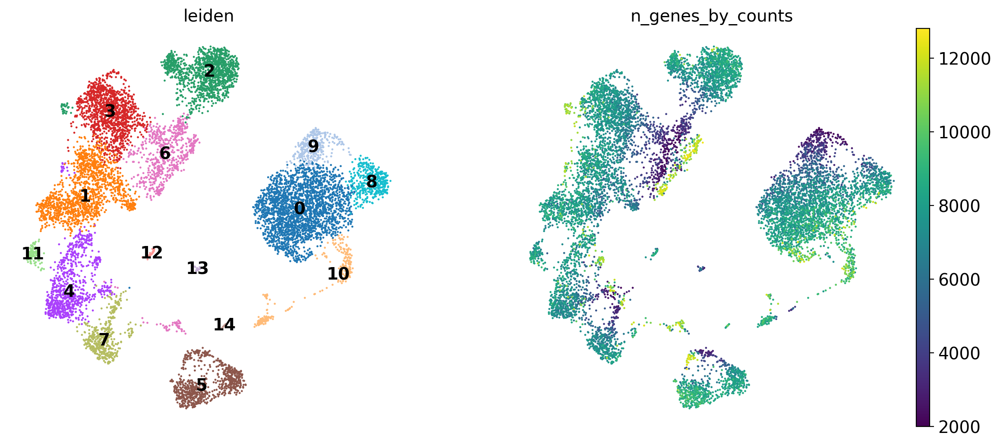

In [ ]:
sc.pl.umap(atac, color=["leiden", "n_genes_by_counts"], legend_loc="on data")

Again, we can use the functionality of the ATAC module in muon to color plots by cut values in peaks correspoonding to a certain gene:

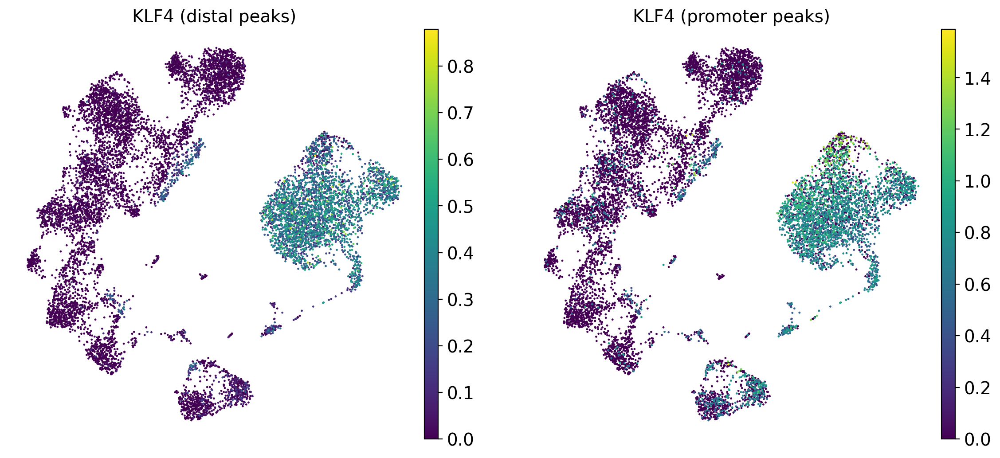

In [ ]:
ac.pl.umap(atac, color=["KLF4"], average="peak_type")

##Marker genes and celltypes
We will now define cell types based on chromatin accessibility.

In [ ]:
ac.tl.rank_peaks_groups(atac, 'leiden', method='t-test')

ranking genes
    finished (0:00:13)


In [ ]:
atac_result = atac.uns['rank_genes_groups']
atac_groups = atac_result['names'].dtype.names
#pd.set_option("max_columns", 50)
pd.DataFrame(
    {group + '_' + key[:1]: atac_result[key][group]
    for group in atac_groups for key in ['names', 'genes', 'pvals']}).head(10)

,0_n,0_g,0_p,1_n,1_g,1_p,2_n,2_g,2_p,3_n,...,11_p,12_n,12_g,12_p,13_n,13_g,13_p,14_n,14_g,14_p
0,chr6:44058491-44059286,"AL109615.3, AL109615.2",0.0,chr12:119988563-119989459,BICDL1,6.718145e-144,chr19:50724554-50725472,CLEC11A,2.974596e-232,chr17:82126427-82127355,...,2.318640e-25,chr22:39090298-39091193,APOBEC3H,2.013070e-08,chr19:11374450-11375385,"AC024575.1, SWSAP1",1.646838e-07,chr19:16118283-16119135,RAB8A,1.081160e-08
1,chr9:107489462-107490358,KLF4,0.0,chr1:6460081-6460949,"ESPN, TNFRSF25",8.894191e-128,chr17:82126427-82127355,CCDC57,6.877015e-190,chr12:119988563-119989459,...,1.403444e-24,chr22:50469601-50470492,SBF1,1.750557e-06,chr5:138542910-138543803,ETF1,1.213524e-06,chr15:76904950-76905849,SCAPER,4.319101e-07
2,chr17:78198669-78199594,AFMID,0.0,chr21:45224239-45225152,"ADARB1, LINC00334",1.886759e-125,chr12:10554267-10555223,LINC02446,4.098515e-176,chr2:109031552-109032479,...,4.509575e-23,chr8:122798738-122799649,"ZHX2, AC016405.1",1.858928e-06,chr8:25458286-25459168,KCTD9,1.585321e-06,chr14:88792404-88793282,EML5,1.392397e-06
3,chr9:129776910-129777834,PTGES,0.0,chr15:69468218-69469133,DRAIC,6.971022e-124,chr2:109031552-109032479,EDAR,1.105403e-158,chr11:60985915-60986810,...,6.621294e-23,chr16:88455957-88456658,ZFPM1,4.926895e-06,chr1:26541745-26542702,RPS6KA1,1.773909e-06,chr1:230978508-230979419,"ARV1, TTC13",2.242664e-06
4,chr9:134371498-134372350,RXRA,0.0,chr2:9781916-9782827,AC082651.3,4.371576e-112,chr2:86785399-86785901,CD8A,2.754123e-150,chr21:45642946-45643869,...,4.219627e-22,chr7:38232662-38233545,TRGC2,5.446697e-06,chr6:146543189-146544101,RAB32,2.033835e-06,chr8:125429538-125430432,TRIB1,2.801264e-06
5,chr6:13302534-13303462,AL008729.1,0.0,chr10:33138872-33139772,IATPR,3.553242e-108,chr3:18444913-18445737,SATB1-AS1,7.978197e-153,chr5:134086684-134087600,...,4.989260e-22,chr4:185203565-185204456,"CFAP97, SNX25",7.036653e-06,chr15:58247974-58248849,ALDH1A2,2.638010e-06,chr7:7944448-7945363,"UMAD1, AC006042.4",3.459680e-06
6,chr19:47388776-47389731,MEIS3,0.0,chr14:64755603-64756516,"PLEKHG3, SPTB",2.746773e-100,chr11:66317684-66318522,"CD248, AP001107.3",8.182040e-151,chr8:19496791-19497680,...,1.905518e-20,chr16:11560420-11561286,LITAF,7.196386e-06,chr1:234974914-234975817,AL391832.3,2.769759e-06,chr7:7968313-7969147,"GLCCI1, AC006042.2",4.802531e-06
7,chr20:50274666-50275585,SMIM25,0.0,chr17:82126427-82127355,CCDC57,2.308357e-101,chr2:96962497-96963371,FAM178B,2.956663e-143,chr4:152100263-152101137,...,5.369356e-20,chr7:151408590-151409495,"WDR86-AS1, WDR86",9.897134e-06,chr10:133278531-133279358,"ADAM8, TUBGCP2",4.527832e-06,chr17:69326782-69327696,ABCA5,7.737145e-06
8,chr14:50038384-50039272,LINC01588,0.0,chr19:49500594-49501497,RPS11,2.681950e-101,chr7:138752293-138753209,ATP6V0A4,2.419041e-144,chr1:59814294-59815194,...,3.048130e-19,chr2:28347819-28348710,AC093690.1,1.059536e-05,chr2:9555440-9556353,"ADAM17, AC073195.1",4.645437e-06,chr4:75940715-75941248,NAAA,1.008530e-05
9,chr17:78442407-78443323,"DNAH17-AS1, DNAH17",0.0,chr14:91245825-91246653,"GPR68, AL135818.1",4.908391e-99,chr8:100809339-100810232,PABPC1,1.211733e-142,chr6:137823785-137824707,...,3.853786e-19,chr14:68685279-68686190,"RAD51B, AL121820.1",2.278194e-05,chr10:12265520-12266351,AL512770.1,5.127259e-06,chr22:22935290-22936188,IGLC7,1.584715e-05


Having studied markers of individual clusters, we will filter some cells out before assigning cell types names to clusters: likely doublets in clusters 10 and 14, proliferating cells in 15, stressed cells in 16.

In [ ]:
mu.pp.filter_obs(atac, "leiden", lambda x: ~x.isin(["10", "14", "15", "16"]))
# Analogous to
#   atac = atac[~atac.obs.leiden.isin(["10", "14", "15", "16"])]
# but doesn't copy the object

In [ ]:
new_cluster_names = {
    "1": "CD4+ memory T",
    "2": "CD8+ naïve T",
    "3": "CD4+ naïve T",
    "5": "CD8+ activated T",
    "8": "NK",
    "12": "MAIT",
    "9": "naïve B",
    "6": "memory B",
    "0": "intermediate mono",
    "4": "CD14 mono",
    "7": "CD16 mono",
    "11": "mDC",
    "13": "pDC",
}

atac.obs['celltype'] = atac.obs.leiden.astype("str").values
atac.obs.celltype = atac.obs.celltype.astype("category").cat.rename_categories(new_cluster_names)

We will also re-order categories for the next plots:

In [ ]:
atac.obs.celltype.cat.reorder_categories([
    'CD4+ naïve T', 'CD4+ memory T', 'MAIT',
    'CD8+ naïve T', 'CD8+ activated T', 'NK',
    'naïve B', 'memory B',
    'CD14 mono', 'intermediate mono', 'CD16 mono',
    'mDC', 'pDC'], inplace=True)

<ipython-input-177-3a60d55ff116>:1: FutureWarning: The `inplace` parameter in pandas.Categorical.reorder_categories is deprecated and will be removed in a future version. Reordering categories will always return a new Categorical object.
  atac.obs.celltype.cat.reorder_categories([


… and take colours from a palette:

In [ ]:
import matplotlib
import matplotlib.pyplot as plt

cmap = plt.get_cmap('rainbow')
colors = cmap(np.linspace(0, 1, len(atac.obs.celltype.cat.categories)))

atac.uns["celltype_colors"] = list(map(matplotlib.colors.to_hex, colors))

In [ ]:
#sc.pl.umap(atac, color="celltype", legend_loc="on data", frameon=False)

Finally, we’ll visualise some marker genes across cell types.

In [ ]:
marker_genes = ['IL7R', 'TRAC',
                'GATA3',
                'SLC4A10',
                'CD8A', 'CD8B', 'CD248', 'CCL5',
                'GNLY', 'NKG7',
                'CD79A', 'MS4A1', 'IGHD', 'IGHM', 'TNFRSF13C',
                'IL4R', 'KLF4', 'LYZ', 'S100A8', 'ITGAM', 'CD14',
                'FCGR3A', 'MS4A7', 'CST3',
                'CLEC10A', 'IRF8', 'TCF4']

In [ ]:
#ac.pl.dotplot(atac, marker_genes, groupby='celltype')

##Saving progress on disk
In this chapter, we have been working on the ATAC modality only. We can save our progress into the .h5mu file. That will only update the ATAC modality inside the file.

In [ ]:
mu.write('./write/pbmc10k.h5mu/atac', atac)

In [ ]:
mdata.write('./write/pbmc10k.h5mu')

/usr/local/lib/python3.10/dist-packages/anndata/_core/anndata.py:1230: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df[key] = c


Next, we’ll look into multimodal omics data integration.

# CellO
## scRNA Cell ontology-based automatic cell type prediction with CellO

In [ ]:
! sudo apt-get -y install libgraphviz-dev
! sudo apt-get -y install graphviz
! pip install --no-input -U cello-classify --no-cache

Reading package lists... Done
Building dependency tree... Done
Reading state information... Done
The following additional packages will be installed:
  libgail-common libgail18 libgtk2.0-0 libgtk2.0-bin libgtk2.0-common
  libgvc6-plugins-gtk librsvg2-common libxdot4
Suggested packages:
  gvfs
The following NEW packages will be installed:
  libgail-common libgail18 libgraphviz-dev libgtk2.0-0 libgtk2.0-bin
  libgtk2.0-common libgvc6-plugins-gtk librsvg2-common libxdot4
0 upgraded, 9 newly installed, 0 to remove and 16 not upgraded.
Need to get 2,433 kB of archives.
After this operation, 7,694 kB of additional disk space will be used.
Get:1 http://archive.ubuntu.com/ubuntu jammy/main amd64 libgtk2.0-common all 2.24.33-2ubuntu2 [125 kB]
Get:2 http://archive.ubuntu.com/ubuntu jammy/main amd64 libgtk2.0-0 amd64 2.24.33-2ubuntu2 [2,037 kB]
Get:3 http://archive.ubuntu.com/ubuntu jammy/main amd64 libgail18 amd64 2.24.33-2ubuntu2 [15.9 kB]
Get:4 http://archive.ubuntu.com/ubuntu jammy/main amd64

In [ ]:
import os
import cello

##  "recall" the raw data to adata again; we'll need the lists of retained cells and genes for the downstream analysis, but we'll do the normalization and variable gene selection from the scratch.

In [ ]:
radata = ad_rna.raw.to_adata()
#aadata # AnnData object with n_obs × n_vars = 11505 × 8738
'''
    var: 'gene_ids', 'feature_types', 'genome', 'n_cells', 'mt', 'n_cells_by_counts', 'mean_counts', 'pct_dropout_by_counts', 'total_counts', 'highly_variable', 'means', 'dispersions', 'dispersions_norm'
    uns: 'hvg', 'leiden', 'leiden_colors', 'log1p', 'neighbors', 'pca', 'rank_genes_groups', 'top125_eqtl_0_colors', 'umap'
    obsm: 'X_pca', 'X_umap'
    obsp: 'connectivities', 'distances'
'''

"\n    var: 'gene_ids', 'feature_types', 'genome', 'n_cells', 'mt', 'n_cells_by_counts', 'mean_counts', 'pct_dropout_by_counts', 'total_counts', 'highly_variable', 'means', 'dispersions', 'dispersions_norm'\n    uns: 'hvg', 'leiden', 'leiden_colors', 'log1p', 'neighbors', 'pca', 'rank_genes_groups', 'top125_eqtl_0_colors', 'umap'\n    obsm: 'X_pca', 'X_umap'\n    obsp: 'connectivities', 'distances'\n"

In [ ]:
#new_adata = sc.read_10x_mtx('../data/soupX_pbmc10k_filt', cache = True)
'''
new_adata = sc.read_10x_h5('/content/data/pbmc10k_filtered_feature_bc_matrix.h5', gex_only=False)
new_adata
'''

"\nnew_adata = sc.read_10x_h5('/content/data/pbmc10k_filtered_feature_bc_matrix.h5', gex_only=False)\nnew_adata\n"

In [ ]:
radata.obs_names

Index(['AAACAGCCAAGGAATC-1', 'AAACAGCCAATCCCTT-1', 'AAACAGCCAATGCGCT-1',
       'AAACAGCCACACTAAT-1', 'AAACAGCCACCAACCG-1', 'AAACAGCCAGGATAAC-1',
       'AAACAGCCAGTAGGTG-1', 'AAACAGCCAGTTTACG-1', 'AAACAGCCATCCAGGT-1',
       'AAACATGCAAGGTCCT-1',
       ...
       'TTTGTGTTCTCCATAT-1', 'TTTGTTGGTCAGGAAG-1', 'TTTGTTGGTCCACAAA-1',
       'TTTGTTGGTCTTTATG-1', 'TTTGTTGGTGACATGC-1', 'TTTGTTGGTGTTAAAC-1',
       'TTTGTTGGTTAGGATT-1', 'TTTGTTGGTTGCAGTA-1', 'TTTGTTGGTTGGTTAG-1',
       'TTTGTTGGTTTGCAGA-1'],
      dtype='object', length=11505)

In [ ]:
radata.var_names

Index(['LINC01409', 'NOC2L', 'HES4', 'ISG15', 'C1orf159', 'SDF4', 'UBE2J2',
       'ACAP3', 'INTS11', 'AURKAIP1',
       ...
       'MT-ATP8', 'MT-ATP6', 'MT-CO3', 'MT-ND3', 'MT-ND4L', 'MT-ND4', 'MT-ND5',
       'MT-ND6', 'MT-CYB', 'AL592183.1'],
      dtype='object', length=8738)

In [ ]:
# 檢查並去除重複的觀測名稱和變數名稱
unique_obs_names = pd.Index(radata.obs_names).drop_duplicates()
unique_var_names = pd.Index(radata.var_names).drop_duplicates()

# 創建新的AnnData對象
new_adata = radata[unique_obs_names, unique_var_names]
#new_adata # AnnData object with n_obs × n_vars = 11505 × 8738
'''
    var: 'gene_ids', 'feature_types', 'genome', 'n_cells', 'mt', 'n_cells_by_counts', 'mean_counts', 'pct_dropout_by_counts', 'total_counts', 'highly_variable', 'means', 'dispersions', 'dispersions_norm'
    uns: 'hvg', 'leiden', 'leiden_colors', 'log1p', 'neighbors', 'pca', 'rank_genes_groups', 'top125_eqtl_0_colors', 'umap'
    obsm: 'X_pca', 'X_umap'
    obsp: 'connectivities', 'distances'
'''

"\n    var: 'gene_ids', 'feature_types', 'genome', 'n_cells', 'mt', 'n_cells_by_counts', 'mean_counts', 'pct_dropout_by_counts', 'total_counts', 'highly_variable', 'means', 'dispersions', 'dispersions_norm'\n    uns: 'hvg', 'leiden', 'leiden_colors', 'log1p', 'neighbors', 'pca', 'rank_genes_groups', 'top125_eqtl_0_colors', 'umap'\n    obsm: 'X_pca', 'X_umap'\n    obsp: 'connectivities', 'distances'\n"

In [ ]:
#new_adata

## normalize the data and find the highly variable genes - note the unusually high number of HVGs (10k). This follows the suggestion in the CellO tutorial:

In [ ]:
sc.pp.normalize_total(new_adata, target_sum=1e6) #, target_sum=1e4
sc.pp.log1p(new_adata)
sc.pp.highly_variable_genes(new_adata, n_top_genes=10000)
#sc.pp.highly_variable_genes(new_adata, n_top_genes=1654) # as final adata
#sc.pp.highly_variable_genes(new_adata, min_mean=0.0125, max_mean=3, min_disp=0.5) #these are default values
#new_adata # AnnData object with n_obs × n_vars = 11505 × 8738
'''
    var: 'gene_ids', 'feature_types', 'genome', 'n_cells', 'mt', 'n_cells_by_counts', 'mean_counts', 'pct_dropout_by_counts', 'total_counts', 'highly_variable', 'means', 'dispersions', 'dispersions_norm'
    uns: 'hvg', 'leiden', 'leiden_colors', 'log1p', 'neighbors', 'pca', 'rank_genes_groups', 'top125_eqtl_0_colors', 'umap'
    obsm: 'X_pca', 'X_umap'
    obsp: 'connectivities', 'distances'
'''

/usr/local/lib/python3.10/dist-packages/scanpy/preprocessing/_normalization.py:170: UserWarning: Received a view of an AnnData. Making a copy.
  view_to_actual(adata)


normalizing counts per cell
    finished (0:00:00)
If you pass `n_top_genes`, all cutoffs are ignored.
extracting highly variable genes
`n_top_genes` > `adata.n_var`, returning all genes.
    finished (0:00:01)


"\n    var: 'gene_ids', 'feature_types', 'genome', 'n_cells', 'mt', 'n_cells_by_counts', 'mean_counts', 'pct_dropout_by_counts', 'total_counts', 'highly_variable', 'means', 'dispersions', 'dispersions_norm'\n    uns: 'hvg', 'leiden', 'leiden_colors', 'log1p', 'neighbors', 'pca', 'rank_genes_groups', 'top125_eqtl_0_colors', 'umap'\n    obsm: 'X_pca', 'X_umap'\n    obsp: 'connectivities', 'distances'\n"

## Now let's cluster the data. Over-clustering is recommended here, for the reasons that would become clear below:

In [ ]:
sc.pp.pca(new_adata, n_comps=50, use_highly_variable=True)
sc.pp.neighbors(new_adata, n_neighbors=15)
#sc.pp.neighbors(new_adata, n_neighbors=10, n_pcs=20) # Computing the neighborhood graph
sc.tl.leiden(new_adata,resolution=2.0) #resolution=0.8,1.0,1.2
#sc.tl.leiden(new_adata)

computing PCA
    on highly variable genes
    with n_comps=50
    finished (0:01:23)
computing neighbors
    using 'X_pca' with n_pcs = 50
    finished (0:00:07)
running Leiden clustering
    finished (0:00:12)


In [ ]:
#new_adata # AnnData object with n_obs × n_vars = 11505 × 8738
'''
    var: 'gene_ids', 'feature_types', 'genome', 'n_cells', 'mt', 'n_cells_by_counts', 'mean_counts', 'pct_dropout_by_counts', 'total_counts', 'highly_variable', 'means', 'dispersions', 'dispersions_norm'
    uns: 'hvg', 'leiden', 'leiden_colors', 'log1p', 'neighbors', 'pca', 'rank_genes_groups', 'top125_eqtl_0_colors', 'umap'
    obsm: 'X_pca', 'X_umap'
    varm: 'PCs'
    obsp: 'connectivities', 'distances'
'''

"\n    var: 'gene_ids', 'feature_types', 'genome', 'n_cells', 'mt', 'n_cells_by_counts', 'mean_counts', 'pct_dropout_by_counts', 'total_counts', 'highly_variable', 'means', 'dispersions', 'dispersions_norm'\n    uns: 'hvg', 'leiden', 'leiden_colors', 'log1p', 'neighbors', 'pca', 'rank_genes_groups', 'top125_eqtl_0_colors', 'umap'\n    obsm: 'X_pca', 'X_umap'\n    varm: 'PCs'\n    obsp: 'connectivities', 'distances'\n"

## Currently, CellO only supports dense matrix format, so we need to do the transformation below. Note that it needs to be done after all Scanpy operations.

In [ ]:
new_adata.X = new_adata.X.todense()

In [ ]:
new_adata.X.shape

(11505, 8738)

## set the CellO resource directory to the dir where this notebook is located. NOTE: You will need at least 5 Gb of free disk space for the following code to work.

In [ ]:
cello_resource_loc = os.getcwd() #使用當前目錄的路徑

## Following this, we can train the model using CellO using the following command. This runs for about an hour, and will make a file called 10k_pbmc.model.dill.

model_prefix = "10k_pbmc"

cello.scanpy_cello(
    new_adata, clust_key='leiden', rsrc_loc=cello_resource_loc,
    out_prefix=model_prefix, log_dir=os.getcwd()
)

Instead, we will download a pre-made model to save time:

In [ ]:
#!wget https://www.dropbox.com/s/x8n6jxa9ygw3s1w/10k_pbmc.model.dill
import shutil
shutil.copy('/content/drive/MyDrive/scEpieQTL/resources_v2.0.0.tar.gz', '/content/resources_v2.0.0.tar.gz')
shutil.copy('/content/drive/MyDrive/scEpieQTL/10k_pbmc_rna.model.dill', '/content/10k_pbmc_rna.model.dill')
!tar -C /content -zxf resources_v2.0.0.tar.gz

In [ ]:
'''
model_prefix = "10k_pbmc_rna"
cello.scanpy_cello(
    new_adata,
    clust_key='leiden',
    rsrc_loc=cello_resource_loc,
    out_prefix=model_prefix,
    log_dir=os.getcwd()
)
'''

'\nmodel_prefix = "10k_pbmc_rna"\ncello.scanpy_cello(\n    new_adata,\n    clust_key=\'leiden\',\n    rsrc_loc=cello_resource_loc,\n    out_prefix=model_prefix,\n    log_dir=os.getcwd()\n)\n'

## Following this, we can run the cell type annotation command with a pre-made model:

In [ ]:

model_prefix = "10k_pbmc_rna" # model_prefix = "/content/drive/MyDrive/scEpieQTL/10k_pbmc"

cello.scanpy_cello(
    new_adata,
    clust_key='leiden',
    rsrc_loc=cello_resource_loc,
    model_file=f'{model_prefix}.model.dill'
)


Loading model from 10k_pbmc_rna.model.dill...
Found CellO resources at '/content/resources'.


/usr/local/lib/python3.10/dist-packages/anndata/_core/anndata.py:1840: UserWarning: Variable names are not unique. To make them unique, call `.var_names_make_unique`.
  utils.warn_names_duplicates("var")


Transforming with PCA...
done.
Making predictions for each classifier...
Running solver on item 1/29...
Running solver on item 2/29...
Running solver on item 3/29...
Running solver on item 4/29...
Running solver on item 5/29...
Running solver on item 6/29...
Running solver on item 7/29...
Running solver on item 8/29...
Running solver on item 9/29...
Running solver on item 10/29...
Running solver on item 11/29...
Running solver on item 12/29...
Running solver on item 13/29...
Running solver on item 14/29...
Running solver on item 15/29...
Running solver on item 16/29...
Running solver on item 17/29...
Running solver on item 18/29...
Running solver on item 19/29...
Running solver on item 20/29...
Running solver on item 21/29...
Running solver on item 22/29...
Running solver on item 23/29...
Running solver on item 24/29...
Running solver on item 25/29...
Running solver on item 26/29...
Running solver on item 27/29...
Running solver on item 28/29...
Running solver on item 29/29...
Checking

/usr/local/lib/python3.10/dist-packages/sklearn/base.py:318: UserWarning: Trying to unpickle estimator PCA from version 0.22.2.post1 when using version 1.2.2. This might lead to breaking code or invalid results. Use at your own risk. For more info please refer to:
https://scikit-learn.org/stable/model_persistence.html#security-maintainability-limitations
  warnings.warn(
/usr/local/lib/python3.10/dist-packages/sklearn/base.py:318: UserWarning: Trying to unpickle estimator LogisticRegression from version 0.22.2.post1 when using version 1.2.2. This might lead to breaking code or invalid results. Use at your own risk. For more info please refer to:
https://scikit-learn.org/stable/model_persistence.html#security-maintainability-limitations
  warnings.warn(


Of 8738 genes in the input file, 8384 were found in the training set of 58243 genes.
Of 8738 genes in the input file, 8242 were found in the training set of 31283 genes.
Using thresholds stored in /content/resources/trained_models/ir.10x_genes_thresholds.tsv
Binarizing classifications...
Mapping each sample to its predicted labels...
Computing the most-specific predicted labels...
Loading ontology...
Item 0 predicted to be "naive thymus-derived CD8-positive, alpha-beta T cell (CL:0000900)"
Item 1 predicted to be "CD14-positive, CD16-negative classical monocyte (CL:0002057)"
Item 10 predicted to be "professional antigen presenting cell (CL:0000145)"
Item 11 predicted to be "mononuclear cell (CL:0000842)"
Item 12 predicted to be "central memory CD8-positive, alpha-beta T cell (CL:0000907)"
Item 13 predicted to be "class switched memory B cell (CL:0000972)"
Item 14 predicted to be "natural killer cell (CL:0000623)"
Item 15 predicted to be "naive B cell (CL:0000788)"
Item 16 predicted to b

In [ ]:
#new_adata # AnnData object with n_obs × n_vars = 11505 × 8738
'''
    var: 'gene_ids', 'feature_types', 'genome', 'n_cells', 'mt', 'n_cells_by_counts', 'mean_counts', 'pct_dropout_by_counts', 'total_counts', 'highly_variable', 'means', 'dispersions', 'dispersions_norm'
    uns: 'hvg', 'leiden', 'leiden_colors', 'log1p', 'neighbors', 'pca', 'rank_genes_groups', 'top125_eqtl_0_colors', 'umap', 'CellO_column_mappings'
    obsm: 'X_pca', 'X_umap'
    varm: 'PCs'
    obsp: 'connectivities', 'distances'
'''

"\n    var: 'gene_ids', 'feature_types', 'genome', 'n_cells', 'mt', 'n_cells_by_counts', 'mean_counts', 'pct_dropout_by_counts', 'total_counts', 'highly_variable', 'means', 'dispersions', 'dispersions_norm'\n    uns: 'hvg', 'leiden', 'leiden_colors', 'log1p', 'neighbors', 'pca', 'rank_genes_groups', 'top125_eqtl_0_colors', 'umap', 'CellO_column_mappings'\n    obsm: 'X_pca', 'X_umap'\n    varm: 'PCs'\n    obsp: 'connectivities', 'distances'\n"

## Let's run UMAP and visualized the obtained clusters. Quite clearly this is too many, but it's OK:

In [ ]:
sc.tl.umap(new_adata)

computing UMAP
    finished (0:00:11)


/usr/local/lib/python3.10/dist-packages/scanpy/plotting/_tools/scatterplots.py:392: UserWarning: No data for colormapping provided via 'c'. Parameters 'cmap' will be ignored
  cax = scatter(


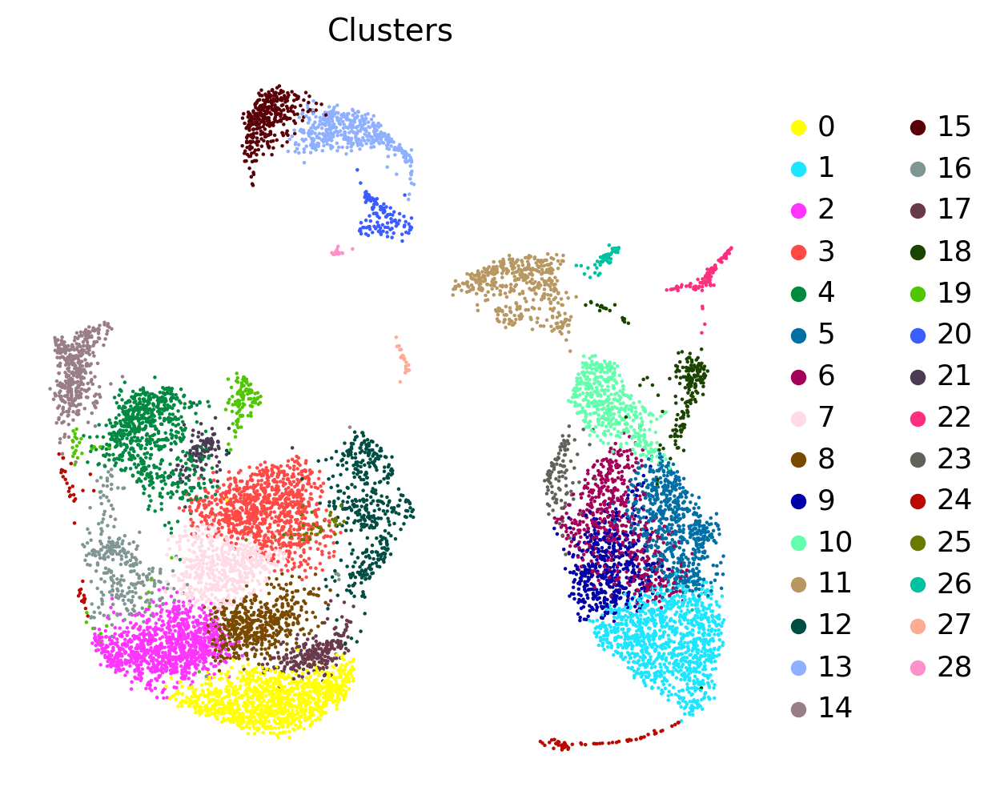

In [ ]:
fig = sc.pl.umap(new_adata, color='leiden', title='Clusters', return_fig=True, save='.png')

In [ ]:
new_adata.obs['leiden'].value_counts()

0     1101
1     1037
2     1005
3      936
4      684
5      661
6      559
7      525
8      504
9      477
10     451
11     433
12     425
13     414
14     392
15     345
16     287
17     243
18     187
19     139
20     121
21     119
22     111
23     103
24      99
25      55
26      53
27      21
28      18
Name: leiden, dtype: int64

In [ ]:
#new_adata # AnnData object with n_obs × n_vars = 11505 × 8738
'''
obs: 'all_368eqtl_gexdiff0801_367', 'top125_eqtl_124', 'n_genes', 'n_genes_by_counts', 'total_counts', 'total_counts_mt', 'pct_counts_mt',
 'leiden', ...... ,'early embryonic cell (probability)', 'cultured cell (probability)', 'central nervous system neuron (binary)',
 'Most specific cell type'
    var: 'gene_ids', 'feature_types', 'genome', 'n_cells', 'mt', 'n_cells_by_counts', 'mean_counts', 'pct_dropout_by_counts', 'total_counts',
    'highly_variable', 'means', 'dispersions', 'dispersions_norm'
    uns: 'hvg', 'leiden', 'leiden_colors', 'log1p', 'neighbors', 'pca', 'rank_genes_groups', 'top125_eqtl_0_colors', 'top125_eqtl_124_colors',
     'umap', 'CellO_column_mappings'
    obsm: 'X_pca', 'X_umap'
    varm: 'PCs'
    obsp: 'connectivities', 'distances'

'''

"\nobs: 'all_368eqtl_gexdiff0801_367', 'top125_eqtl_124', 'n_genes', 'n_genes_by_counts', 'total_counts', 'total_counts_mt', 'pct_counts_mt',\n 'leiden', ...... ,'early embryonic cell (probability)', 'cultured cell (probability)', 'central nervous system neuron (binary)',\n 'Most specific cell type'\n    var: 'gene_ids', 'feature_types', 'genome', 'n_cells', 'mt', 'n_cells_by_counts', 'mean_counts', 'pct_dropout_by_counts', 'total_counts',\n    'highly_variable', 'means', 'dispersions', 'dispersions_norm'\n    uns: 'hvg', 'leiden', 'leiden_colors', 'log1p', 'neighbors', 'pca', 'rank_genes_groups', 'top125_eqtl_0_colors', 'top125_eqtl_124_colors',\n     'umap', 'CellO_column_mappings'\n    obsm: 'X_pca', 'X_umap'\n    varm: 'PCs'\n    obsp: 'connectivities', 'distances'\n\n"

## The following example can be useful to save the plots in the pdf format:

In [ ]:
#out_file = '10k_pbmc_clusters_res2.0.pdf' # <-- Name of the output file

#fig.savefig(out_file, bbox_inches='tight', format='pdf')

## Let's visualize a most specific cell type for each cluster:

/usr/local/lib/python3.10/dist-packages/scanpy/plotting/_tools/scatterplots.py:392: UserWarning: No data for colormapping provided via 'c'. Parameters 'cmap' will be ignored
  cax = scatter(


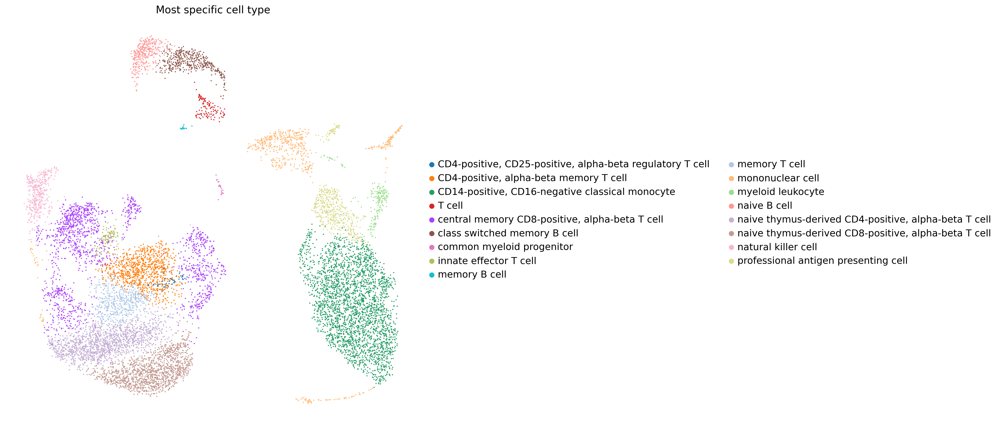

In [ ]:
import matplotlib as mpl

with mpl.rc_context({'figure.figsize': (10, 10)}):
    sc.pl.umap(new_adata, color='Most specific cell type') #,palette='jet') # palette="Paired"

/usr/local/lib/python3.10/dist-packages/scanpy/plotting/_tools/scatterplots.py:392: UserWarning: No data for colormapping provided via 'c'. Parameters 'cmap' will be ignored
  cax = scatter(


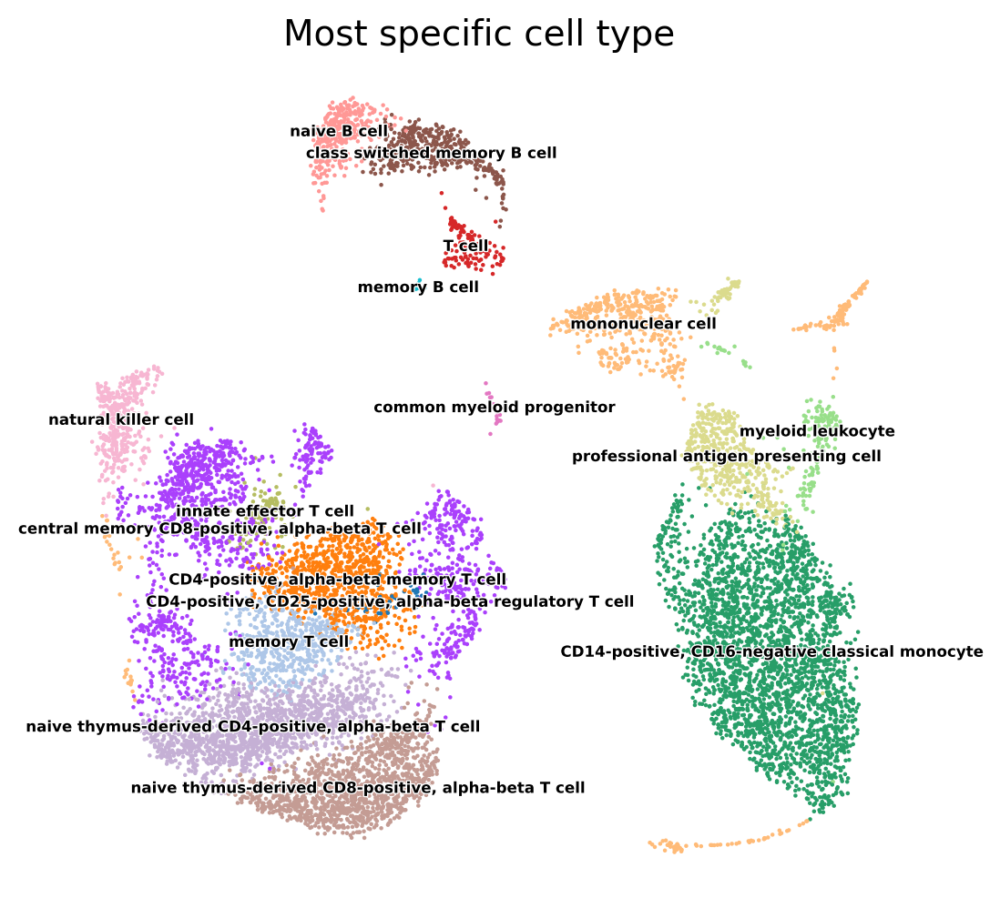

In [ ]:
sc.pl.umap(new_adata, color='Most specific cell type', legend_loc='on data', legend_fontsize=6, legend_fontoutline=1,) #,palette='jet') # palette="Paired"

In [ ]:
new_adata.obs['Most specific cell type'].value_counts()

CD14-positive, CD16-negative classical monocyte              2837
central memory CD8-positive, alpha-beta T cell               1535
naive thymus-derived CD4-positive, alpha-beta T cell         1509
naive thymus-derived CD8-positive, alpha-beta T cell         1344
CD4-positive, alpha-beta memory T cell                        936
mononuclear cell                                              643
memory T cell                                                 525
professional antigen presenting cell                          504
class switched memory B cell                                  414
natural killer cell                                           392
naive B cell                                                  345
myeloid leukocyte                                             187
T cell                                                        121
innate effector T cell                                        119
CD4-positive, CD25-positive, alpha-beta regulatory T cell      55
common mye

In [ ]:
new_adata.uns['Most specific cell type_colors']

['#1f77b4',
 '#ff7f0e',
 '#279e68',
 '#d62728',
 '#aa40fc',
 '#8c564b',
 '#e377c2',
 '#b5bd61',
 '#17becf',
 '#aec7e8',
 '#ffbb78',
 '#98df8a',
 '#ff9896',
 '#c5b0d5',
 '#c49c94',
 '#f7b6d2',
 '#dbdb8d']

## We can see that some of these assignments are wrong; for example, what's marked as "dendiritic cell" in the plot above is actually a population of non-classical monocytes (as shown by expression of FCGR3A). At the same time, what's labelled as "mononuclear cell" is in fact two populations of dendritic cells - myeloid DCs (expressing FCER1A) and plasmacytoid DCs (expressing LILRA4):

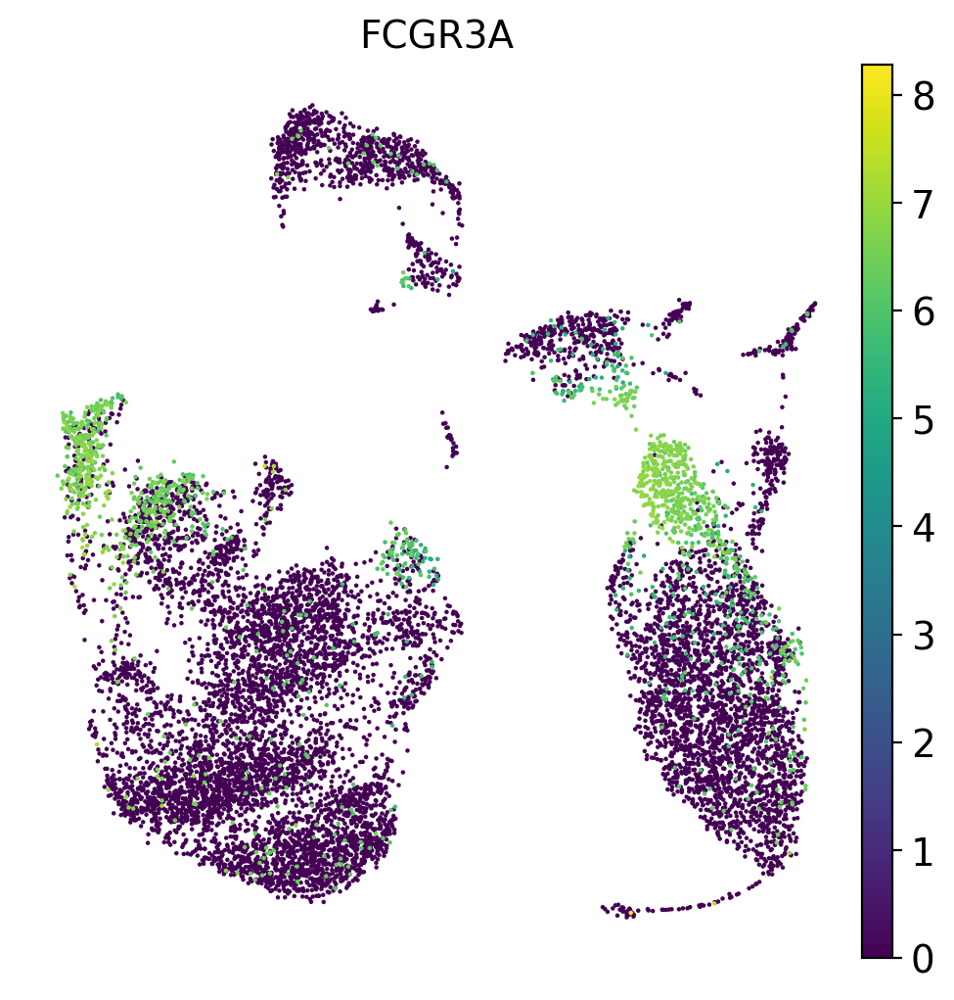

In [ ]:
sc.pl.umap(new_adata, color=["FCGR3A"]) #,"FCER1A","LILRA4"])

## Assigned probability can be used to visualize the probability of cell being a certain cell type:

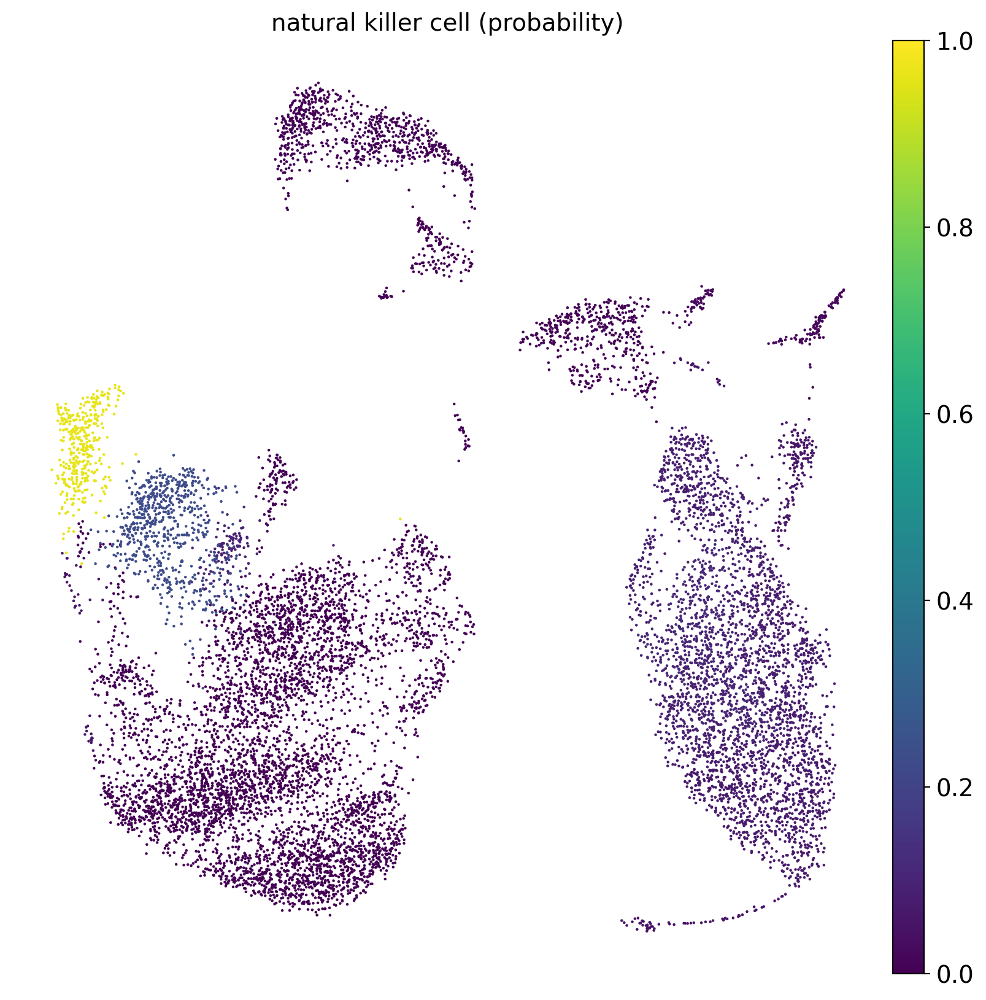

In [ ]:
with mpl.rc_context({'figure.figsize': (10, 10)}):
    sc.pl.umap(new_adata, color='natural killer cell (probability)', vmin=0.0, vmax=1.0, return_fig=True)

## We can also use more abstract ontologies, e.g. to identify nucleate cells (platelets don't have nuclei!):

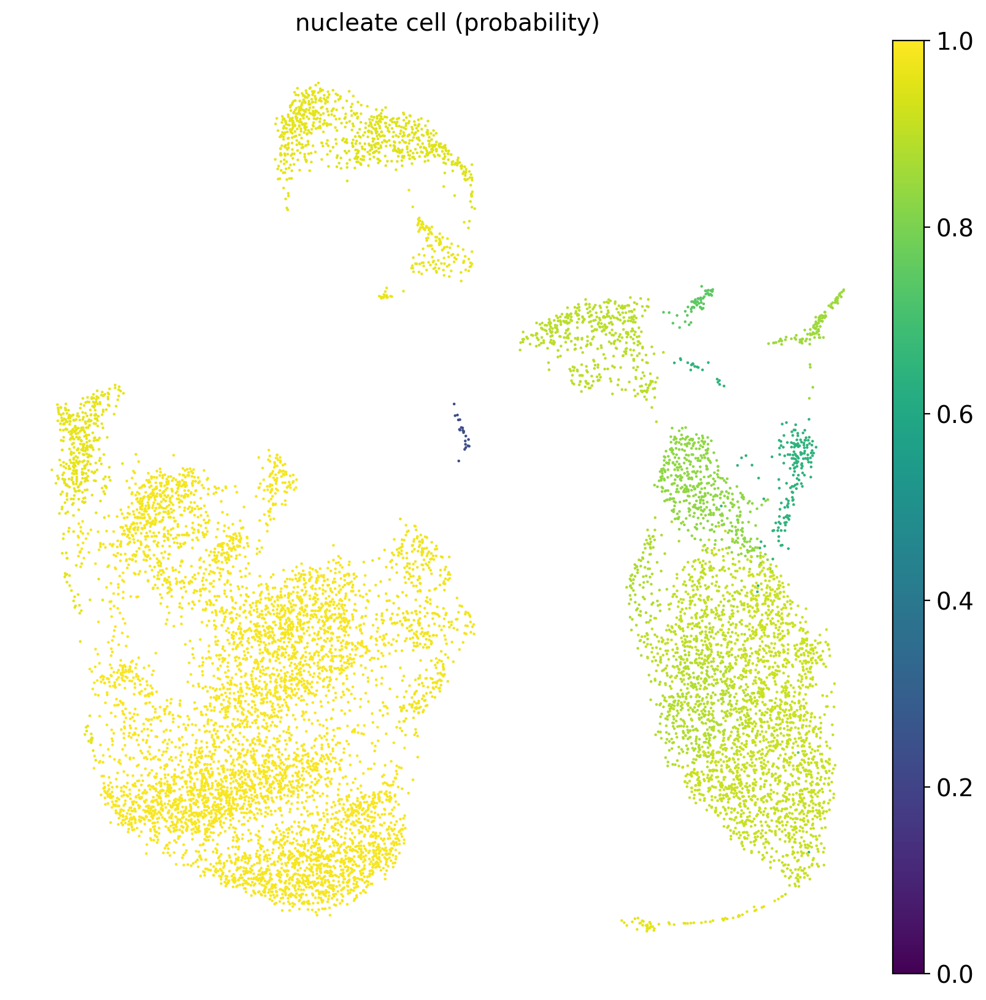

In [ ]:
with mpl.rc_context({'figure.figsize': (10, 10)}):
    sc.pl.umap(new_adata, color='nucleate cell (probability)', vmin=0.0, vmax=1.0, return_fig=True)

## Finally, we can use the result of binary classification:

/usr/local/lib/python3.10/dist-packages/scanpy/plotting/_tools/scatterplots.py:392: UserWarning: No data for colormapping provided via 'c'. Parameters 'cmap' will be ignored
  cax = scatter(


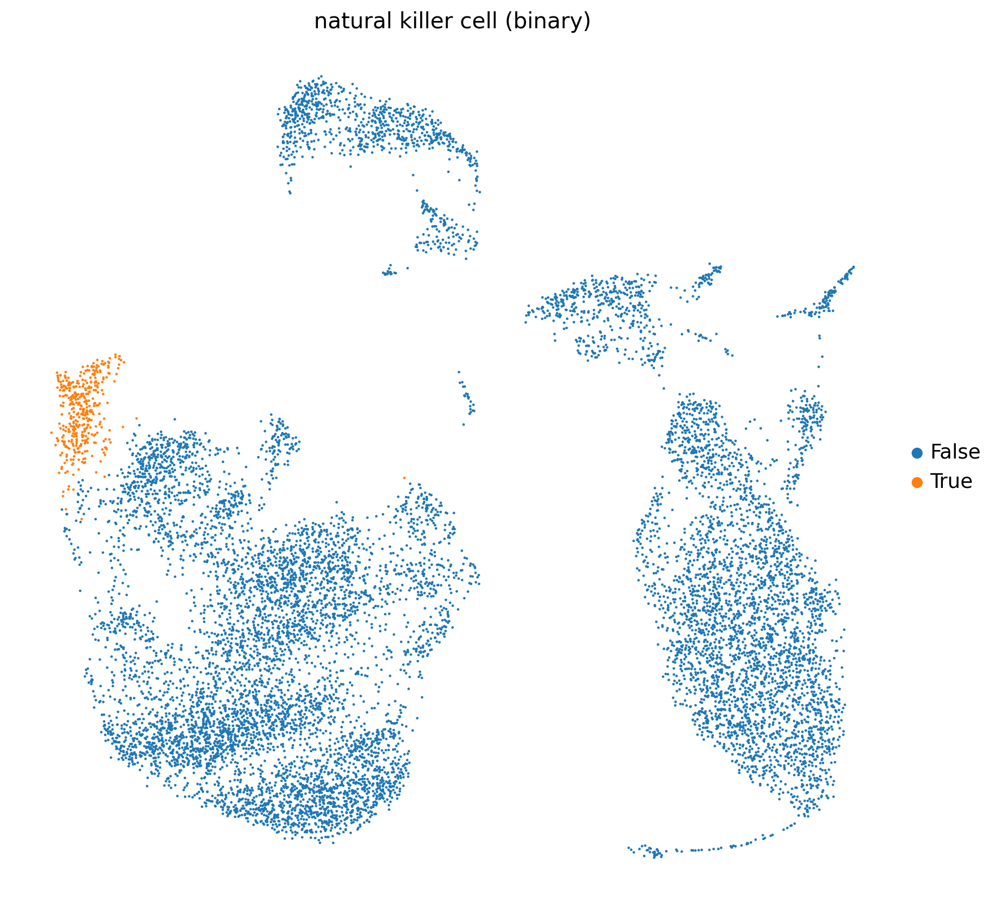

In [ ]:
with mpl.rc_context({'figure.figsize': (10, 10)}):
    sc.pl.umap(new_adata, color='natural killer cell (binary)', vmin=0.0, vmax=1.0, return_fig=True)

## Additionally, we can visualize cell type probabilities assigned to a specific cluster overlaid on the Cell Ontology graph:

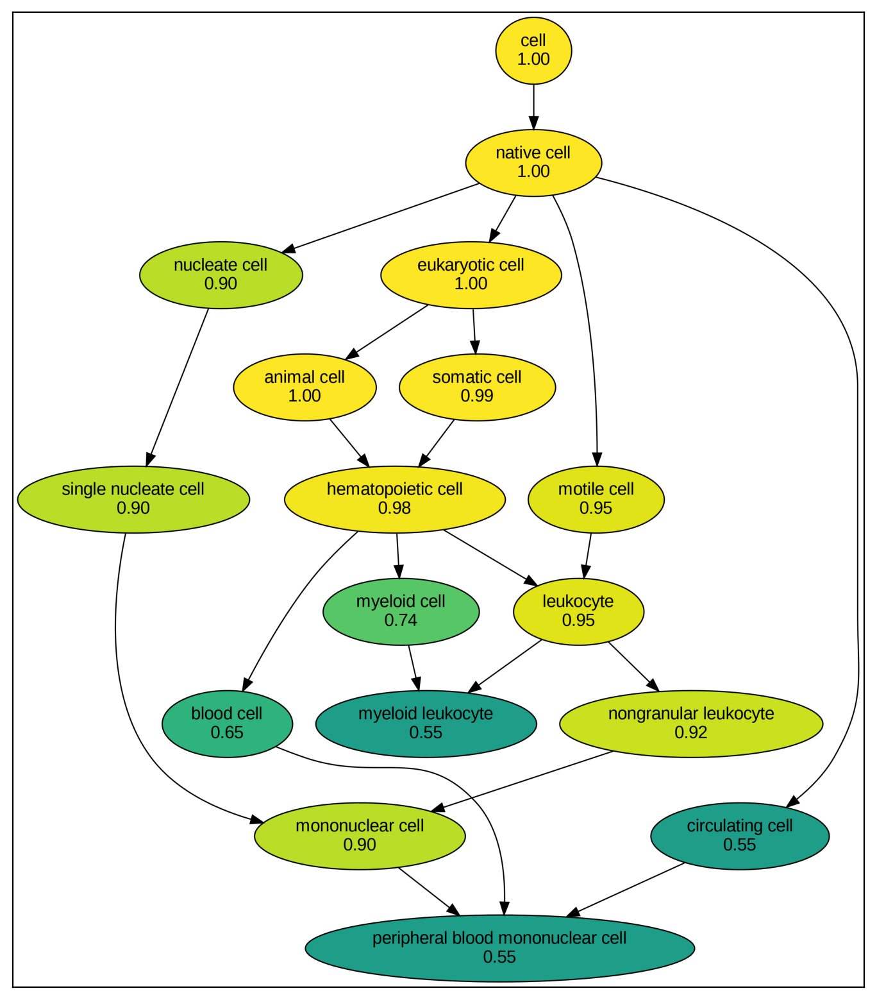

In [ ]:
fig, ax = cello.cello_probs(new_adata, '11', cello_resource_loc, 0.5, clust_key='leiden');

In [ ]:
#adata # AnnData object with n_obs × n_vars = 11505 × 1654
'''
    var: 'gene_ids', 'feature_types', 'genome', 'n_cells', 'mt', 'n_cells_by_counts', 'mean_counts', 'pct_dropout_by_counts', 'total_counts', 'highly_variable', 'means', 'dispersions', 'dispersions_norm', 'mean', 'std'
    uns: 'hvg', 'leiden', 'leiden_colors', 'log1p', 'neighbors', 'pca', 'rank_genes_groups', 'top125_eqtl_0_colors', 'umap'
    obsm: 'X_pca', 'X_umap'
    varm: 'PCs'
    obsp: 'connectivities', 'distances'
'''

"\n    var: 'gene_ids', 'feature_types', 'genome', 'n_cells', 'mt', 'n_cells_by_counts', 'mean_counts', 'pct_dropout_by_counts', 'total_counts', 'highly_variable', 'means', 'dispersions', 'dispersions_norm', 'mean', 'std'\n    uns: 'hvg', 'leiden', 'leiden_colors', 'log1p', 'neighbors', 'pca', 'rank_genes_groups', 'top125_eqtl_0_colors', 'umap'\n    obsm: 'X_pca', 'X_umap'\n    varm: 'PCs'\n    obsp: 'connectivities', 'distances'\n"

In [ ]:
#aadata # AnnData object with n_obs × n_vars = 11505 × 8738
'''
    var: 'gene_ids', 'feature_types', 'genome', 'n_cells', 'mt', 'n_cells_by_counts', 'mean_counts', 'pct_dropout_by_counts', 'total_counts', 'highly_variable', 'means', 'dispersions', 'dispersions_norm'
    uns: 'hvg', 'leiden', 'leiden_colors', 'log1p', 'neighbors', 'pca', 'rank_genes_groups', 'top125_eqtl_0_colors', 'umap'
    obsm: 'X_pca', 'X_umap'
    obsp: 'connectivities', 'distances'
'''

"\n    var: 'gene_ids', 'feature_types', 'genome', 'n_cells', 'mt', 'n_cells_by_counts', 'mean_counts', 'pct_dropout_by_counts', 'total_counts', 'highly_variable', 'means', 'dispersions', 'dispersions_norm'\n    uns: 'hvg', 'leiden', 'leiden_colors', 'log1p', 'neighbors', 'pca', 'rank_genes_groups', 'top125_eqtl_0_colors', 'umap'\n    obsm: 'X_pca', 'X_umap'\n    obsp: 'connectivities', 'distances'\n"

In [ ]:
#new_adata # AnnData object with n_obs × n_vars = 11505 × 8738
'''
    var: 'gene_ids', 'feature_types', 'genome', 'n_cells', 'mt', 'n_cells_by_counts', 'mean_counts', 'pct_dropout_by_counts', 'total_counts', 'highly_variable', 'means', 'dispersions', 'dispersions_norm'
    uns: 'hvg', 'leiden', 'leiden_colors', 'log1p', 'neighbors', 'pca', 'rank_genes_groups', 'top125_eqtl_0_colors', 'umap', 'CellO_column_mappings', 'Most specific cell type_colors', 'natural killer cell (binary)_colors'
    obsm: 'X_pca', 'X_umap'
    varm: 'PCs'
    obsp: 'connectivities', 'distances'
'''

"\n    var: 'gene_ids', 'feature_types', 'genome', 'n_cells', 'mt', 'n_cells_by_counts', 'mean_counts', 'pct_dropout_by_counts', 'total_counts', 'highly_variable', 'means', 'dispersions', 'dispersions_norm'\n    uns: 'hvg', 'leiden', 'leiden_colors', 'log1p', 'neighbors', 'pca', 'rank_genes_groups', 'top125_eqtl_0_colors', 'umap', 'CellO_column_mappings', 'Most specific cell type_colors', 'natural killer cell (binary)_colors'\n    obsm: 'X_pca', 'X_umap'\n    varm: 'PCs'\n    obsp: 'connectivities', 'distances'\n"

/usr/local/lib/python3.10/dist-packages/scanpy/plotting/_tools/scatterplots.py:392: UserWarning: No data for colormapping provided via 'c'. Parameters 'cmap' will be ignored
  cax = scatter(
/usr/local/lib/python3.10/dist-packages/scanpy/plotting/_tools/scatterplots.py:392: UserWarning: No data for colormapping provided via 'c'. Parameters 'cmap' will be ignored
  cax = scatter(
/usr/local/lib/python3.10/dist-packages/scanpy/plotting/_tools/scatterplots.py:392: UserWarning: No data for colormapping provided via 'c'. Parameters 'cmap' will be ignored
  cax = scatter(
/usr/local/lib/python3.10/dist-packages/scanpy/plotting/_tools/scatterplots.py:392: UserWarning: No data for colormapping provided via 'c'. Parameters 'cmap' will be ignored
  cax = scatter(
/usr/local/lib/python3.10/dist-packages/scanpy/plotting/_tools/scatterplots.py:392: UserWarning: No data for colormapping provided via 'c'. Parameters 'cmap' will be ignored
  cax = scatter(
/usr/local/lib/python3.10/dist-packages/scanp

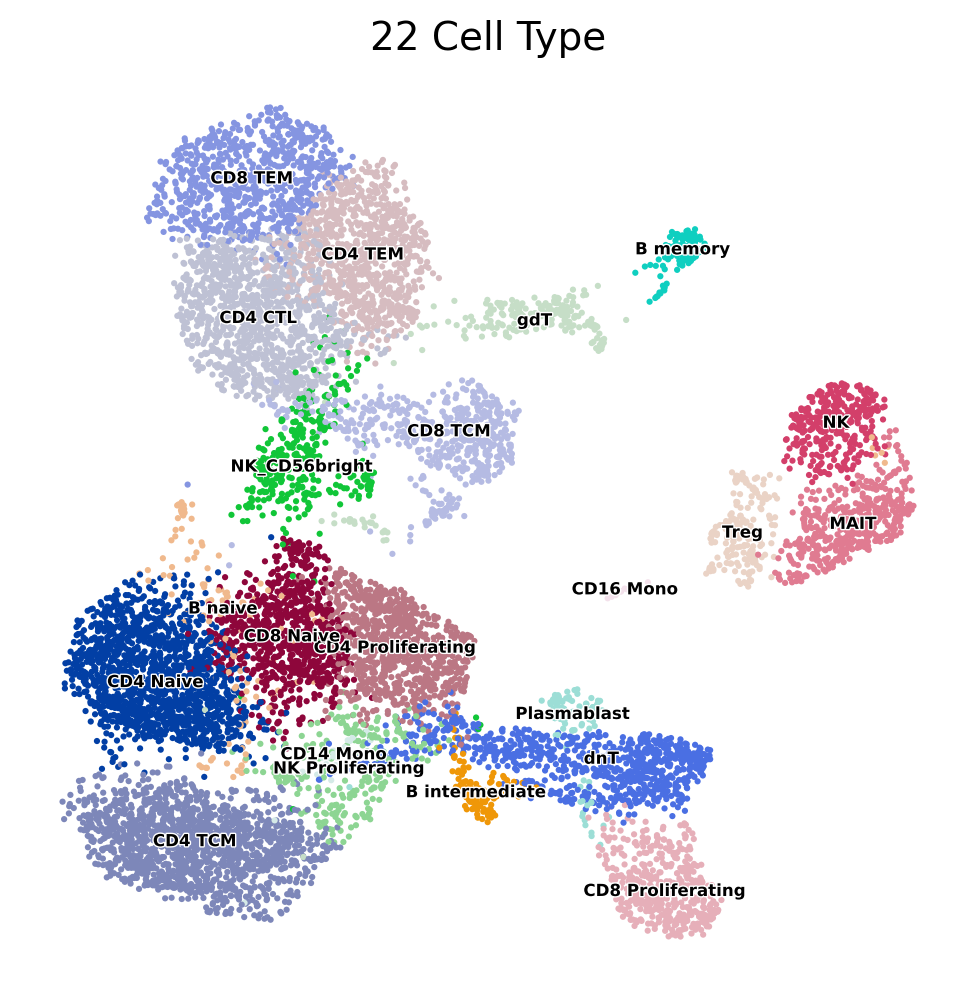

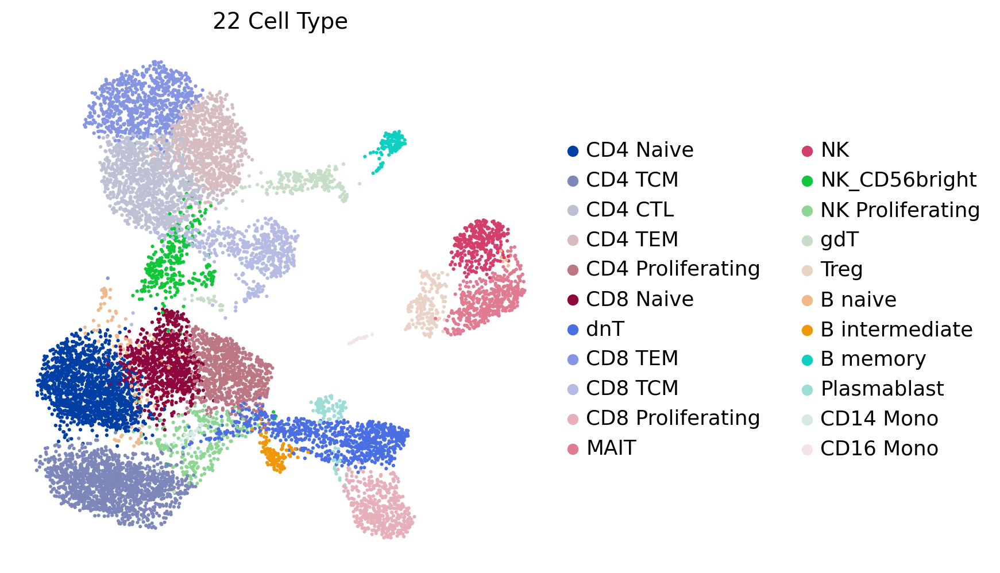

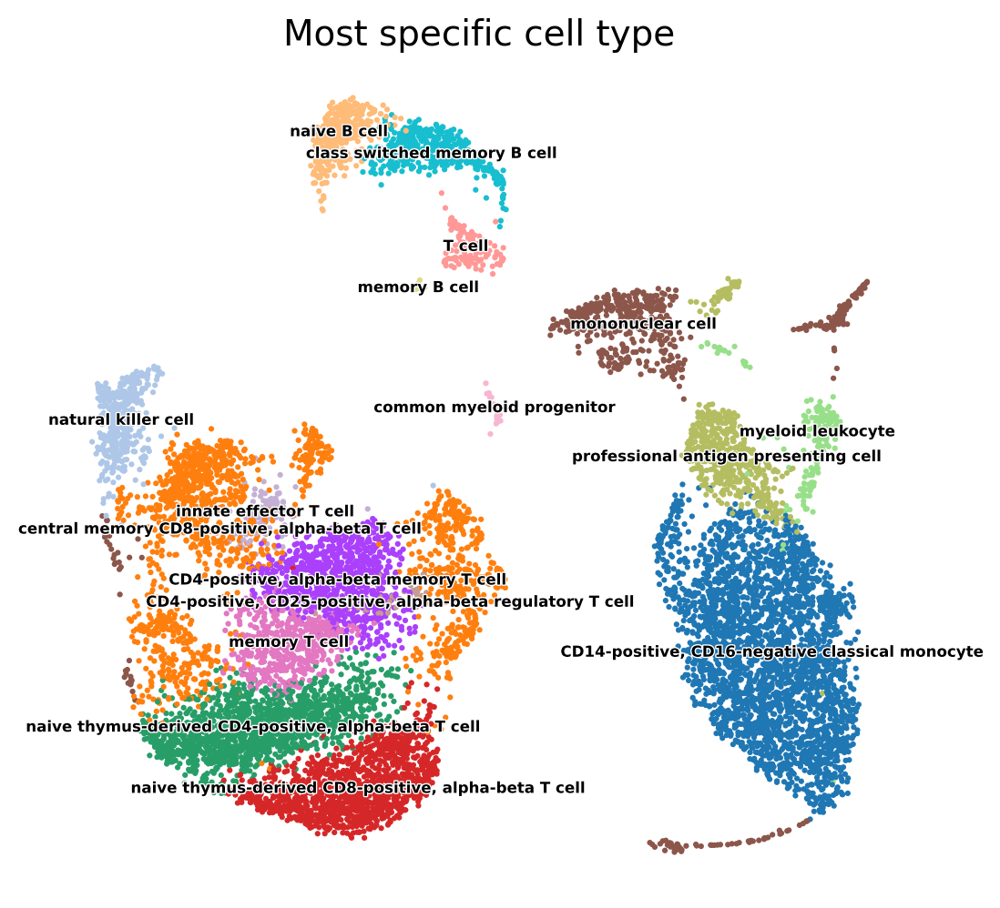

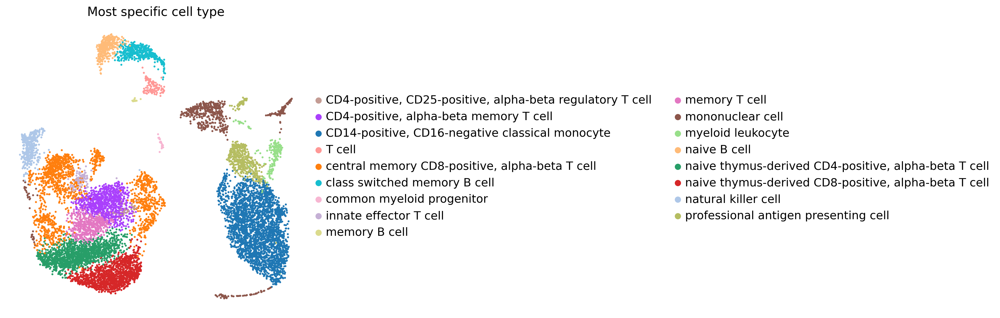

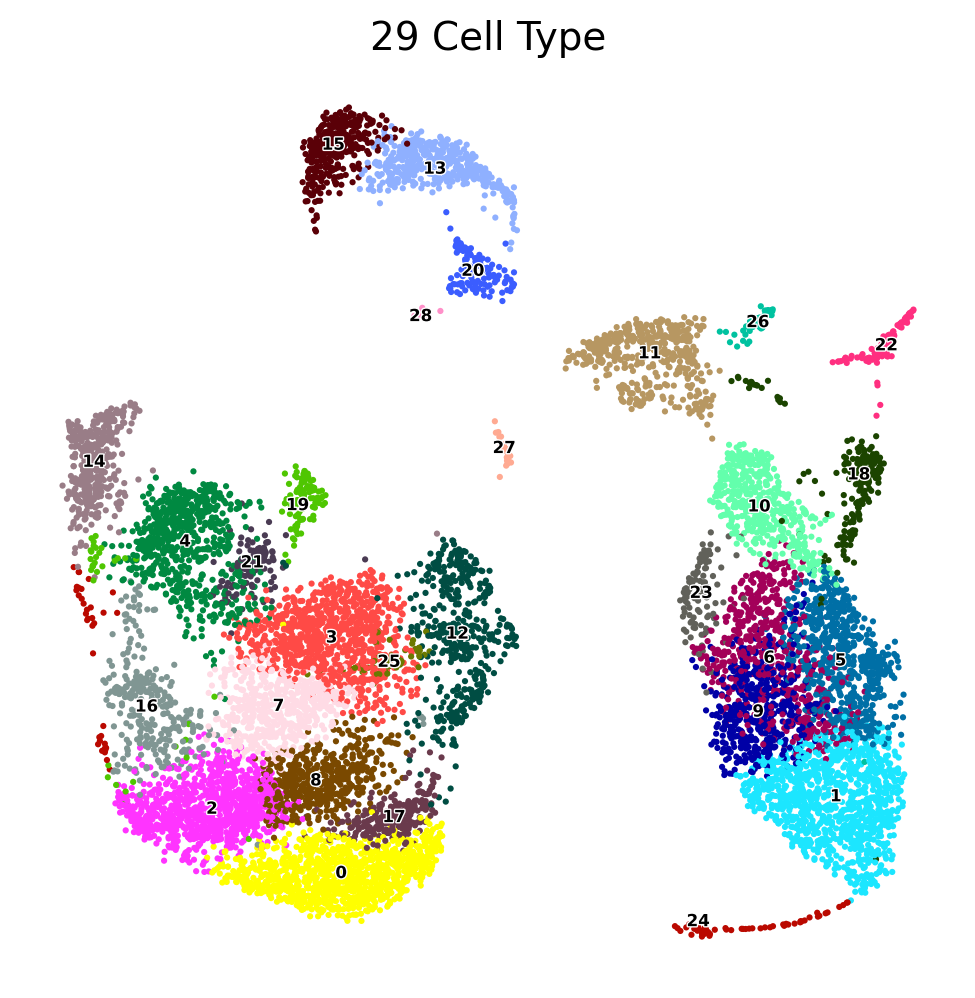

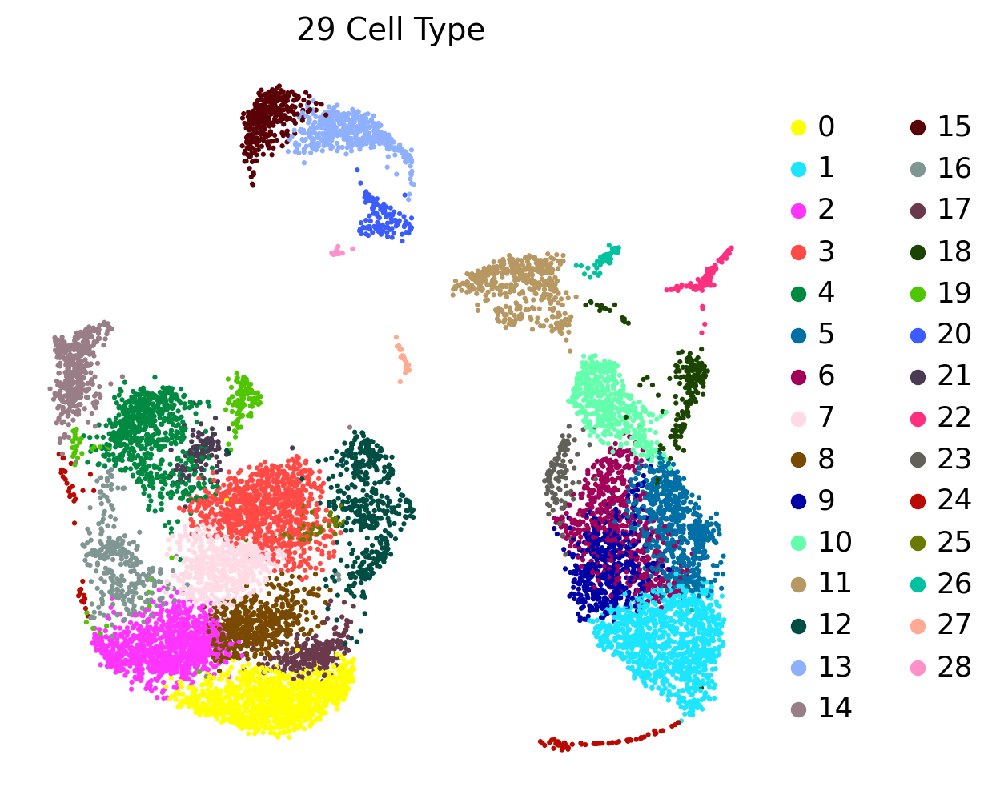

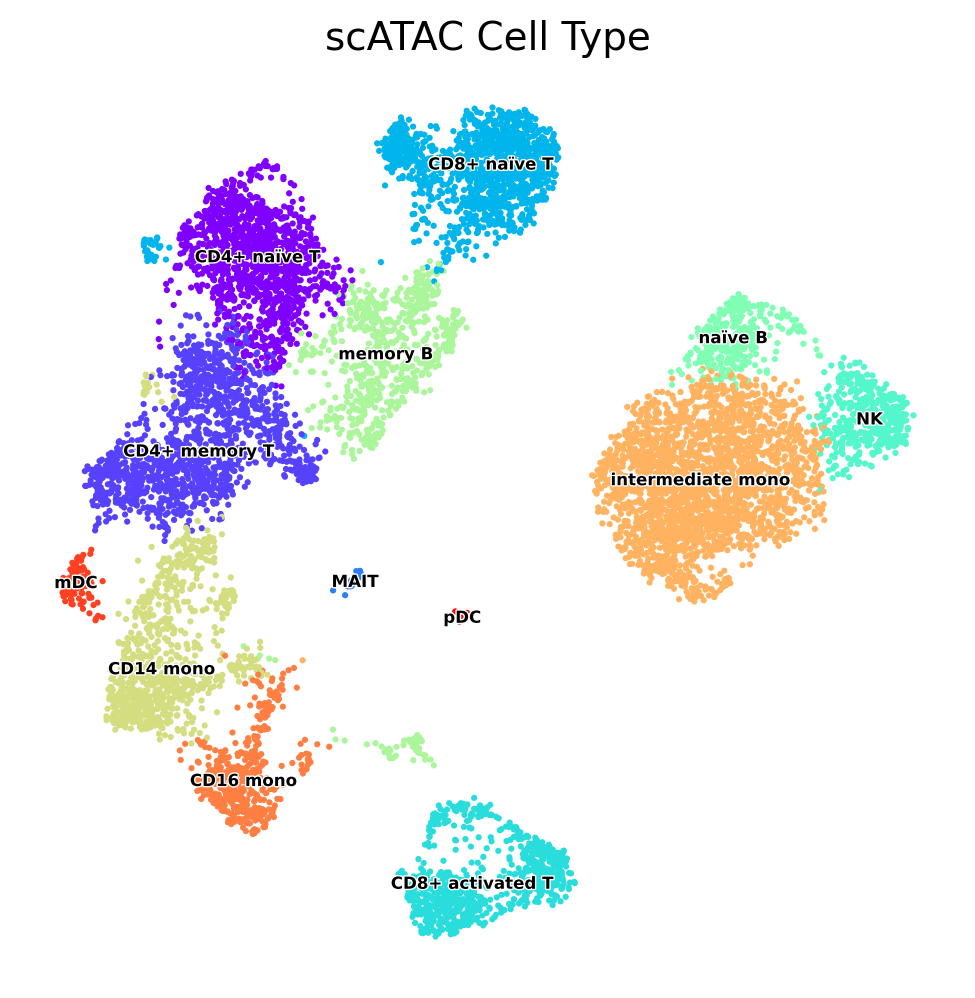

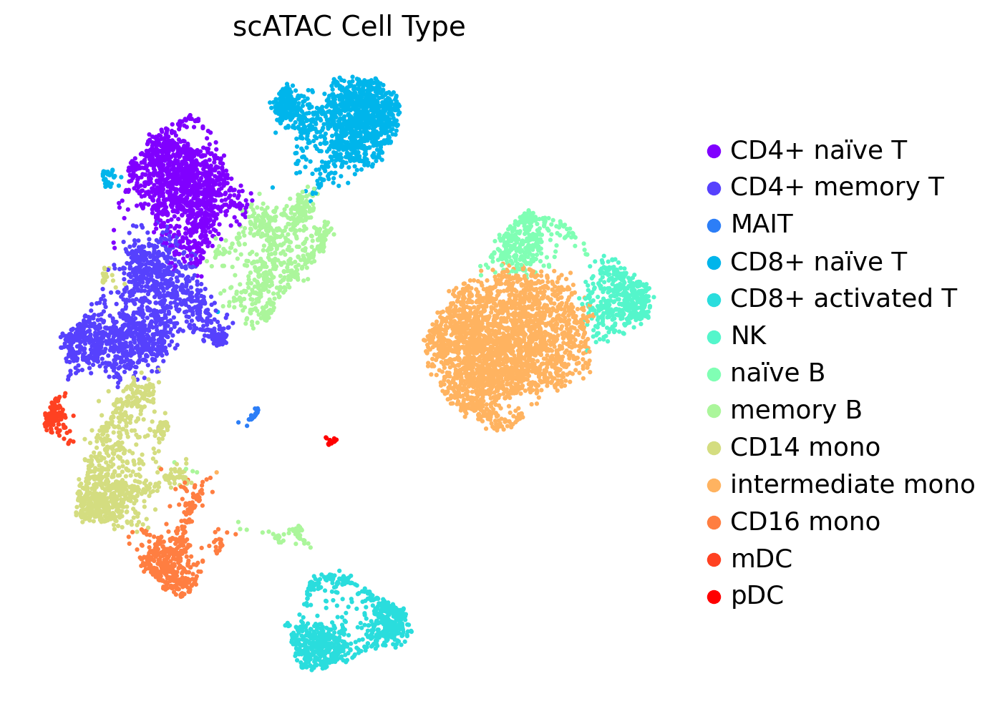

In [ ]:

sc.pl.umap(ad_rna, color='celltype', legend_loc='on data',
           legend_fontsize=6, legend_fontoutline=1, title='22 Cell Type', size=20, frameon=False,
                palette={

                     0: n_colors_str[0],
                     1: n_colors_str[1],
                     2: n_colors_str[2],
                     3: n_colors_str[3],
                     4: n_colors_str[4],
                     5: n_colors_str[5],
                     'CD14-positive, CD16-negative classical monocyte' : '#1f77b4',
                     'central memory CD8-positive, alpha-beta T cell' : '#ff7f0e',
                     'naive thymus-derived CD4-positive, alpha-beta T cell' : '#279e68',
                     'naive thymus-derived CD8-positive, alpha-beta T cell' : '#d62728',
                     'CD4-positive, alpha-beta memory T cell' : '#aa40fc',
                     'mononuclear cell' : '#8c564b',
                     'memory T cell' : '#e377c2',
                     'professional antigen presenting cell' : '#b5bd61',
                     'class switched memory B cell' : '#17becf',
                     'natural killer cell' : '#aec7e8',
                     'naive B cell' : '#ffbb78',
                     'myeloid leukocyte' : '#98df8a',
                     'T cell' : '#ff9896',
                     'innate effector T cell' : '#c5b0d5',
                     'CD4-positive, CD25-positive, alpha-beta regulatory T cell' : '#c49c94',
                     'common myeloid progenitor' : '#f7b6d2',
                     'memory B cell' : '#dbdb8d',
                     'CD4 Naive' : '#023fa5',
                     'CD4 TCM' : '#7d87b9',
                     'CD4 CTL' : '#bec1d4',
                     'CD4 TEM' : '#d6bcc0',
                     'CD4 Proliferating' : '#bb7784',
                     'CD8 Naive' : '#8e063b',
                     'dnT' : '#4a6fe3',
                     'CD8 TEM' : '#8595e1',
                     'CD8 TCM' : '#b5bbe3',
                     'CD8 Proliferating' : '#e6afb9',
                     'MAIT' : '#e07b91',
                     'NK' : '#d33f6a',
                     'NK_CD56bright' : '#11c638',
                     'NK Proliferating' : '#8dd593',
                     'gdT' : '#c6dec7',
                     'Treg' : '#ead3c6',
                     'B naive' : '#f0b98d',
                     'B intermediate' : '#ef9708',
                     'B memory' : '#0fcfc0',
                     'Plasmablast' : '#9cded6',
                     'CD14 Mono' : '#d5eae7',
                     'CD16 Mono' : '#f3e1eb'

                }
           ) # save='CellType.pdf') # legend_fontsize="xx-small"
sc.pl.umap(ad_rna, color='celltype', title='22 Cell Type', size=20, frameon=False,) # save='Cell_Type.pdf')
sc.pl.umap(new_adata, color='Most specific cell type', legend_loc='on data', legend_fontsize=6, legend_fontoutline=1, title='Most specific cell type',
           size=20, frameon=False,
                           palette={

                     0: n_colors_str[0],
                     1: n_colors_str[1],
                     2: n_colors_str[2],
                     3: n_colors_str[3],
                     4: n_colors_str[4],
                     5: n_colors_str[5],
                     'CD14-positive, CD16-negative classical monocyte' : '#1f77b4',
                     'central memory CD8-positive, alpha-beta T cell' : '#ff7f0e',
                     'naive thymus-derived CD4-positive, alpha-beta T cell' : '#279e68',
                     'naive thymus-derived CD8-positive, alpha-beta T cell' : '#d62728',
                     'CD4-positive, alpha-beta memory T cell' : '#aa40fc',
                     'mononuclear cell' : '#8c564b',
                     'memory T cell' : '#e377c2',
                     'professional antigen presenting cell' : '#b5bd61',
                     'class switched memory B cell' : '#17becf',
                     'natural killer cell' : '#aec7e8',
                     'naive B cell' : '#ffbb78',
                     'myeloid leukocyte' : '#98df8a',
                     'T cell' : '#ff9896',
                     'innate effector T cell' : '#c5b0d5',
                     'CD4-positive, CD25-positive, alpha-beta regulatory T cell' : '#c49c94',
                     'common myeloid progenitor' : '#f7b6d2',
                     'memory B cell' : '#dbdb8d',
                     'CD4 Naive' : '#023fa5',
                     'CD4 TCM' : '#7d87b9',
                     'CD4 CTL' : '#bec1d4',
                     'CD4 TEM' : '#d6bcc0',
                     'CD4 Proliferating' : '#bb7784',
                     'CD8 Naive' : '#8e063b',
                     'dnT' : '#4a6fe3',
                     'CD8 TEM' : '#8595e1',
                     'CD8 TCM' : '#b5bbe3',
                     'CD8 Proliferating' : '#e6afb9',
                     'MAIT' : '#e07b91',
                     'NK' : '#d33f6a',
                     'NK_CD56bright' : '#11c638',
                     'NK Proliferating' : '#8dd593',
                     'gdT' : '#c6dec7',
                     'Treg' : '#ead3c6',
                     'B naive' : '#f0b98d',
                     'B intermediate' : '#ef9708',
                     'B memory' : '#0fcfc0',
                     'Plasmablast' : '#9cded6',
                     'CD14 Mono' : '#d5eae7',
                     'CD16 Mono' : '#f3e1eb'

                }
           ) # save='CellType.pdf') # legend_fontsize="xx-small" #'Most specific cell type'
sc.pl.umap(new_adata, color='Most specific cell type', title='Most specific cell type', size=20, frameon=False,) # save='Cell_Type.pdf') # 'Most specific cell type'
sc.pl.umap(new_adata, color='leiden', legend_loc='on data', legend_fontsize=6, legend_fontoutline=1, title='29 Cell Type', size=20, frameon=False,) # save='CellType.pdf') # legend_fontsize="xx-small" #'Most specific cell type'
sc.pl.umap(new_adata, color='leiden', title='29 Cell Type', size=20, frameon=False,) # save='Cell_Type.pdf') # 'Most specific cell type'

sc.pl.umap(atac, color='celltype', legend_loc='on data', legend_fontsize=6, legend_fontoutline=1, title='scATAC Cell Type', size=20, frameon=False,) # save='CellType.pdf') # legend_fontsize="xx-small"
sc.pl.umap(atac, color='celltype', title='scATAC Cell Type', size=20, frameon=False,) # save='Cell_Type.pdf')


/usr/local/lib/python3.10/dist-packages/scanpy/plotting/_tools/scatterplots.py:392: UserWarning: No data for colormapping provided via 'c'. Parameters 'cmap' will be ignored
  cax = scatter(
/usr/local/lib/python3.10/dist-packages/scanpy/plotting/_tools/scatterplots.py:392: UserWarning: No data for colormapping provided via 'c'. Parameters 'cmap' will be ignored
  cax = scatter(
/usr/local/lib/python3.10/dist-packages/scanpy/plotting/_tools/scatterplots.py:392: UserWarning: No data for colormapping provided via 'c'. Parameters 'cmap' will be ignored
  cax = scatter(
/usr/local/lib/python3.10/dist-packages/scanpy/plotting/_tools/scatterplots.py:392: UserWarning: No data for colormapping provided via 'c'. Parameters 'cmap' will be ignored
  cax = scatter(
/usr/local/lib/python3.10/dist-packages/scanpy/plotting/_tools/scatterplots.py:392: UserWarning: No data for colormapping provided via 'c'. Parameters 'cmap' will be ignored
  cax = scatter(
/usr/local/lib/python3.10/dist-packages/scanp

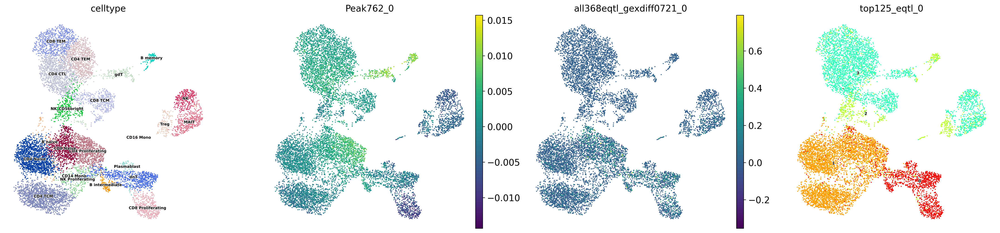

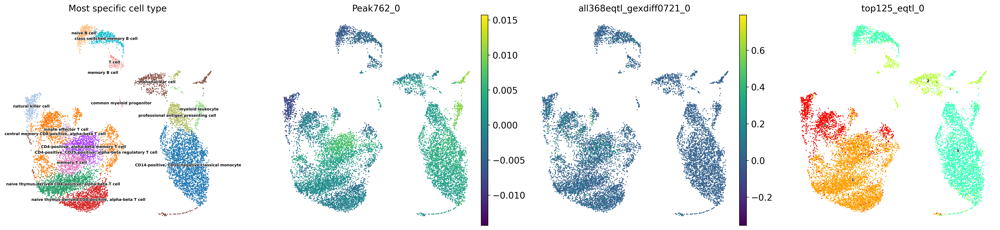

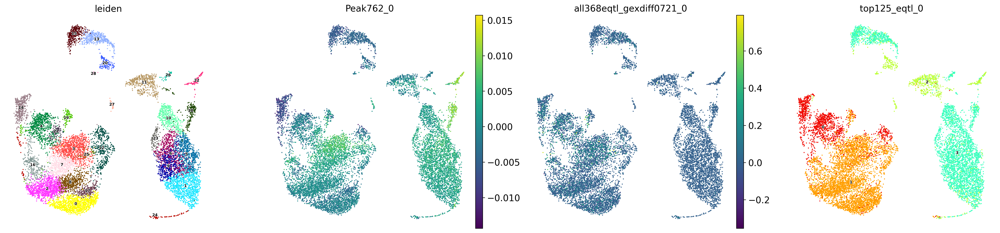

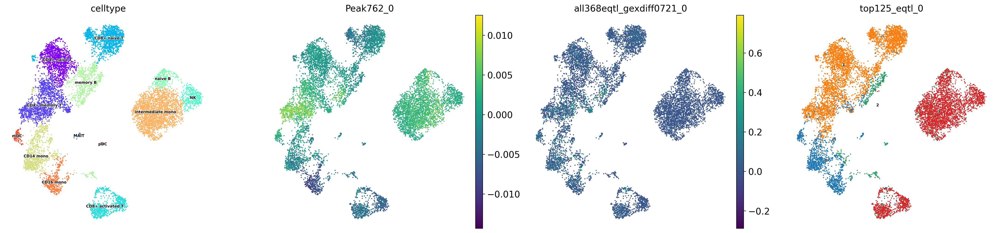

In [ ]:

sc.pl.umap(ad_rna, color = ['celltype','Peak762_0','all368eqtl_gexdiff0721_0','top125_eqtl_0'], legend_loc='on data', legend_fontsize=6, legend_fontoutline=1,)
sc.pl.umap(new_adata, color = ['Most specific cell type','Peak762_0','all368eqtl_gexdiff0721_0','top125_eqtl_0'], legend_loc='on data', legend_fontsize=6, legend_fontoutline=1,)
sc.pl.umap(new_adata, color = ['leiden','Peak762_0','all368eqtl_gexdiff0721_0','top125_eqtl_0'], legend_loc='on data', legend_fontsize=6, legend_fontoutline=1,)

sc.pl.umap(atac, color= ['celltype','Peak762_0','all368eqtl_gexdiff0721_0','top125_eqtl_0'], legend_loc='on data', legend_fontsize=6, legend_fontoutline=1,)# title='scATAC Cell Type', size=20, frameon=False,) # save='CellType.pdf') # legend_fontsize="xx-small"
#sc.pl.umap(atac, color= ['celltype','all368eqtl_gexdiff0721_0','top125_eqtl_0'], title='scATAC Cell Type', size=20, frameon=False,) # save='Cell_Type.pdf')


In [ ]:
new_adata.obs['Most specific cell type']

AAACAGCCAAGGAATC-1       central memory CD8-positive, alpha-beta T cell
AAACAGCCAATCCCTT-1               CD4-positive, alpha-beta memory T cell
AAACAGCCAATGCGCT-1       central memory CD8-positive, alpha-beta T cell
AAACAGCCACACTAAT-1       central memory CD8-positive, alpha-beta T cell
AAACAGCCACCAACCG-1    naive thymus-derived CD8-positive, alpha-beta ...
                                            ...                        
TTTGTTGGTGTTAAAC-1       central memory CD8-positive, alpha-beta T cell
TTTGTTGGTTAGGATT-1                                  natural killer cell
TTTGTTGGTTGCAGTA-1               CD4-positive, alpha-beta memory T cell
TTTGTTGGTTGGTTAG-1                                        memory T cell
TTTGTTGGTTTGCAGA-1               CD4-positive, alpha-beta memory T cell
Name: Most specific cell type, Length: 11505, dtype: category
Categories (17, object): ['CD4-positive, CD25-positive, alpha-beta regul..., 'CD4-positive, alpha-beta memory T cell',
                          '

In [ ]:
#new_adata.uns['Most specific cell type_colors']

In [ ]:
new_adata.X = np.asarray(new_adata.X)
mdata.mod['cello']=new_adata
mdata = MuData(mdata.mod)
#mdata

/usr/local/lib/python3.10/dist-packages/mudata/_core/mudata.py:491: UserWarning: Cannot join columns with the same name because var_names are intersecting.
  warnings.warn(


In [ ]:
mdata.write('./write/pbmc10k.h5mu')

/usr/local/lib/python3.10/dist-packages/mudata/_core/mudata.py:491: UserWarning: Cannot join columns with the same name because var_names are intersecting.
  warnings.warn(


In [ ]:
'''

SyntaxError: ignored

## Plot all Top125 eQTL vs Gene expression vs Annotated Cell Type

In [ ]:
'''

In [ ]:
from google.colab import drive
drive.mount('/content/drive')

!pip install jedi

!pip install  scvi-colab
from scvi_colab import install
install()

!pip install muon

#!pip install pysam


In [ ]:
import os
#import h5py
#import scipy
#import seaborn as sns
import anndata
import numpy as np
import scanpy as sc
import pandas as pd
import muon as mu
from muon import MuData
# Import a module with ATAC-seq-related functions
from muon import atac as ac
#from sklearn.preprocessing import StandardScaler
#from sklearn.preprocessing import MinMaxScaler
import scvi; print(scvi.__version__)
import matplotlib.pyplot as plt
from matplotlib.pyplot import rc_context
sc.set_figure_params(dpi=100, figsize=(6, 6), frameon=False)
sc.settings.n_jobs=2
sc.settings.max_memory=5
sc.settings.autoshow=False
#sc.settings.ScanpyConfig(autoshow=False,max_memory=4)

In [ ]:
mdata = mu.read("/content/drive/MyDrive/pbmc10k.h5mu") # /content/drive/MyDrive/scEpieQTL/pbmc10k.h5mu #scRNA vs scATAC
mdata

In [ ]:
#ad_rna = mdata.mod['rna']
#new_adata = mdata.mod['cello']
#atac = mdata.mod['atac']

## 讀入Gene ID

In [ ]:
all762eqtl_ID=np.load('/content/drive/MyDrive/scEpieQTL/all762eqtl_ID.npy') #沒有附gene的eQTL
all762eqtl_geneID=np.load('/content/drive/MyDrive/scEpieQTL/786_peak_id_gene_name.npy') #有附gene的eQTL
eqtl368_geneID0719=np.load('/content/drive/MyDrive/scEpieQTL/all_368eqtlID_gane_name.npy') #0719找出的368個eQTL

In [ ]:
#計算標準差
all368eqtl_gexdiff = pd.DataFrame(np.load('/content/drive/MyDrive/scEpieQTL/基因表現差值的all_368eqtl_gexdiff0721.npy'))
all368eqtl_gexdiff_std = all368eqtl_gexdiff.T.describe().loc['std']

In [ ]:
dfsb=pd.read_pickle('/content/drive/MyDrive/scEpieQTL/whole_blood_eqtl_.scbasset.seqs_762.pandas.pickle')
sb1572_index=dfsb.index.to_numpy()

sb786_index = np.empty(len(sb1572_index)//2, dtype=sb1572_index.dtype)
for i in range(0,1572):
  k=i//2
  sb786_index[k]=sb1572_index[i]
  i+=1

Peak762_index = np.array([item.split('_', 1)[1] for item in sb786_index])

In [ ]:
data_frame = pd.read_csv('/content/drive/MyDrive/scEpieQTL/125_eqtl_cell_gmm_cluster_labels_0803.csv')

data_frame.drop('Unnamed: 0', axis=1, inplace=True)

# 将行和列交换，使用transpose()方法
data_frame_transposed = data_frame.transpose()

# 将DataFrame转换为NumPy数组
#data_array = data_frame_transposed.to_numpy()

top125_eqtl_ID=data_frame_transposed.index.to_numpy()

In [ ]:
n_clusters = 6
n_colors = plt.cm.jet(np.linspace(0.9,0.1,n_clusters))

import matplotlib.colors as mcolors
#mcolors.is_color_like(n_colors[4])
n_colors_str = [mcolors.to_hex(color) for color in n_colors]


In [ ]:
'''

In [ ]:
                  palettes={

                       0: n_colors_str[0],
                       1: n_colors_str[1],
                       2: n_colors_str[2],
                       3: n_colors_str[3],
                       4: n_colors_str[4],
                       5: n_colors_str[5],
                       'CD14-positive, CD16-negative classical monocyte' : '#1f77b4',
                       'central memory CD8-positive, alpha-beta T cell' : '#ff7f0e',
                       'naive thymus-derived CD4-positive, alpha-beta T cell' : '#279e68',
                       'naive thymus-derived CD8-positive, alpha-beta T cell' : '#d62728',
                       'CD4-positive, alpha-beta memory T cell' : '#aa40fc',
                       'mononuclear cell' : '#8c564b',
                       'memory T cell' : '#e377c2',
                       'professional antigen presenting cell' : '#b5bd61',
                       'class switched memory B cell' : '#17becf',
                       'natural killer cell' : '#aec7e8',
                       'naive B cell' : '#ffbb78',
                       'myeloid leukocyte' : '#98df8a',
                       'T cell' : '#ff9896',
                       'innate effector T cell' : '#c5b0d5',
                       'CD4-positive, CD25-positive, alpha-beta regulatory T cell' : '#c49c94',
                       'common myeloid progenitor' : '#f7b6d2',
                       'memory B cell' : '#dbdb8d',
                       'CD4 Naive' : '#023fa5',
                       'CD4 TCM' : '#7d87b9',
                       'CD4 CTL' : '#bec1d4',
                       'CD4 TEM' : '#d6bcc0',
                       'CD4 Proliferating' : '#bb7784',
                       'CD8 Naive' : '#8e063b',
                       'dnT' : '#4a6fe3',
                       'CD8 TEM' : '#8595e1',
                       'CD8 TCM' : '#b5bbe3',
                       'CD8 Proliferating' : '#e6afb9',
                       'MAIT' : '#e07b91',
                       'NK' : '#d33f6a',
                       'NK_CD56bright' : '#11c638',
                       'NK Proliferating' : '#8dd593',
                       'gdT' : '#c6dec7',
                       'Treg' : '#ead3c6',
                       'B naive' : '#f0b98d',
                       'B intermediate' : '#ef9708',
                       'B memory' : '#0fcfc0',
                       'Plasmablast' : '#9cded6',
                       'CD14 Mono' : '#d5eae7',
                       'CD16 Mono' : '#f3e1eb',

                       'intermediate mono'	:	 '#8000ff',
                       'CD4+ memory T'	:	 '#5641fd',
                       'CD8+ naïve T'	:	 '#2c7ef7',
                       'CD4+ naïve T'	:	 '#00b5eb',
                       'CD14 mono'	:	 '#2adddd',
                       'CD8+ activated T'	:	 '#54f6cb',
                       'memory B'	:	 '#80ffb4',
                       'CD16 mono'	:	 '#abf69b',
                       'NK'	:	 '#d4dd80',
                       'naïve B'	:	 '#ffb360',
                       'mDC'	:	 '#ff7e41',
                       'MAIT'	:	 '#ff4121',
                       'pDC'	:	 '#ff0000',

                  }

In [ ]:
def PlotPDF(file_name,start,end):
  import matplotlib
  matplotlib.use('agg')
  import matplotlib.pyplot as plt # matplotlib.use('agg')必须在本句执行前运行
  from matplotlib.backends.backend_pdf import PdfPages

  pdf_file = file_name  # PDF 檔案名稱

  # 建立一個 PDF 物件
  pdf_pages = PdfPages(pdf_file)

  for j in range(start,end): #
      for i in range(len(all762eqtl_ID)):       #range(len(all_762eqtl_ID))：起始值從0開始，所以會執行0到785(共786次)，但只會找出有在eqtl368_gene中的368個列印出來。
         if all762eqtl_ID[i] == top125_eqtl_ID[j]:
          for k in range(len(eqtl368_geneID0719)):
            if eqtl368_geneID0719[k] == all762eqtl_geneID[i]:
              fig = sc.pl.umap(
                  mdata.mod['rna'], #ad_rna, #adata
                  color=[f"top125_eqtl_{j:d}",f"Peak762_{i:d}",f"all368eqtl_gexdiff0721_{k:d}",'celltype'], # 'leiden'
                  title=[all762eqtl_geneID[i],Peak762_index[i],eqtl368_geneID0719[k],'scRNA Cell Type'],#'Cell Type"
                  frameon=False,
                  return_fig=True,
                  colorbar_loc = 'right',
                  color_map= 'RdBu_r',  #'jet',
                  vmin = -3*all368eqtl_gexdiff_std[k],
                  vmax = 3*all368eqtl_gexdiff_std[k],
                  vcenter = 0,
                  legend_loc='on data',legend_fontsize=6, legend_fontoutline=1,
                  #palette = n_colors_str, #'jet' #cm.jet(np.linspace(0.1,0.9,5))
                  palette=palettes,


              )

              fig1 = sc.pl.umap(
                  mdata.mod['cello'], #new_adata, #adata
                  color=[f"top125_eqtl_{j:d}",f"Peak762_{i:d}",f"all368eqtl_gexdiff0721_{k:d}",'Most specific cell type'], # 'leiden'
                  title=[all762eqtl_geneID[i],Peak762_index[i],eqtl368_geneID0719[k],'CellO Cell Type'],#'Cell Type"
                  frameon=False,
                  return_fig=True,
                  colorbar_loc = 'right',
                  color_map= 'RdBu_r',  #'jet',
                  vmin = -3*all368eqtl_gexdiff_std[k],
                  vmax = 3*all368eqtl_gexdiff_std[k],
                  vcenter = 0,
                  legend_loc='on data',legend_fontsize=6, legend_fontoutline=1,
                  #palette = n_colors_str, #'jet' #cm.jet(np.linspace(0.1,0.9,5))
                  palette=palettes,


              )

              fig2 = sc.pl.umap(
                  mdata.mod['atac'],#atac,
                  color=[f"top125_eqtl_{j:d}",f"Peak762_{i:d}",f"all368eqtl_gexdiff0721_{k:d}",'celltype',], # 'leiden'
                  title=[all762eqtl_geneID[i],Peak762_index[i],eqtl368_geneID0719[k],'scATAC Cell Type',],#'Cell Type"
                  frameon=False,
                  return_fig=True,
                  colorbar_loc = 'right',
                  color_map= 'RdBu_r',  #'jet',
                  vmin = -3*all368eqtl_gexdiff_std[k],
                  vmax = 3*all368eqtl_gexdiff_std[k],
                  vcenter = 0,
                  legend_loc='on data',legend_fontsize=6, legend_fontoutline=1,
                  #palette = n_colors_str, #'jet' #cm.jet(np.linspace(0.1,0.9,5))
                  palette=palettes,

              ) # save='CellType.pdf') # legend_fontsize="xx-small"

              pdf_pages.savefig(fig, bbox_inches="tight")
              pdf_pages.savefig(fig1, bbox_inches="tight")
              pdf_pages.savefig(fig2, bbox_inches="tight")
  # 關閉 PDF 物件
  pdf_pages.close()

In [ ]:
PlotPDF('Top125_eqtl_0809RNA-ATAC-CellO-1.pdf',0,25)

In [ ]:
PlotPDF('Top125_eqtl_0809RNA-ATAC-CellO-2.pdf',25,50)

In [ ]:
PlotPDF('Top125_eqtl_0809RNA-ATAC-CellO-3.pdf',50,75)

In [ ]:
PlotPDF('Top125_eqtl_0809RNA-ATAC-CellO-4.pdf',75,100)

In [ ]:
PlotPDF('Top125_eqtl_0809RNA-ATAC-CellO-5.pdf',100,125)

In [ ]:
#執行gs來合併或壓縮pdf檔

In [ ]:
!apt-get install ghostscript

In [ ]:
import shutil
gs_path = shutil.which('gs')

In [ ]:
import os
import subprocess

def merge_pdfs(folder_path, output_file):
    pdf_files = [file for file in os.listdir(folder_path) if file.endswith('.pdf')]
    pdf_files.sort()  # 确保文件按名称排序

    # 构建Ghostscript命令
    gs_command = [gs_path, '-dBATCH', '-dNOPAUSE', '-q', '-sDEVICE=pdfwrite', '-sOutputFile=' + output_file]

    # 添加所有PDF文件到命令
    for pdf_file in pdf_files:
        gs_command.append(os.path.join(folder_path, pdf_file))

    # 调用Ghostscript执行PDF合并
    subprocess.run(gs_command)

# 设置文件夹路径和输出文件名
folder_path = '/content'  # 替换为实际的文件夹路径
output_file = '/content/output_rna.pdf'  # 替换为实际的输出文件路径和名称

# 调用函数进行PDF合并
merge_pdfs(folder_path, output_file)
